In [357]:
suppressPackageStartupMessages(library(dplyr))
suppressPackageStartupMessages(library(tidyr))
suppressPackageStartupMessages(library(tibble))
suppressPackageStartupMessages(library(ggplot2))
suppressPackageStartupMessages(library(stringr))
library(parallel)
library(reshape2)
library(ggsci)
library(rstatix)
library(ggpubr)
source('/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/Figure_Notebooks/Intermediate_files/Composite_score/helper_function_IHA.r')


In [2]:
quiet_library <- function(...) { suppressPackageStartupMessages(library(...)) }
quiet_library(hise)    # HISE functions
quiet_library(dplyr)   # DataFrame manipulation
quiet_library(purrr)   # Functional programming tools
quiet_library(ggplot2) # Plotting

## Helper functions

In [3]:
cache_uuid_path <- function(uuid) {
    if(!dir.exists(paste0("cache/", uuid))) {
        hise_res <- cacheFiles(list(uuid))
    }
    
    cache_path <- paste0("cache/",uuid)
    cache_file <- list.files(cache_path, full.names = TRUE)
    
    cache_file
}

In [4]:
stored_file_df <- function(store_name) {
    ps_files <- listFilesInProjectStores(list(store_name))
    ps_files <- map(
        ps_files$files, 
        function(l) {
            l <- l[c("id", "name")]
            as.data.frame(l)
        }) %>%
      list_rbind()
    
    ps_files
}

# CLR Transform


In [5]:
clr_transform <- function(x) {
  if (length(x) == 0) {
    return(NA)  # return NA for empty vectors
  }
  geom_mean <- exp(mean(log(x)))
  return(log(x / geom_mean))
}

# Identify files for use in HISE

In [6]:
search_id <- "fumur-jufir-vuzag"

Retrieve the list of files stored in our HISE project store

In [7]:
ps_files <- stored_file_df("cohorts")

Filter for files from the previous notebook using our search_id and the .tar extension

In [8]:
freq_files <- ps_files %>%
  filter(grepl(search_id, name))

In [9]:
freq_files

id,name
<chr>,<chr>
b04e3ccd-e437-41ae-97fe-63a0c0a24995,fumur-jufir-vuzag/diha_AIFI_L1_frequencies_2024-05-05.csv
6c82ee51-1898-4699-b382-59e619a05b82,fumur-jufir-vuzag/diha_AIFI_L2_frequencies_2024-05-05.csv
577902fe-094d-499e-86a1-e5fe67131fb1,fumur-jufir-vuzag/diha_AIFI_L3_frequencies_2024-05-05.csv


# Download files from HISE

In [10]:
file_paths <- map(freq_files$id, cache_uuid_path)
file_paths

[[1]]
[1] "cache/b04e3ccd-e437-41ae-97fe-63a0c0a24995/diha_AIFI_L1_frequencies_2024-05-05.csv"

[[2]]
[1] "cache/6c82ee51-1898-4699-b382-59e619a05b82/diha_AIFI_L2_frequencies_2024-05-05.csv"

[[3]]
[1] "cache/577902fe-094d-499e-86a1-e5fe67131fb1/diha_AIFI_L3_frequencies_2024-05-05.csv"

# Load HISE data

In [11]:
freq_data <- map(file_paths, read.csv)
names(freq_data) <- sub(".+diha_(.+)_freq.+", "\\1", file_paths)

Now we have a list of frequency data at each level:

In [12]:
l1 <- freq_data[["AIFI_L1"]]
head(l1)
nrow(l1)

,cohort.cohortGuid,subject.subjectGuid,subject.biologicalSex,subject.cmv,subject.bmi,subject.race,subject.ethnicity,subject.birthYear,subject.ageAtFirstDraw,sample.sampleKitGuid,⋯,specimen.specimenGuid,AIFI_L1,AIFI_L1_count,total_cells,scrna.lymphocyte_count,bc.lymphocyte_count,alc_ratio,AIFI_L1_frac_total,AIFI_L1_alc,AIFI_L1_clr
,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<int>,<int>,<chr>,⋯,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>
1,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,PB00001-01,B cell,1781,18231,13903,1337,0.0961663,0.0976907465,171.2721715,2.0880254
2,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,PB00001-01,DC,246,18231,13903,1337,0.0961663,0.0134935001,23.6569086,0.1084267
3,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,PB00001-01,Erythrocyte,15,18231,13903,1337,0.0961663,0.0008227744,1.4424944,-2.6888546
4,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,PB00001-01,ILC,8,18231,13903,1337,0.0961663,0.0004388130,0.7693304,-3.3174633
5,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,PB00001-01,Monocyte,4004,18231,13903,1337,0.0961663,0.2196259119,385.0498454,2.8981443
6,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,PB00001-01,NK cell,1202,18231,13903,1337,0.0961663,0.0659316549,115.5918866,1.6948373


[1] 7683

In [13]:
l2 <- freq_data[["AIFI_L2"]]
head(l2)
nrow(l2)

,cohort.cohortGuid,subject.subjectGuid,subject.biologicalSex,subject.cmv,subject.bmi,subject.race,subject.ethnicity,subject.birthYear,subject.ageAtFirstDraw,sample.sampleKitGuid,⋯,AIFI_L1,AIFI_L2,AIFI_L2_count,total_cells,scrna.lymphocyte_count,bc.lymphocyte_count,alc_ratio,AIFI_L2_frac_total,AIFI_L2_alc,AIFI_L2_clr
,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<int>,<int>,<chr>,⋯,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>
1,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,B cell,Effector B cell,97,18231,13903,1337,0.0961663,0.0053206078,9.3281306,-0.410271740
2,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,B cell,Memory B cell,381,18231,13903,1337,0.0961663,0.0208984696,36.6393584,0.957816657
3,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,B cell,Naive B cell,1140,18231,13903,1337,0.0961663,0.0625308540,109.6295764,2.053800823
4,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,B cell,Plasma cell,18,18231,13903,1337,0.0961663,0.0009873293,1.7309933,-2.094610961
5,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,B cell,Transitional B cell,145,18231,13903,1337,0.0961663,0.0079534858,13.9441128,-0.008248976
6,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,DC,ASDC,7,18231,13903,1337,0.0961663,0.0003839614,0.6731641,-3.039072570


[1] 24892

In [397]:
l3 <- freq_data[["AIFI_L3"]]
head(l3)
nrow(l3)
dim(l3)

,cohort.cohortGuid,subject.subjectGuid,subject.biologicalSex,subject.cmv,subject.bmi,subject.race,subject.ethnicity,subject.birthYear,subject.ageAtFirstDraw,sample.sampleKitGuid,⋯,AIFI_L2,AIFI_L3,AIFI_L3_count,total_cells,scrna.lymphocyte_count,bc.lymphocyte_count,alc_ratio,AIFI_L3_frac_total,AIFI_L3_alc,AIFI_L3_clr
,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<int>,<int>,<chr>,⋯,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>
1,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Effector B cell,CD27+ effector B cell,71,18231,13903,1337,0.0961663,0.0038944655,6.8278069,0.3324226
2,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Effector B cell,CD27- effector B cell,26,18231,13903,1337,0.0961663,0.0014261423,2.5003237,-0.6721608
3,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Memory B cell,Activated memory B cell,3,18231,13903,1337,0.0961663,0.0001645549,0.2884989,-2.8316450
4,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Memory B cell,CD95 memory B cell,15,18231,13903,1337,0.0961663,0.0008227744,1.4424944,-1.2222071
5,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Memory B cell,Core memory B cell,329,18231,13903,1337,0.0961663,0.0180461851,31.6387111,1.8658004
6,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Memory B cell,Early memory B cell,10,18231,13903,1337,0.0961663,0.0005485163,0.9616630,-1.6276722


[1] 58816

[1] 58816    25

# Read Mean Expression Data

In [15]:
meta_data=read.csv("/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/scRNA_meta_data-2024-05-09.csv")

In [16]:
colnames(meta_data)

[1] "X"                                        
 [2] "Unnamed..0"                               
 [3] "lastUpdated"                              
 [4] "sample.id"                                
 [5] "sample.bridgingControl"                   
 [6] "sample.sampleKitGuid"                     
 [7] "sample.visitName"                         
 [8] "sample.visitDetails"                      
 [9] "sample.drawDate"                          
[10] "sample.daysSinceFirstVisit"               
[11] "file.id"                                  
[12] "file.name"                                
[13] "file.batchID"                             
[14] "file.panel"                               
[15] "file.pool"                                
[16] "file.fileType"                            
[17] "file.majorVersion"                        
[18] "subject.id"                               
[19] "subject.biologicalSex"                    
[20] "subject.birthYear"                        
[21] "subject.ethnicity"                        
[22] "subject.partnerCode"                      
[23] "subject.race"                             
[24] "subject.subjectGuid"                      
[25] "cohort.cohortGuid"                        
[26] "sample.diseaseStatesRecordedAtVisit"      
[27] "pbmc_sample_id"                           
[28] "subject.covidVaxDose1.daysSinceFirstVisit"
[29] "subject.covidVaxDose2.daysSinceFirstVisit"
[30] "Covid_exclusion"                          
[31] "subjectGuid"                              
[32] "CMV"

In [17]:
meta_data$Ages<-as.numeric(substr(meta_data$sample.drawDate,1,4))-meta_data$subject.birthYear

# Read Deseq2 Result - Female

In [18]:
meta_data_subset <- meta_data %>% 
  filter(Covid_exclusion == 'no', !sample.visitName	%in% c('Flu Year 1 Day 7','Flu Year 2 Day 7'), subject.biologicalSex == "Female")


In [19]:
file_list<-paste0("/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/scRNA/BRI/Average_LogNormalized_Expression/Average_LogNormalized_Expression_of_Celltypes_by_Sample_AIFI_L3/", meta_data_subset$pbmc_sample_id, ".csv")

In [20]:
df_list<-read_pesudobulk_expression(file_list, mc_cores = 60) #. reating pseudobulk object

[1] "Total reading time: 28.243 seconds"


In [21]:
unique(meta_data_subset$sample.visitName)
unique(meta_data_subset$subject.biologicalSex)

[1] "Flu Year 1 Day 0"        "Flu Year 1 Day 90"      
 [3] "Immune Variation Day 0"  "Immune Variation Day 7" 
 [5] "Immune Variation Day 90" "Flu Year 2 Stand-Alone" 
 [7] "Flu Year 1 Stand-Alone"  "Flu Year 2 Day 0"       
 [9] "Flu Year 2 Day 90"       "Flu Year 3 Stand-Alone"

[1] "Female"

In [22]:
deseq2_result_Y1D0<-read.csv('/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/DESEQ2/Female_Deseq2_Result_Y1D0.csv')

In [23]:
head(deseq2_result_Y1D0)

,X,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj,contrast,Direction,gene,celltype,sex
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
1,1,1.4553376,-1.58887408,0.3911621,-4.0619325,4.866815e-05,0.3688559,cohort.cohortGuid,BR1,CCDC174,ASDC,Female
2,2,0.3984625,0.41653866,0.5699233,0.7308679,4.648598e-01,0.9968973,cohort.cohortGuid,BR2,AL669831.5,ASDC,Female
3,3,1.6559504,0.25216783,0.3641720,0.6924415,4.886601e-01,0.9968973,cohort.cohortGuid,BR2,NOC2L,ASDC,Female
4,4,1.2866563,-0.97078515,0.5119361,-1.8963013,5.792021e-02,0.9968973,cohort.cohortGuid,BR1,ISG15,ASDC,Female
5,5,2.7154615,-0.05010603,0.2936791,-0.1706149,8.645266e-01,0.9968973,cohort.cohortGuid,BR1,SDF4,ASDC,Female
6,6,1.1378577,-0.29946048,0.4050389,-0.7393377,4.597020e-01,0.9968973,cohort.cohortGuid,BR1,B3GALT6,ASDC,Female


In [24]:
genes_of_interest <- c('G0S2', 'NR4A1', 'PTGS2', 'BCL2A1', 'METRNL' ,'RASGEF1B', 'NLRP3', 'RIPK2', 'RABL6', 'CMTM6', 'SGK1', 'SELENOK', 'MIDN', 'OAZ1')
length(genes_of_interest)

[1] 14

In [25]:
# filter significant genes 
# deseq2_result_Y1D0_AgeGroup_sig<-deseq2_result_Y1D0 %>% 
#   filter(contrast == "cohort.cohortGuid") %>%
#   filter(padj < 0.1, 
#          abs(log2FoldChange) > 0.1)

deseq2_result_Y1D0_AgeGroup_sig<-deseq2_result_Y1D0 %>% 
  filter(contrast == "cohort.cohortGuid") %>%
  filter(gene %in% genes_of_interest )

In [26]:
head(deseq2_result_Y1D0_AgeGroup_sig)

,X,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj,contrast,Direction,gene,celltype,sex
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
1,731,0.4279732,-0.93997276,0.5798415,-1.6210856,0.1049993,0.9968973,cohort.cohortGuid,BR1,NLRP3,ASDC,Female
2,1277,7.2630180,-0.08889577,0.1755723,-0.5063199,0.6126321,0.9968973,cohort.cohortGuid,BR1,CMTM6,ASDC,Female
3,1388,4.6694354,0.24623565,0.2057725,1.1966403,0.2314468,0.9968973,cohort.cohortGuid,BR2,SELENOK,ASDC,Female
4,1762,0.5558365,0.45810530,0.5648261,0.8110555,0.4173338,0.9968973,cohort.cohortGuid,BR2,RASGEF1B,ASDC,Female
5,3321,0.7786333,0.10087677,0.4759584,0.2119445,0.8321503,0.9968973,cohort.cohortGuid,BR2,RIPK2,ASDC,Female
6,3684,2.6920903,-0.19441886,0.2650419,-0.7335401,0.4632291,0.9968973,cohort.cohortGuid,BR1,RABL6,ASDC,Female


## Filter Genes and CellTypes

In [27]:
df_degs_counts<-as.data.frame(table(deseq2_result_Y1D0_AgeGroup_sig$celltype,deseq2_result_Y1D0_AgeGroup_sig$Direction))
head(df_degs_counts)

,Var1,Var2,Freq
,<fct>,<fct>,<int>
1,Activated memory B cell,BR1,2
2,Adaptive NK cell,BR1,2
3,ASDC,BR1,4
4,BaEoMaP cell,BR1,5
5,C1Q+ CD16 monocyte,BR1,4
6,CD14+ cDC2,BR1,6


In [28]:
celltypes <- c("IL1B+ CD14 monocyte", "Core CD14 monocyte", "ISG+ CD14 monocyte")

In [29]:
df_degs_counts_filtered<-df_degs_counts %>% arrange(Var1)  %>% filter(Var1 %in% celltypes)

In [30]:
df_degs_counts_filtered

Var1,Var2,Freq
<fct>,<fct>,<int>
Core CD14 monocyte,BR1,3
Core CD14 monocyte,BR2,7
IL1B+ CD14 monocyte,BR1,0
IL1B+ CD14 monocyte,BR2,14
ISG+ CD14 monocyte,BR1,1
ISG+ CD14 monocyte,BR2,9


## Construct Composite Score

In [61]:
score_df_list<-mclapply(unique(df_degs_counts_filtered$Var1),function(celltype_single){

top_n=100
Direction_of_DEG="BR2"
selected_genes <- deseq2_result_Y1D0_AgeGroup_sig %>%
    filter(celltype == celltype_single,Direction==Direction_of_DEG) %>% 
    arrange(padj,desc(abs(log2FoldChange))) %>% 
    slice_head(n=top_n)%>%
    select(gene) %>%
    pull()
 
long_format <- filter_genes_and_celltype(df_list, 
                                       selected_genes, 
                                       celltype_single, 
                                       longformat = TRUE)
long_format <- left_join(long_format, meta_data)
# z scored (optional)
long_format<-long_format %>% group_by(Gene) %>% 
mutate(Z_score_Mean_Expression=scale(Mean_Expression))  %>% 
                                        ungroup()
composite_score_df<-long_format%>% 
group_by(pbmc_sample_id) %>%
  dplyr::summarise(composite_score_sum_mean = sum(Mean_Expression),
                   composite_score_sum_scaled_mean = sum(Z_score_Mean_Expression)) %>% as.data.frame() 
composite_score_df<-left_join(composite_score_df,meta_data) 
composite_score_df$celltype<-celltype_single
return(composite_score_df)
},mc.cores=10)

In [62]:
composite_score_df_all<-do.call(rbind,score_df_list)

In [63]:
composite_score_df_all<-composite_score_df_all %>% mutate(AgeGroup=case_when(cohort.cohortGuid=="BR1"~"Young", TRUE~'Older'))

In [34]:
# head(composite_score_df_all)
# dim(composite_score_df_all)

### Stat_test and legend max scaling- Sum_Mean

In [35]:
STAT_res<-composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0")%>%
  select(composite_score_sum_mean,AgeGroup, celltype, composite_score_sum_scaled_mean ) %>%
  group_by(celltype) %>% 
  wilcox_test(composite_score_sum_mean ~ AgeGroup) %>%
  adjust_pvalue(method='BH') %>%
  add_significance() 
head(STAT_res)

celltype,.y.,group1,group2,n1,n2,statistic,p,p.adj,p.adj.signif
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>
Core CD14 monocyte,composite_score_sum_mean,Older,Young,25,26,454,1.46e-02,2.190e-02,*
IL1B+ CD14 monocyte,composite_score_sum_mean,Older,Young,25,26,556,4.06e-06,1.218e-05,****
ISG+ CD14 monocyte,composite_score_sum_mean,Older,Young,25,26,441,2.87e-02,2.870e-02,*


In [36]:
STAT_res$p.adj <- formatC(STAT_res$p.adj, format = "e", digits = 2)

In [37]:
max_y<-composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0")%>%
  select(composite_score_sum_mean,AgeGroup, celltype) %>%
  group_by(celltype) %>%
  dplyr::summarize(max_composite_score_sum_mean = max(composite_score_sum_mean)) %>%
  ungroup()%>%select(max_composite_score_sum_mean) %>% pull()

In [38]:
STAT_res$max_y<-max_y*1.05

Warning message in max(lengths(data)):
“no non-missing arguments to max; returning -Inf”
`geom_smooth()` using formula = 'y ~ x'


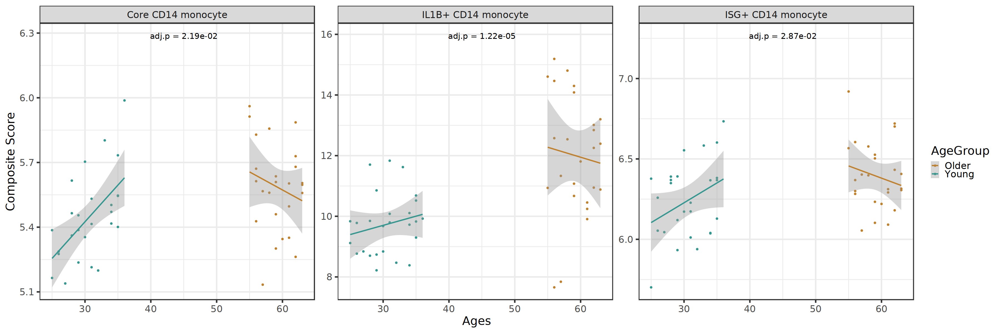

In [39]:
options(repr.plot.width = 30, repr.plot.height = 10)

p <- ggplot(composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0"),
       aes(Ages, composite_score_sum_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype,ncol=4,scale = 'free')+
  expand_limits() 

# Manually add p-value annotations
p <- p + geom_text(data = STAT_res,
                   aes(x = 45, y = max_y, label = paste("adj.p =", p.adj)),
                   size = 6,
                   inherit.aes = FALSE)

p



`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.
`geom_smooth()` using formula = 'y ~ x'


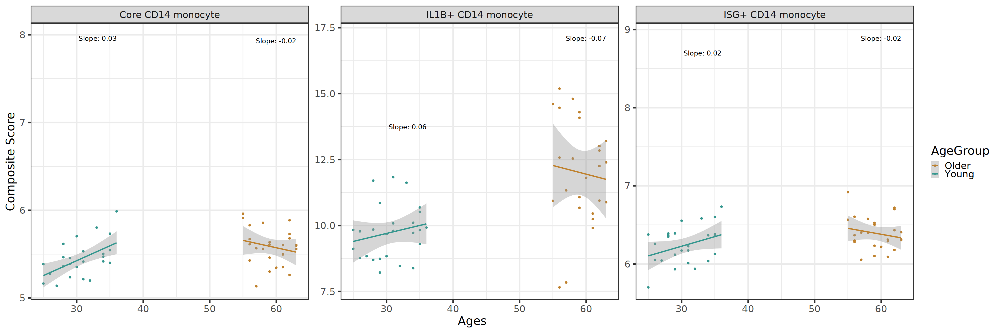

In [40]:

options(repr.plot.width = 30, repr.plot.height = 10)


p <- ggplot(composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0"),
       aes(Ages, composite_score_sum_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype, scale = 'free')

slopes <- composite_score_df_all %>%
  filter(sample.visitName == "Flu Year 1 Day 0") %>%
  group_by(celltype, AgeGroup) %>%
  do(model = lm(composite_score_sum_mean ~ Ages, data = .)) %>%
  summarize(celltype = first(celltype),
            AgeGroup = first(AgeGroup),
            slope = coef(model)[["Ages"]],
            intercept = coef(model)[["(Intercept)"]])

max_values <- composite_score_df_all %>%
  filter(sample.visitName == "Flu Year 1 Day 0") %>%
  group_by(celltype, AgeGroup) %>%
  summarize(max_x = max(Ages), max_y = max(composite_score_sum_mean)+2)

annotations <- slopes %>%
  inner_join(max_values, by = c("celltype", "AgeGroup")) %>%
  mutate(label = paste("Slope:", round(slope, 2)))

p + geom_text(data = annotations, aes(x = max_x, y = max_y, label = label), 
              hjust = 1, vjust = 1, size = 5, color = "black", inherit.aes = FALSE)

`geom_smooth()` using formula = 'y ~ x'


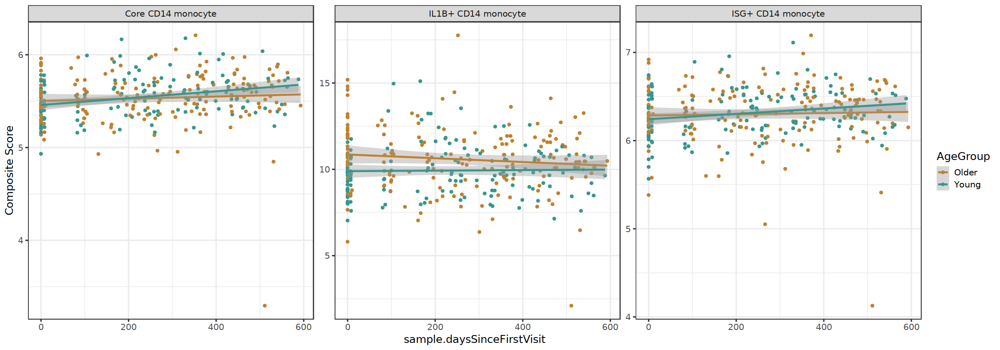

In [41]:
options(repr.plot.width = 20, repr.plot.height = 7)

ggplot(composite_score_df_all %>% filter(sample.daysSinceFirstVisit<600), 
       aes(sample.daysSinceFirstVisit, composite_score_sum_mean,color=AgeGroup)) +
  geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')


In [42]:
donor_id<-sample(unique(composite_score_df_all$subjectGuid),20)

`geom_smooth()` using formula = 'y ~ x'


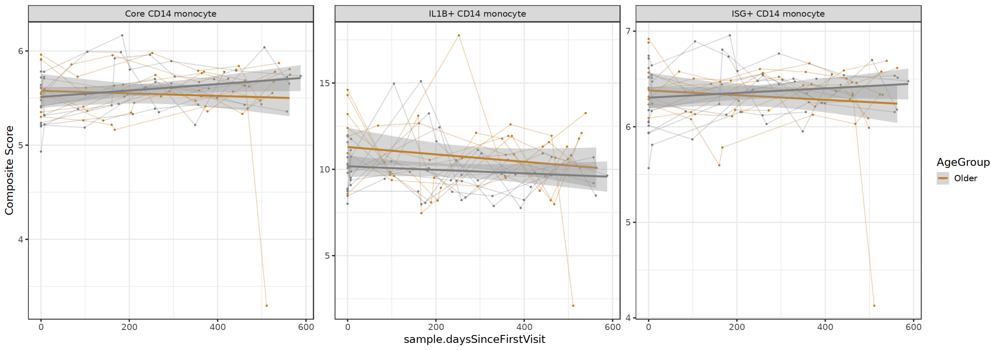

In [43]:
options(repr.plot.width = 20, repr.plot.height = 7)
composite_score_df_all$AgeGroup<-factor(composite_score_df_all$AgeGroup,levels=c("Younger",'Older'))
ggplot(composite_score_df_all %>% filter(sample.daysSinceFirstVisit<600,subjectGuid%in% donor_id), 
       aes(sample.daysSinceFirstVisit, composite_score_sum_mean,color=AgeGroup)) +
  geom_line(aes(group=subjectGuid),linetype = 1,alpha=0.3)+
  geom_point(size=0.5)+ylab('Composite Score')+   scale_color_manual(values = c("Older"='#bf812d',  "Younger"='#35978f'))+
  geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,ncol=3,scale='free')
  

### Stat_test and legend max scaling- Sum_scaled_Mean

In [64]:
STAT_res<-composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0")%>%
  select(composite_score_sum_mean,AgeGroup, celltype, composite_score_sum_scaled_mean ) %>%
  group_by(celltype) %>% 
  wilcox_test(composite_score_sum_scaled_mean ~ AgeGroup) %>%
  adjust_pvalue(method='BH') %>%
  add_significance() 
head(STAT_res)

celltype,.y.,group1,group2,n1,n2,statistic,p,p.adj,p.adj.signif
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>
Core CD14 monocyte,composite_score_sum_scaled_mean,Older,Young,25,26,420,7.48e-02,7.480e-02,ns
IL1B+ CD14 monocyte,composite_score_sum_scaled_mean,Older,Young,25,26,555,4.55e-06,1.365e-05,****
ISG+ CD14 monocyte,composite_score_sum_scaled_mean,Older,Young,25,26,420,7.48e-02,7.480e-02,ns


In [65]:
STAT_res$p.adj <- formatC(STAT_res$p.adj, format = "e", digits = 2)

In [66]:
max_y<-composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0")%>%
  select(composite_score_sum_scaled_mean,AgeGroup, celltype) %>%
  group_by(celltype) %>%
  dplyr::summarize(max_composite_score_sum_scaled_mean = max(composite_score_sum_scaled_mean)) %>%
  ungroup()%>%select(max_composite_score_sum_scaled_mean) %>% pull()

In [67]:
STAT_res$max_y<-max_y*1.05

Warning message in max(lengths(data)):
“no non-missing arguments to max; returning -Inf”
`geom_smooth()` using formula = 'y ~ x'


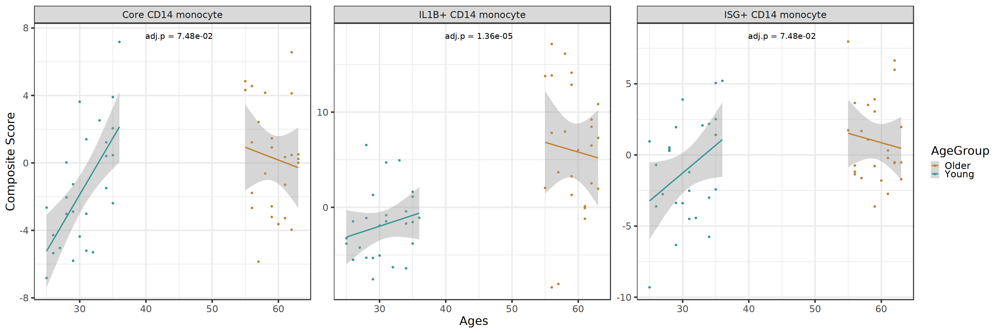

In [68]:
options(repr.plot.width = 30, repr.plot.height = 10)

p <- ggplot(composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0"),
       aes(Ages, composite_score_sum_scaled_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype,ncol=4,scale = 'free')+
  expand_limits() 

# Manually add p-value annotations
p <- p + geom_text(data = STAT_res,
                   aes(x = 45, y = max_y, label = paste("adj.p =", p.adj)),
                   size = 6,
                   inherit.aes = FALSE)

p



`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.
`geom_smooth()` using formula = 'y ~ x'


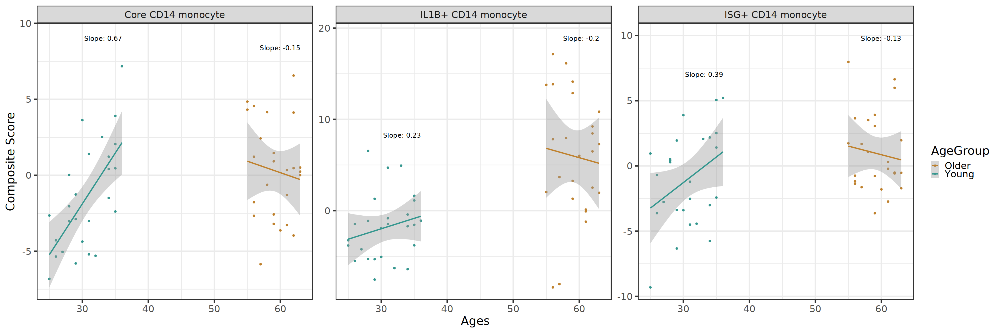

In [69]:


options(repr.plot.width = 30, repr.plot.height = 10)


p <- ggplot(composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0"),
       aes(Ages, composite_score_sum_scaled_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype, scale = 'free')

slopes <- composite_score_df_all %>%
  filter(sample.visitName == "Flu Year 1 Day 0") %>%
  group_by(celltype, AgeGroup) %>%
  do(model = lm(composite_score_sum_scaled_mean ~ Ages, data = .)) %>%
  summarize(celltype = first(celltype),
            AgeGroup = first(AgeGroup),
            slope = coef(model)[["Ages"]],
            intercept = coef(model)[["(Intercept)"]])

max_values <- composite_score_df_all %>%
  filter(sample.visitName == "Flu Year 1 Day 0") %>%
  group_by(celltype, AgeGroup) %>%
  summarize(max_x = max(Ages), max_y = max(composite_score_sum_scaled_mean)+2)

annotations <- slopes %>%
  inner_join(max_values, by = c("celltype", "AgeGroup")) %>%
  mutate(label = paste("Slope:", round(slope, 2)))

p + geom_text(data = annotations, aes(x = max_x, y = max_y, label = label), 
              hjust = 1, vjust = 1, size = 5, color = "black", inherit.aes = FALSE)

`geom_smooth()` using formula = 'y ~ x'


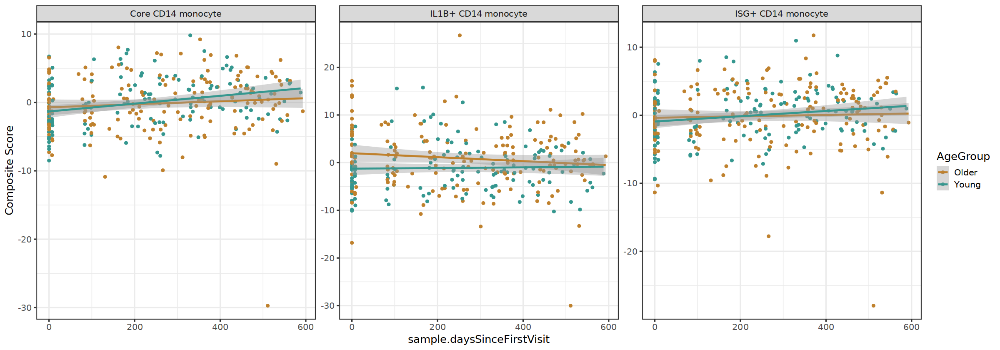

In [71]:
options(repr.plot.width = 20, repr.plot.height = 7)

ggplot(composite_score_df_all %>% filter(sample.daysSinceFirstVisit<600), 
       aes(sample.daysSinceFirstVisit, composite_score_sum_scaled_mean,color=AgeGroup)) +
  geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')


In [72]:
donor_id<-sample(unique(composite_score_df_all$subjectGuid),20)

`geom_smooth()` using formula = 'y ~ x'


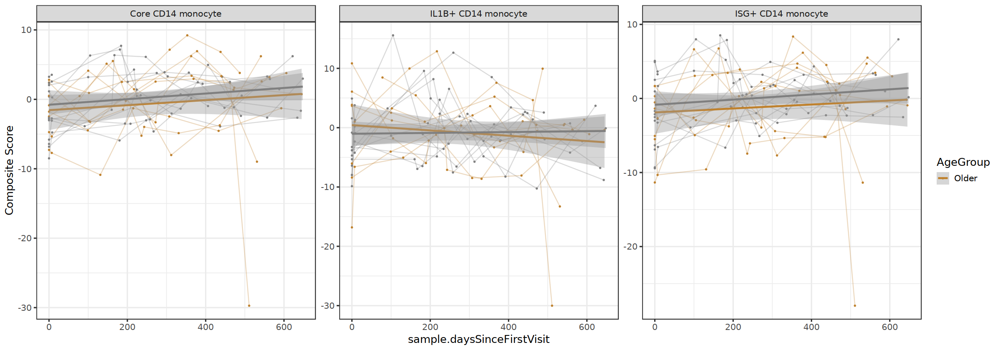

In [73]:
options(repr.plot.width = 20, repr.plot.height = 7)
composite_score_df_all$AgeGroup<-factor(composite_score_df_all$AgeGroup,levels=c("Younger",'Older'))
ggplot(composite_score_df_all %>% filter(sample.daysSinceFirstVisit<650,subjectGuid%in% donor_id), 
       aes(sample.daysSinceFirstVisit, composite_score_sum_scaled_mean,color=AgeGroup)) +
  geom_line(aes(group=subjectGuid),linetype = 1,alpha=0.3)+
  geom_point(size=0.5)+ylab('Composite Score')+   scale_color_manual(values = c("Older"='#bf812d',  "Younger"='#35978f'))+
  geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,ncol=3,scale='free')
  

# Read Deseq2 Result - Male

In [74]:
meta_data_subset <- meta_data %>% 
  filter(Covid_exclusion == 'no', !sample.visitName	%in% c('Flu Year 1 Day 7','Flu Year 2 Day 7'), subject.biologicalSex == "Male")


In [75]:
file_list<-paste0("/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/scRNA/BRI/Average_LogNormalized_Expression/Average_LogNormalized_Expression_of_Celltypes_by_Sample_AIFI_L3/", meta_data_subset$pbmc_sample_id, ".csv")

In [76]:
df_list<-read_pesudobulk_expression(file_list, mc_cores = 60) #. reating pseudobulk object

[1] "Total reading time: 19.34 seconds"


In [77]:
unique(meta_data_subset$sample.visitName)
unique(meta_data_subset$subject.biologicalSex)

[1] "Flu Year 1 Day 0"        "Flu Year 1 Day 90"      
 [3] "Immune Variation Day 0"  "Immune Variation Day 7" 
 [5] "Immune Variation Day 90" "Flu Year 2 Stand-Alone" 
 [7] "Flu Year 1 Stand-Alone"  "Flu Year 2 Day 0"       
 [9] "Flu Year 2 Day 90"       "Flu Year 3 Stand-Alone"

[1] "Male"

In [78]:
deseq2_result_Y1D0<-read.csv('/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/DESEQ2/Male_Deseq2_Result_Y1D0.csv')

In [79]:
genes_of_interest <- c('G0S2', 'NR4A1', 'PTGS2', 'BCL2A1', 'METRNL' ,'RASGEF1B', 'NLRP3', 'RIPK2', 'RABL6', 'CMTM6', 'SGK1', 'SELENOK', 'MIDN', 'OAZ1')
length(genes_of_interest)

[1] 14

In [80]:
# filter significant genes 
# deseq2_result_Y1D0_AgeGroup_sig<-deseq2_result_Y1D0 %>% 
#   filter(contrast == "cohort.cohortGuid") %>%
#   filter(padj < 0.1, 
#          abs(log2FoldChange) > 0.1)

deseq2_result_Y1D0_AgeGroup_sig<-deseq2_result_Y1D0 %>% 
  filter(contrast == "cohort.cohortGuid") %>%
  filter(gene %in% genes_of_interest )

In [81]:
head(deseq2_result_Y1D0_AgeGroup_sig)
unique(deseq2_result_Y1D0_AgeGroup_sig$sex)

,X,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj,contrast,Direction,gene,celltype,sex
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
1,768,0.3401664,0.28683588,0.6303897,0.4550136,0.6490994,0.9967281,cohort.cohortGuid,BR2,NLRP3,ASDC,Male
2,1342,7.6007241,0.02633244,0.1852038,0.1421808,0.8869372,0.9967281,cohort.cohortGuid,BR2,CMTM6,ASDC,Male
3,1458,4.5524118,-0.05245916,0.2291303,-0.2289490,0.8189085,0.9967281,cohort.cohortGuid,BR1,SELENOK,ASDC,Male
4,1850,0.7012708,0.15017646,0.6198832,0.2422658,0.8085742,0.9967281,cohort.cohortGuid,BR2,RASGEF1B,ASDC,Male
5,3484,0.5193009,-0.23737959,0.5851101,-0.4057007,0.6849625,0.9967281,cohort.cohortGuid,BR1,RIPK2,ASDC,Male
6,3858,2.5937850,-0.23997714,0.3042653,-0.7887102,0.4302814,0.9967281,cohort.cohortGuid,BR1,RABL6,ASDC,Male


[1] "Male"

## Filter Genes and CellTypes

In [82]:
df_degs_counts<-as.data.frame(table(deseq2_result_Y1D0_AgeGroup_sig$celltype,deseq2_result_Y1D0_AgeGroup_sig$Direction))
head(df_degs_counts)

,Var1,Var2,Freq
,<fct>,<fct>,<int>
1,Activated memory B cell,BR1,4
2,Adaptive NK cell,BR1,2
3,ASDC,BR1,4
4,BaEoMaP cell,BR1,2
5,C1Q+ CD16 monocyte,BR1,6
6,CD14+ cDC2,BR1,6


In [83]:
celltypes <- c("IL1B+ CD14 monocyte", "Core CD14 monocyte", "ISG+ CD14 monocyte")

In [84]:
df_degs_counts_filtered<-df_degs_counts %>% arrange(Var1)  %>% filter(Var1 %in% celltypes)

In [85]:
df_degs_counts_filtered

Var1,Var2,Freq
<fct>,<fct>,<int>
Core CD14 monocyte,BR1,6
Core CD14 monocyte,BR2,4
IL1B+ CD14 monocyte,BR1,9
IL1B+ CD14 monocyte,BR2,5
ISG+ CD14 monocyte,BR1,6
ISG+ CD14 monocyte,BR2,4


## Construct Composite Score

In [99]:
score_df_list<-mclapply(unique(df_degs_counts_filtered$Var1),function(celltype_single){

top_n=100
Direction_of_DEG="BR2"
selected_genes <- deseq2_result_Y1D0_AgeGroup_sig %>%
    filter(celltype == celltype_single,Direction==Direction_of_DEG) %>% 
    arrange(padj,desc(abs(log2FoldChange))) %>% 
    slice_head(n=top_n)%>%
    select(gene) %>%
    pull()
 
long_format <- filter_genes_and_celltype(df_list, 
                                       selected_genes, 
                                       celltype_single, 
                                       longformat = TRUE)
long_format <- left_join(long_format, meta_data)
# z scored (optional)
long_format<-long_format %>% group_by(Gene) %>% 
mutate(Z_score_Mean_Expression=scale(Mean_Expression))  %>% 
                                        ungroup()
composite_score_df<-long_format%>% 
group_by(pbmc_sample_id) %>%
  dplyr::summarise(composite_score_sum_mean = sum(Mean_Expression),
                   composite_score_sum_scaled_mean = sum(Z_score_Mean_Expression)) %>% as.data.frame() 
composite_score_df<-left_join(composite_score_df,meta_data) 
composite_score_df$celltype<-celltype_single
return(composite_score_df)
},mc.cores=10)

In [100]:
composite_score_df_all<-do.call(rbind,score_df_list)
unique(composite_score_df_all$subject.biologicalSex)

[1] "Male"

In [101]:
composite_score_df_all<-composite_score_df_all %>% mutate(AgeGroup=case_when(cohort.cohortGuid=="BR1"~"Young", TRUE~'Older'))

In [89]:
head(composite_score_df_all)
dim(composite_score_df_all)
unique(composite_score_df_all$subject.biologicalSex)

,pbmc_sample_id,composite_score_sum_mean,composite_score_sum_scaled_mean,X,Unnamed..0,lastUpdated,sample.id,sample.bridgingControl,sample.sampleKitGuid,sample.visitName,⋯,cohort.cohortGuid,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages,celltype,AgeGroup
,<chr>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<fct>,<chr>
1,PB00002-01,4.286174,-3.4121084,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,KT00002,Flu Year 1 Day 0,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Core CD14 monocyte,Young
2,PB00004-01,4.361065,-2.0759124,3,4,2024-05-10T17:12:44.959Z,f04693c5-563c-4b5b-ae58-877d0d9ae2fe,False,KT00004,Flu Year 1 Day 0,⋯,BR1,NA,543,563,no,BR1004,Negative,30,Core CD14 monocyte,Young
3,PB00010-02,4.468580,-1.1598072,8,9,2024-05-10T17:12:44.959Z,f32ac061-0ede-4040-8d8c-35229ea5229c,False,KT00010,Flu Year 1 Day 0,⋯,BR1,NA,510,538,no,BR1006,Negative,31,Core CD14 monocyte,Young
4,PB00014-01,4.479466,0.1273201,12,13,2024-05-10T17:12:44.959Z,77c1dad3-605d-4f94-b163-8be9c62d3bc5,False,KT00014,Flu Year 1 Day 0,⋯,BR1,NA,468,493,no,BR1007,Positive,30,Core CD14 monocyte,Young
5,PB00015-01,4.285495,-2.6945753,13,14,2024-05-10T17:12:44.959Z,c9be600f-50b8-48cf-9d8a-b4d84b0eba6f,False,KT00015,Flu Year 1 Day 0,⋯,BR2,NA,517,537,no,BR2003,Negative,59,Core CD14 monocyte,Older
6,PB00025-04,4.220803,-4.5993051,23,24,2024-05-10T17:12:44.959Z,fc01c04c-7213-471f-8510-1785f9dee039,False,KT00025,Flu Year 1 Day 0,⋯,BR1,NA,431,452,no,BR1011,Negative,31,Core CD14 monocyte,Young


[1] 788  37

[1] "Male"

### Stat_test and legend max scaling- Sum_Mean

In [90]:
STAT_res<-composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0")%>%
  select(composite_score_sum_mean,AgeGroup, celltype, composite_score_sum_scaled_mean ) %>%
  group_by(celltype) %>% 
  wilcox_test(composite_score_sum_mean ~ AgeGroup) %>%
  adjust_pvalue(method='BH') %>%
  add_significance() 
head(STAT_res)

celltype,.y.,group1,group2,n1,n2,statistic,p,p.adj,p.adj.signif
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>
Core CD14 monocyte,composite_score_sum_mean,Older,Young,20,21,220,0.806,0.8060,ns
IL1B+ CD14 monocyte,composite_score_sum_mean,Older,Young,20,21,252,0.282,0.7155,ns
ISG+ CD14 monocyte,composite_score_sum_mean,Older,Young,20,21,238,0.477,0.7155,ns


In [91]:
STAT_res$p.adj <- formatC(STAT_res$p.adj, format = "e", digits = 2)

In [92]:
max_y<-composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0")%>%
  select(composite_score_sum_mean,AgeGroup, celltype) %>%
  group_by(celltype) %>%
  dplyr::summarize(max_composite_score_sum_mean = max(composite_score_sum_mean)) %>%
  ungroup()%>%select(max_composite_score_sum_mean) %>% pull()

In [93]:
STAT_res$max_y<-max_y*1.05

Warning message in max(lengths(data)):
“no non-missing arguments to max; returning -Inf”
`geom_smooth()` using formula = 'y ~ x'


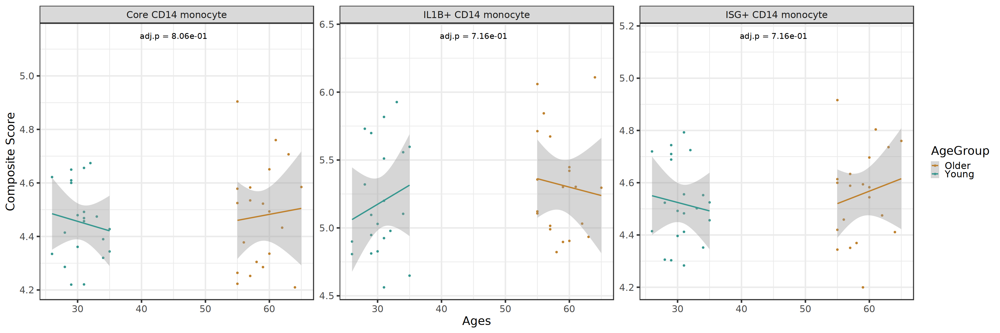

In [94]:
options(repr.plot.width = 30, repr.plot.height = 10)

p <- ggplot(composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0"),
       aes(Ages, composite_score_sum_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype,ncol=4,scale = 'free')+
  expand_limits() 

# Manually add p-value annotations
p <- p + geom_text(data = STAT_res,
                   aes(x = 45, y = max_y, label = paste("adj.p =", p.adj)),
                   size = 6,
                   inherit.aes = FALSE)

p



`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.
`geom_smooth()` using formula = 'y ~ x'


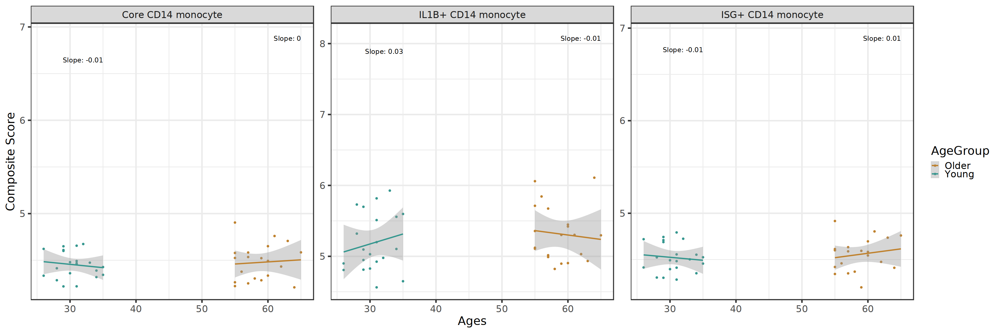

In [95]:


options(repr.plot.width = 30, repr.plot.height = 10)


p <- ggplot(composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0"),
       aes(Ages, composite_score_sum_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype, scale = 'free')

slopes <- composite_score_df_all %>%
  filter(sample.visitName == "Flu Year 1 Day 0") %>%
  group_by(celltype, AgeGroup) %>%
  do(model = lm(composite_score_sum_mean ~ Ages, data = .)) %>%
  summarize(celltype = first(celltype),
            AgeGroup = first(AgeGroup),
            slope = coef(model)[["Ages"]],
            intercept = coef(model)[["(Intercept)"]])

max_values <- composite_score_df_all %>%
  filter(sample.visitName == "Flu Year 1 Day 0") %>%
  group_by(celltype, AgeGroup) %>%
  summarize(max_x = max(Ages), max_y = max(composite_score_sum_mean)+2)

annotations <- slopes %>%
  inner_join(max_values, by = c("celltype", "AgeGroup")) %>%
  mutate(label = paste("Slope:", round(slope, 2)))

p + geom_text(data = annotations, aes(x = max_x, y = max_y, label = label), 
              hjust = 1, vjust = 1, size = 5, color = "black", inherit.aes = FALSE)

`geom_smooth()` using formula = 'y ~ x'


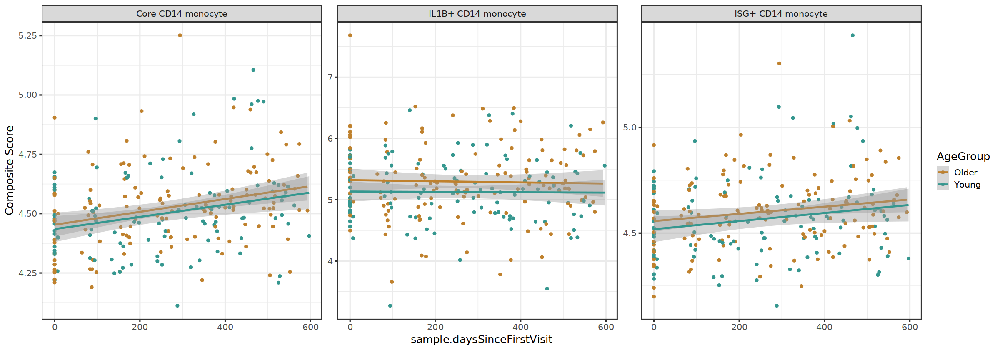

In [96]:
options(repr.plot.width = 20, repr.plot.height = 7)

ggplot(composite_score_df_all %>% filter(sample.daysSinceFirstVisit<600), 
       aes(sample.daysSinceFirstVisit, composite_score_sum_mean,color=AgeGroup)) +
  geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')


In [97]:
donor_id<-sample(unique(composite_score_df_all$subjectGuid),20)

`geom_smooth()` using formula = 'y ~ x'


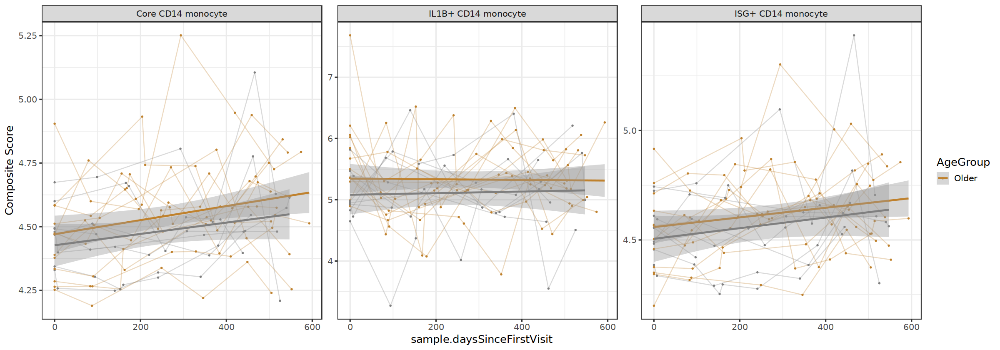

In [98]:
options(repr.plot.width = 20, repr.plot.height = 7)
composite_score_df_all$AgeGroup<-factor(composite_score_df_all$AgeGroup,levels=c("Younger",'Older'))
ggplot(composite_score_df_all %>% filter(sample.daysSinceFirstVisit<600,subjectGuid%in% donor_id), 
       aes(sample.daysSinceFirstVisit, composite_score_sum_mean,color=AgeGroup)) +
  geom_line(aes(group=subjectGuid),linetype = 1,alpha=0.3)+
  geom_point(size=0.5)+ylab('Composite Score')+   scale_color_manual(values = c("Older"='#bf812d',  "Younger"='#35978f'))+
  geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,ncol=3,scale='free')
  

### Stat_test and legend max scaling- Sum_scaled_Mean

In [102]:
STAT_res<-composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0")%>%
  select(composite_score_sum_mean,AgeGroup, celltype, composite_score_sum_scaled_mean ) %>%
  group_by(celltype) %>% 
  wilcox_test(composite_score_sum_scaled_mean ~ AgeGroup) %>%
  adjust_pvalue(method='BH') %>%
  add_significance() 
head(STAT_res)

celltype,.y.,group1,group2,n1,n2,statistic,p,p.adj,p.adj.signif
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>
Core CD14 monocyte,composite_score_sum_scaled_mean,Older,Young,20,21,200,0.806,0.806,ns
IL1B+ CD14 monocyte,composite_score_sum_scaled_mean,Older,Young,20,21,249,0.319,0.806,ns
ISG+ CD14 monocyte,composite_score_sum_scaled_mean,Older,Young,20,21,224,0.728,0.806,ns


In [103]:
STAT_res$p.adj <- formatC(STAT_res$p.adj, format = "e", digits = 2)

In [104]:
max_y<-composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0")%>%
  select(composite_score_sum_scaled_mean,AgeGroup, celltype) %>%
  group_by(celltype) %>%
  dplyr::summarize(max_composite_score_sum_scaled_mean = max(composite_score_sum_scaled_mean)) %>%
  ungroup()%>%select(max_composite_score_sum_scaled_mean) %>% pull()

In [105]:
STAT_res$max_y<-max_y*1.05

Warning message in max(lengths(data)):
“no non-missing arguments to max; returning -Inf”
`geom_smooth()` using formula = 'y ~ x'


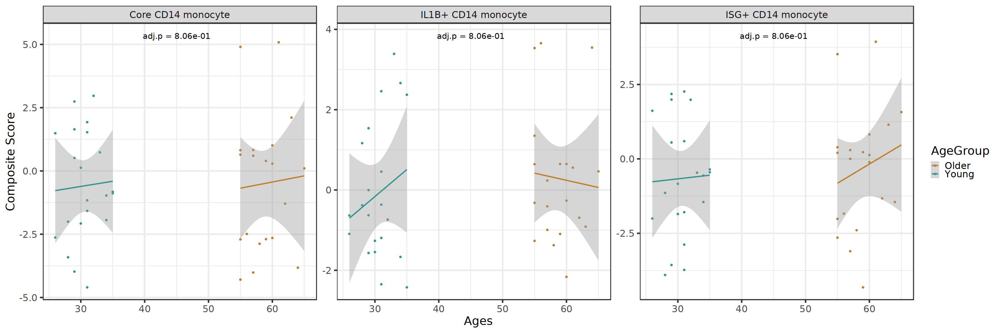

In [106]:
options(repr.plot.width = 30, repr.plot.height = 10)

p <- ggplot(composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0"),
       aes(Ages, composite_score_sum_scaled_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype,ncol=4,scale = 'free')+
  expand_limits() 

# Manually add p-value annotations
p <- p + geom_text(data = STAT_res,
                   aes(x = 45, y = max_y, label = paste("adj.p =", p.adj)),
                   size = 6,
                   inherit.aes = FALSE)

p



`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.
`geom_smooth()` using formula = 'y ~ x'


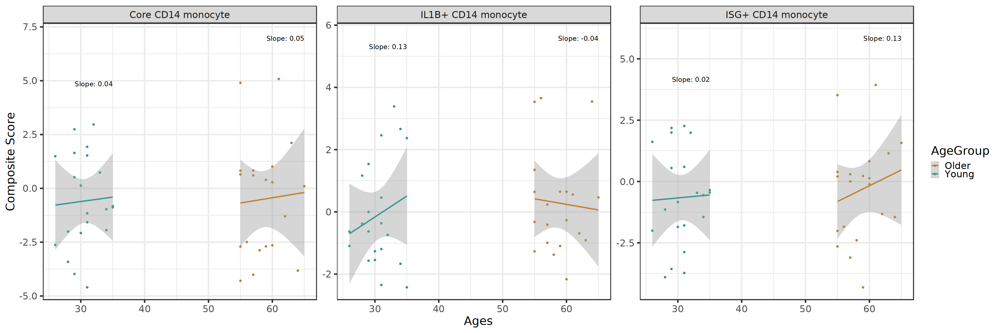

In [107]:


options(repr.plot.width = 30, repr.plot.height = 10)


p <- ggplot(composite_score_df_all %>%
       filter(sample.visitName == "Flu Year 1 Day 0"),
       aes(Ages, composite_score_sum_scaled_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype, scale = 'free')

slopes <- composite_score_df_all %>%
  filter(sample.visitName == "Flu Year 1 Day 0") %>%
  group_by(celltype, AgeGroup) %>%
  do(model = lm(composite_score_sum_scaled_mean ~ Ages, data = .)) %>%
  summarize(celltype = first(celltype),
            AgeGroup = first(AgeGroup),
            slope = coef(model)[["Ages"]],
            intercept = coef(model)[["(Intercept)"]])

max_values <- composite_score_df_all %>%
  filter(sample.visitName == "Flu Year 1 Day 0") %>%
  group_by(celltype, AgeGroup) %>%
  summarize(max_x = max(Ages), max_y = max(composite_score_sum_scaled_mean)+2)

annotations <- slopes %>%
  inner_join(max_values, by = c("celltype", "AgeGroup")) %>%
  mutate(label = paste("Slope:", round(slope, 2)))

p + geom_text(data = annotations, aes(x = max_x, y = max_y, label = label), 
              hjust = 1, vjust = 1, size = 5, color = "black", inherit.aes = FALSE)

`geom_smooth()` using formula = 'y ~ x'


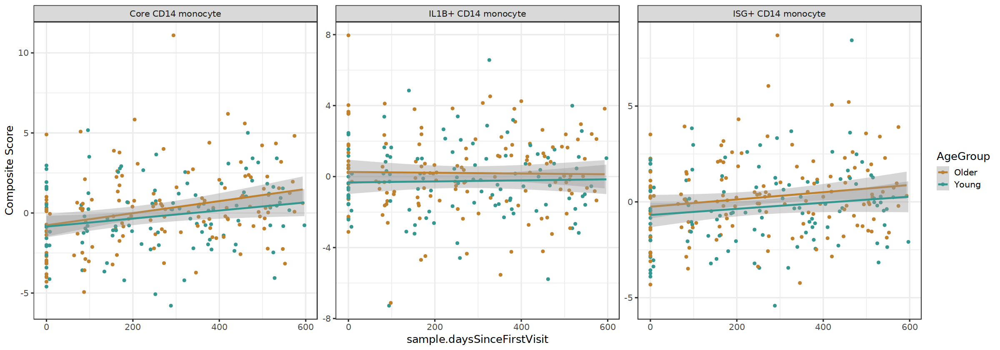

In [108]:
options(repr.plot.width = 20, repr.plot.height = 7)

ggplot(composite_score_df_all %>% filter(sample.daysSinceFirstVisit<600), 
       aes(sample.daysSinceFirstVisit, composite_score_sum_scaled_mean,color=AgeGroup)) +
  geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')


In [109]:
donor_id<-sample(unique(composite_score_df_all$subjectGuid),20)

`geom_smooth()` using formula = 'y ~ x'


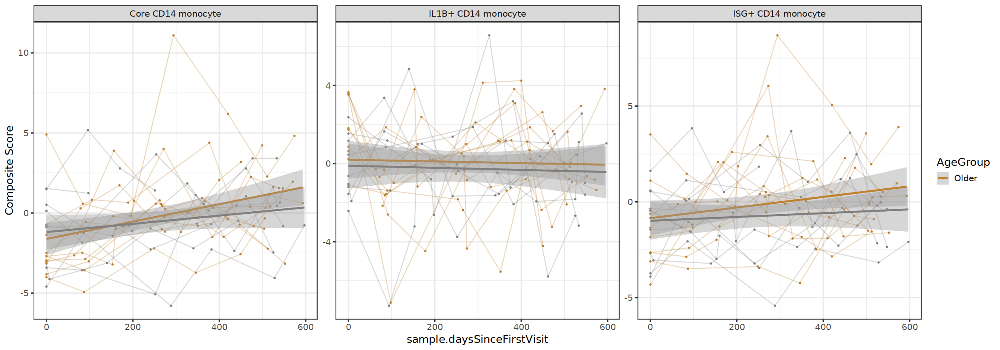

In [110]:
options(repr.plot.width = 20, repr.plot.height = 7)
composite_score_df_all$AgeGroup<-factor(composite_score_df_all$AgeGroup,levels=c("Younger",'Older'))
ggplot(composite_score_df_all %>% filter(sample.daysSinceFirstVisit<600,subjectGuid%in% donor_id), 
       aes(sample.daysSinceFirstVisit, composite_score_sum_scaled_mean,color=AgeGroup)) +
  geom_line(aes(group=subjectGuid),linetype = 1,alpha=0.3)+
  geom_point(size=0.5)+ylab('Composite Score')+   scale_color_manual(values = c("Older"='#bf812d',  "Younger"='#35978f'))+
  geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,ncol=3,scale='free')
  

# Read Deseq2 Result - Female individual gene expressions

In [111]:
meta_data_subset <- meta_data %>% 
  filter(Covid_exclusion == 'no', !sample.visitName	%in% c('Flu Year 1 Day 7','Flu Year 2 Day 7'), subject.biologicalSex == "Female")


In [ ]:
unique(meta_data_subset$sample.visitName)
unique(meta_data_subset$subject.biologicalSex)

In [ ]:
deseq2_result_Y1D0<-read.csv('/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/DESEQ2/Female_Deseq2_Result_Y1D0.csv')

In [ ]:
genes_of_interest <- c('G0S2', 'NR4A1', 'PTGS2', 'BCL2A1', 'METRNL' ,'RASGEF1B', 'NLRP3', 'RIPK2', 'RABL6', 'CMTM6', 'SGK1', 'SELENOK', 'MIDN', 'OAZ1')
length(genes_of_interest)

In [ ]:
# filter significant genes 
# deseq2_result_Y1D0_AgeGroup_sig<-deseq2_result_Y1D0 %>% 
#   filter(contrast == "cohort.cohortGuid") %>%
#   filter(padj < 0.1, 
#          abs(log2FoldChange) > 0.1)

deseq2_result_Y1D0_AgeGroup_sig<-deseq2_result_Y1D0 %>% 
  filter(contrast == "cohort.cohortGuid") %>%
  filter(gene %in% genes_of_interest )

In [ ]:
head(deseq2_result_Y1D0_AgeGroup_sig)

## Filter Genes and CellTypes

In [ ]:
df_degs_counts<-as.data.frame(table(deseq2_result_Y1D0_AgeGroup_sig$celltype,deseq2_result_Y1D0_AgeGroup_sig$Direction))
head(df_degs_counts)

In [ ]:
celltypes <- c("IL1B+ CD14 monocyte")

In [ ]:
df_degs_counts_filtered<-df_degs_counts %>% arrange(Var1)  %>% filter(Var1 %in% celltypes)

In [ ]:
df_degs_counts_filtered

## Construct Composite Score - individual genes

In [ ]:
# Function to get mean gene expression over time.
function_mean_gene_exp_stability <- function(celltype_single) {
    top_n <- 100
    Direction_of_DEG <- "BR2"
    
    # Select the top N genes for the current cell type and direction
    selected_genes <- deseq2_result_Y1D0_AgeGroup_sig %>%
        filter(celltype == celltype_single, Direction == Direction_of_DEG) %>%
        arrange(padj, desc(abs(log2FoldChange))) %>%
        slice_head(n = top_n) %>%
        select(gene) %>%
        pull()
    
    # Filter the genes and cell type from the data
    long_format <- filter_genes_and_celltype(df_list, selected_genes, celltype_single, longformat = TRUE)
    
    # Merge with metadata
    long_format <- left_join(long_format, meta_data, by = "pbmc_sample_id")
    
    # Z-score (optional)
    long_format <- long_format %>%
        group_by(Gene) %>%
        mutate(Z_score_Mean_Expression = scale(Mean_Expression)) %>%
        ungroup()
    
    # Keep the data as is, without summarizing, to get individual gene expressions
    long_format$celltype <- celltype_single
    
    return(long_format)
}

# Apply the function to each unique cell type using mclapply
expression_df_list <- mclapply(unique(df_degs_counts_filtered$Var1), function_mean_gene_exp_stability, mc.cores = 10)

# Combine the list of data frames into one
combined_expression_df <- do.call(rbind, expression_df_list)


In [ ]:
combined_expression_df<-combined_expression_df %>% mutate(AgeGroup=case_when(cohort.cohortGuid=="BR1"~"Young", TRUE~'Older'))

In [ ]:
head(combined_expression_df)
dim(combined_expression_df)

In [ ]:
unique(combined_expression_df$sample.visitName)

In [ ]:
STAT_res<-combined_expression_df %>%
       filter(sample.visitName == "Flu Year 1 Day 0")%>%
  select(Gene ,AgeGroup, celltype, Mean_Expression ) %>%
  group_by(Gene) %>% 
  wilcox_test(Mean_Expression ~ AgeGroup) %>%
  adjust_pvalue(method='BH') %>%
  add_significance() 
head(STAT_res)

In [ ]:
STAT_res

In [ ]:
STAT_res$p.adj <- formatC(STAT_res$p.adj, format = "e", digits = 2)

In [ ]:
max_y<-combined_expression_df %>%
       filter(sample.visitName == "Flu Year 1 Day 0")%>%
  select(Mean_Expression,AgeGroup, celltype, Gene) %>%
  group_by(Gene) %>%
  dplyr::summarize(max_Mean_Expression = max(Mean_Expression)) %>%
  ungroup()%>%select(max_Mean_Expression) %>% pull()

In [ ]:
STAT_res$max_y<-max_y*1.05

In [ ]:
options(repr.plot.width = 30, repr.plot.height = 20)

p <- ggplot(combined_expression_df %>%
       filter(sample.visitName == "Flu Year 1 Day 0"),
       aes(Ages, Mean_Expression, color = AgeGroup)) +
  geom_point() +
  ylab('Mean Gene Expression') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~Gene,ncol=4,scale = 'free')+
  expand_limits() 

# Manually add p-value annotations
p <- p + geom_text(data = STAT_res,
                   aes(x = 45, y = max_y, label = paste("adj.p =", p.adj)),
                   size = 6,
                   inherit.aes = FALSE)

p



In [ ]:
colnames(combined_expression_df)

In [ ]:
options(repr.plot.width = 20, repr.plot.height = 20)

ggplot(combined_expression_df %>% filter(sample.daysSinceFirstVisit<650), 
       aes(sample.visitName, Mean_Expression,color=AgeGroup)) +
  geom_point()+ylab('Mean_Expression')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~Gene,,ncol=4,scale='free')


# Gene expression- no split

In [112]:
meta_data_subset<-meta_data %>% filter(Covid_exclusion=='no',
                                       !sample.visitName%in% c('Flu Year 1 Day 7',
                                                               'Flu Year 2 Day 7'),
                                      sample.daysSinceFirstVisit<650)

In [113]:
file_list<-paste0("/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/scRNA/BRI/Average_LogNormalized_Expression/Average_LogNormalized_Expression_of_Celltypes_by_Sample_AIFI_L3/", meta_data_subset$pbmc_sample_id, ".csv")

In [114]:
df_list<-read_pesudobulk_expression(file_list, mc_cores = 60) #. reating pseudobulk object

[1] "Total reading time: 50.459 seconds"


In [115]:
genes_of_interest <- c('G0S2', 'NR4A1', 'PTGS2', 'BCL2A1', 'METRNL' ,'RASGEF1B', 'NLRP3', 'RIPK2', 'RABL6', 'CMTM6', 'SGK1', 'SELENOK', 'MIDN', 'OAZ1')
length(genes_of_interest)

[1] 14

In [116]:
# Define the genes of interest
genes_of_interest <- c('G0S2', 'NR4A1', 'PTGS2', 'BCL2A1', 'METRNL' ,'RASGEF1B', 'NLRP3', 'RIPK2', 'RABL6', 'CMTM6', 'SGK1', 'SELENOK', 'MIDN', 'OAZ1')
length(genes_of_interest)

# Filter the data for the genes of interest and the cell type
long_format <- filter_genes_and_celltype(df_list, 
                                         genes_of_interest, 
                                         "IL1B+ CD14 monocyte", 
                                         longformat = TRUE)

# Merge with the metadata subset
long_format <- left_join(long_format, meta_data_subset, by = "pbmc_sample_id")

# Mutate the data to add AgeGroup based on cohort.cohortGuid
long_format <- long_format %>% 
  mutate(AgeGroup = case_when(cohort.cohortGuid == "BR1" ~ "Young", TRUE ~ 'Older'))

long_format <- long_format %>%
  group_by(Gene) %>%
  mutate(Z_score_Mean_Expression = scale(Mean_Expression)) %>%
  ungroup()

[1] 14

In [117]:
long_format<-long_format %>% mutate(AgeGroup=case_when(cohort.cohortGuid=="BR1"~"Young", TRUE~'Older'))

`geom_smooth()` using formula = 'y ~ x'


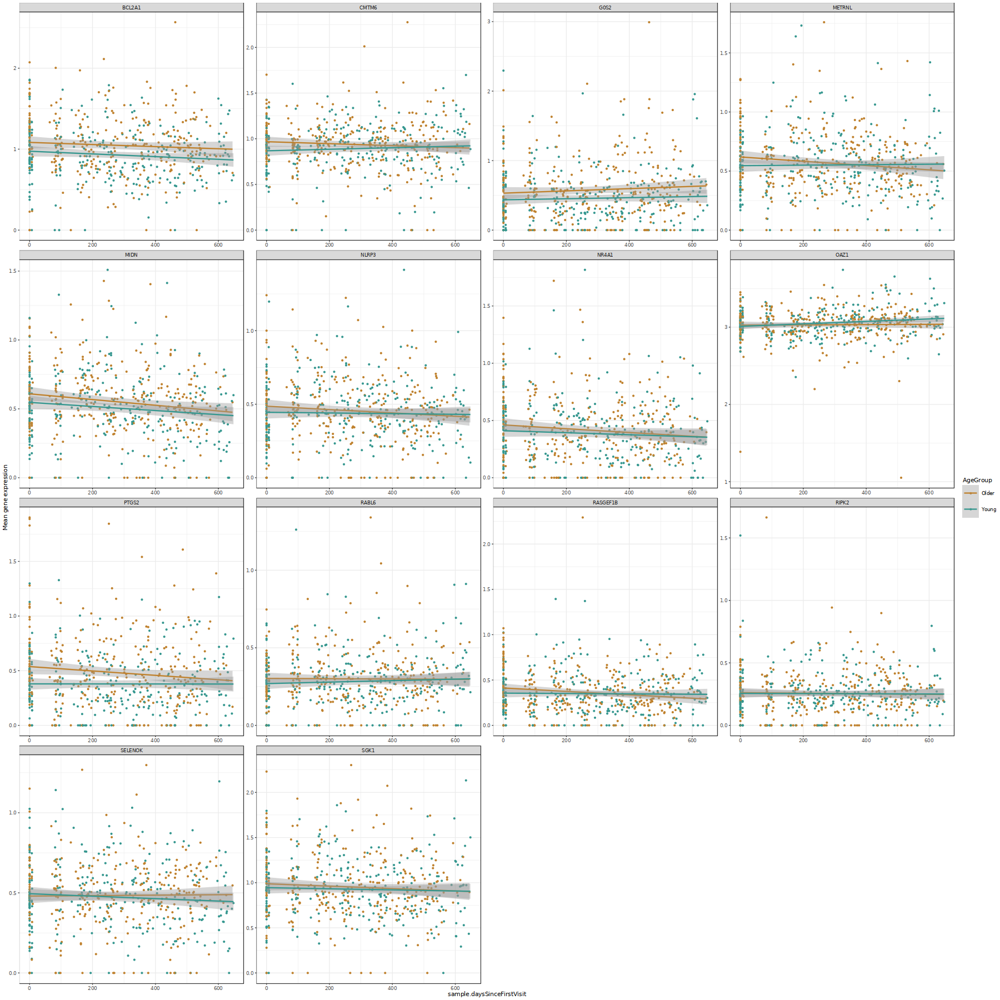

In [118]:
options(repr.plot.width = 15, repr.plot.height = 15)

ggplot(long_format , 
       aes(sample.daysSinceFirstVisit, Mean_Expression,color=AgeGroup)) +
  geom_point(size=0.1)+ylab('Mean gene expression')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm",linewidth=0.5)+theme_bw(base_size=6)+facet_wrap(~Gene,,ncol=4,scale='free')
     

`geom_smooth()` using formula = 'y ~ x'


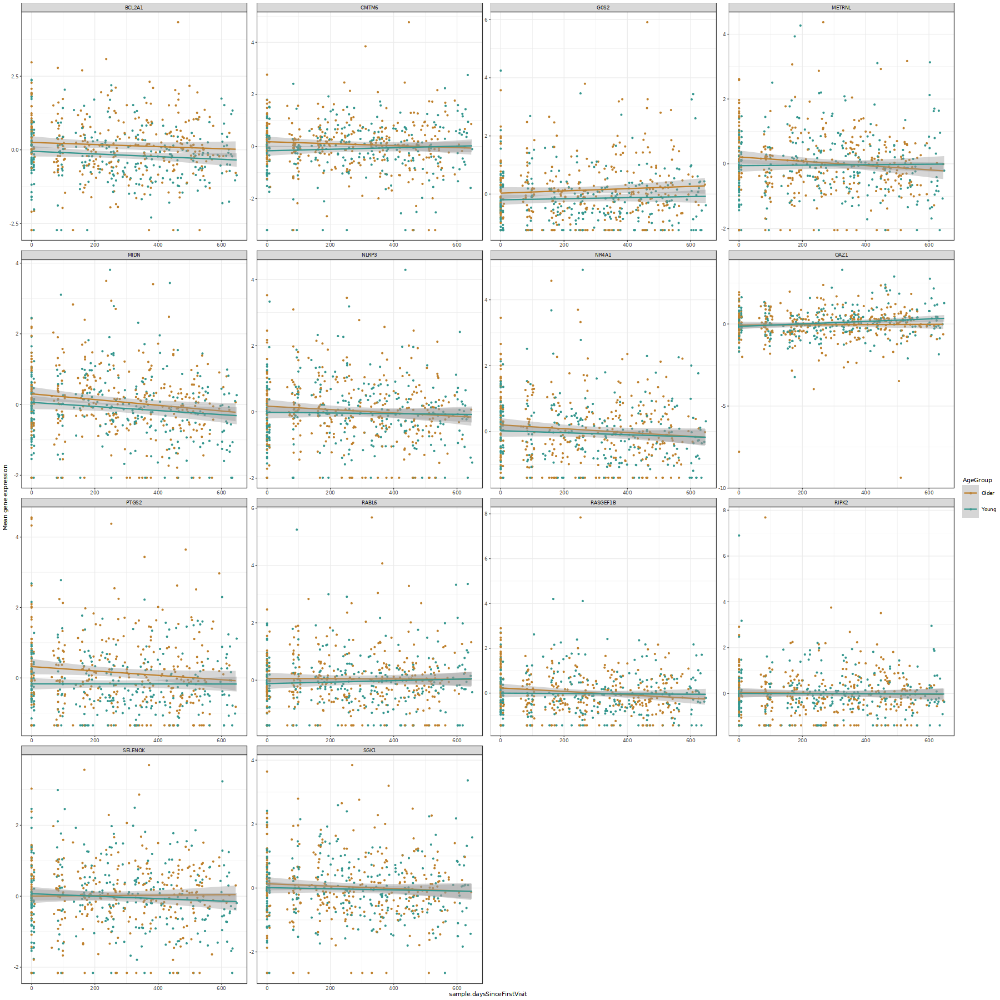

In [119]:
options(repr.plot.width = 15, repr.plot.height = 15)

ggplot(long_format , 
       aes(sample.daysSinceFirstVisit, Z_score_Mean_Expression,color=AgeGroup)) +
  geom_point(size=0.1)+ylab('Mean gene expression')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm",linewidth=0.5)+theme_bw(base_size=6)+facet_wrap(~Gene,,ncol=4,scale='free')
     

# Gene expression- split by Female

In [139]:
meta_data_subset<-meta_data %>% filter(Covid_exclusion=='no',
                                       !sample.visitName%in% c('Flu Year 1 Day 7',
                                                               'Flu Year 2 Day 7'),
                                      sample.daysSinceFirstVisit<600, subject.biologicalSex == "Female" )

In [140]:
file_list<-paste0("/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/scRNA/BRI/Average_LogNormalized_Expression/Average_LogNormalized_Expression_of_Celltypes_by_Sample_AIFI_L3/", meta_data_subset$pbmc_sample_id, ".csv")

In [141]:
df_list<-read_pesudobulk_expression(file_list, mc_cores = 60) #. reating pseudobulk object

[1] "Total reading time: 34.64 seconds"


In [142]:
genes_of_interest <- c('G0S2', 'NR4A1', 'PTGS2', 'BCL2A1', 'METRNL' ,'RASGEF1B', 'NLRP3', 'RIPK2', 'RABL6', 'CMTM6', 'SGK1', 'SELENOK', 'MIDN', 'OAZ1')
length(genes_of_interest)

[1] 14

In [143]:
# Define the genes of interest
genes_of_interest <- c('G0S2', 'NR4A1', 'PTGS2', 'BCL2A1', 'METRNL' ,'RASGEF1B', 'NLRP3', 'RIPK2', 'RABL6', 'CMTM6', 'SGK1', 'SELENOK', 'MIDN', 'OAZ1')
length(genes_of_interest)

# Filter the data for the genes of interest and the cell type
long_format <- filter_genes_and_celltype(df_list, 
                                         genes_of_interest, 
                                         "IL1B+ CD14 monocyte", 
                                         longformat = TRUE)

# Merge with the metadata subset
long_format <- left_join(long_format, meta_data_subset, by = "pbmc_sample_id")

# Mutate the data to add AgeGroup based on cohort.cohortGuid
long_format <- long_format %>% 
  mutate(AgeGroup = case_when(cohort.cohortGuid == "BR1" ~ "Young", TRUE ~ 'Older'))

long_format <- long_format %>%
  group_by(Gene) %>%
  mutate(Z_score_Mean_Expression = scale(Mean_Expression)) %>%
  ungroup()

[1] 14

In [144]:
head(long_format)
unique(long_format$subject.biologicalSex)

Gene,Samples,Mean_Expression,pbmc_sample_id,celltype,X,Unnamed..0,lastUpdated,sample.id,sample.bridgingControl,⋯,cohort.cohortGuid,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages,AgeGroup,Z_score_Mean_Expression
<chr>,<fct>,<dbl>,<chr>,<chr>,<int>,<int>,<chr>,<chr>,<chr>,⋯,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<chr>,"<dbl[,1]>"
G0S2,PB00001-01:IL1B+ CD14 monocyte,0.3337376,PB00001-01,IL1B+ CD14 monocyte,0,1,2024-05-10T17:12:44.959Z,f499ff83-e513-4d24-a10f-151348269fff,False,⋯,BR1,NA,NA,NA,no,BR1001,Negative,32,Young,-0.4141778709
NR4A1,PB00001-01:IL1B+ CD14 monocyte,0.2176656,PB00001-01,IL1B+ CD14 monocyte,0,1,2024-05-10T17:12:44.959Z,f499ff83-e513-4d24-a10f-151348269fff,False,⋯,BR1,NA,NA,NA,no,BR1001,Negative,32,Young,-0.6691266443
PTGS2,PB00001-01:IL1B+ CD14 monocyte,0.4266934,PB00001-01,IL1B+ CD14 monocyte,0,1,2024-05-10T17:12:44.959Z,f499ff83-e513-4d24-a10f-151348269fff,False,⋯,BR1,NA,NA,NA,no,BR1001,Negative,32,Young,-0.0304901090
BCL2A1,PB00001-01:IL1B+ CD14 monocyte,0.9481724,PB00001-01,IL1B+ CD14 monocyte,0,1,2024-05-10T17:12:44.959Z,f499ff83-e513-4d24-a10f-151348269fff,False,⋯,BR1,NA,NA,NA,no,BR1001,Negative,32,Young,-0.1924713135
METRNL,PB00001-01:IL1B+ CD14 monocyte,0.3426711,PB00001-01,IL1B+ CD14 monocyte,0,1,2024-05-10T17:12:44.959Z,f499ff83-e513-4d24-a10f-151348269fff,False,⋯,BR1,NA,NA,NA,no,BR1001,Negative,32,Young,-0.7979041767
RASGEF1B,PB00001-01:IL1B+ CD14 monocyte,0.3769068,PB00001-01,IL1B+ CD14 monocyte,0,1,2024-05-10T17:12:44.959Z,f499ff83-e513-4d24-a10f-151348269fff,False,⋯,BR1,NA,NA,NA,no,BR1001,Negative,32,Young,-0.0009691673


[1] "Female"

In [145]:
long_format<-long_format %>% mutate(AgeGroup=case_when(cohort.cohortGuid=="BR1"~"Young", TRUE~'Older'))

`geom_smooth()` using formula = 'y ~ x'


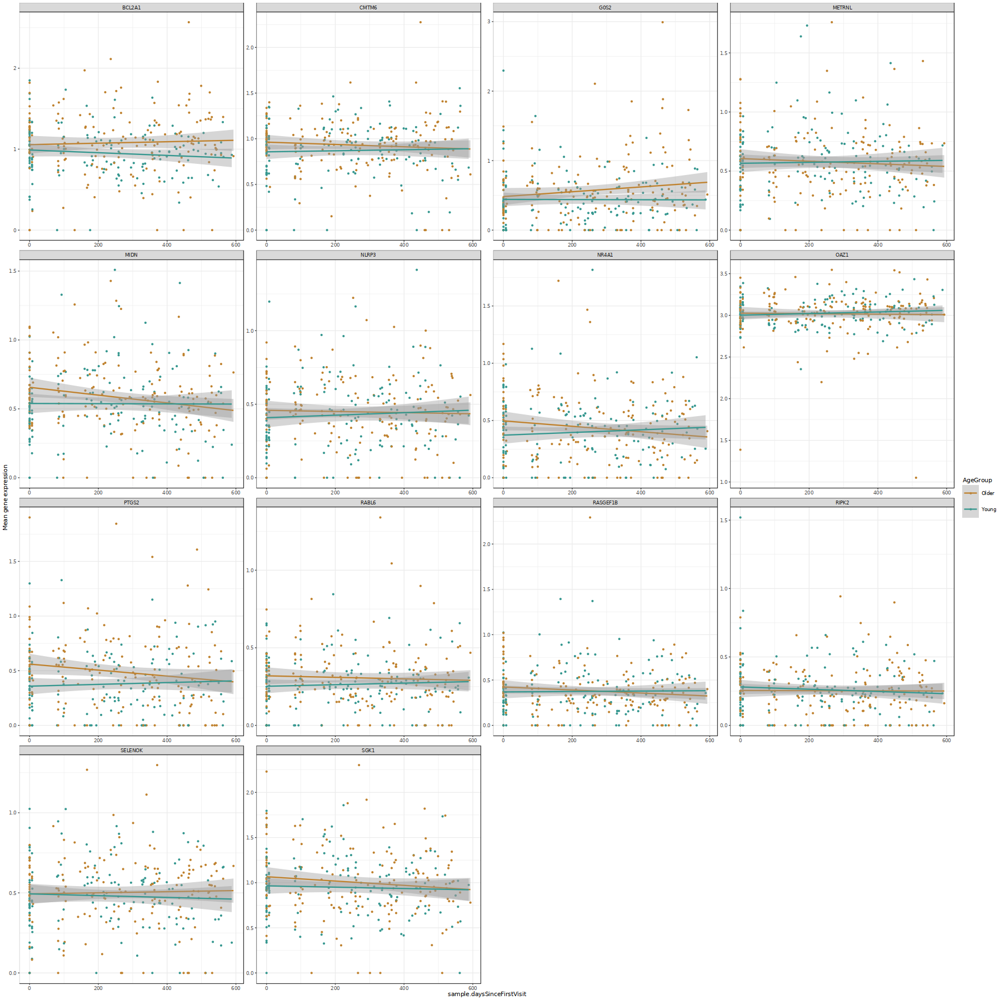

In [146]:
options(repr.plot.width = 15, repr.plot.height = 15)

ggplot(long_format , 
       aes(sample.daysSinceFirstVisit, Mean_Expression,color=AgeGroup)) +
  geom_point(size=0.1)+ylab('Mean gene expression')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm",linewidth=0.5)+theme_bw(base_size=6)+facet_wrap(~Gene,,ncol=4,scale='free')
     

`geom_smooth()` using formula = 'y ~ x'


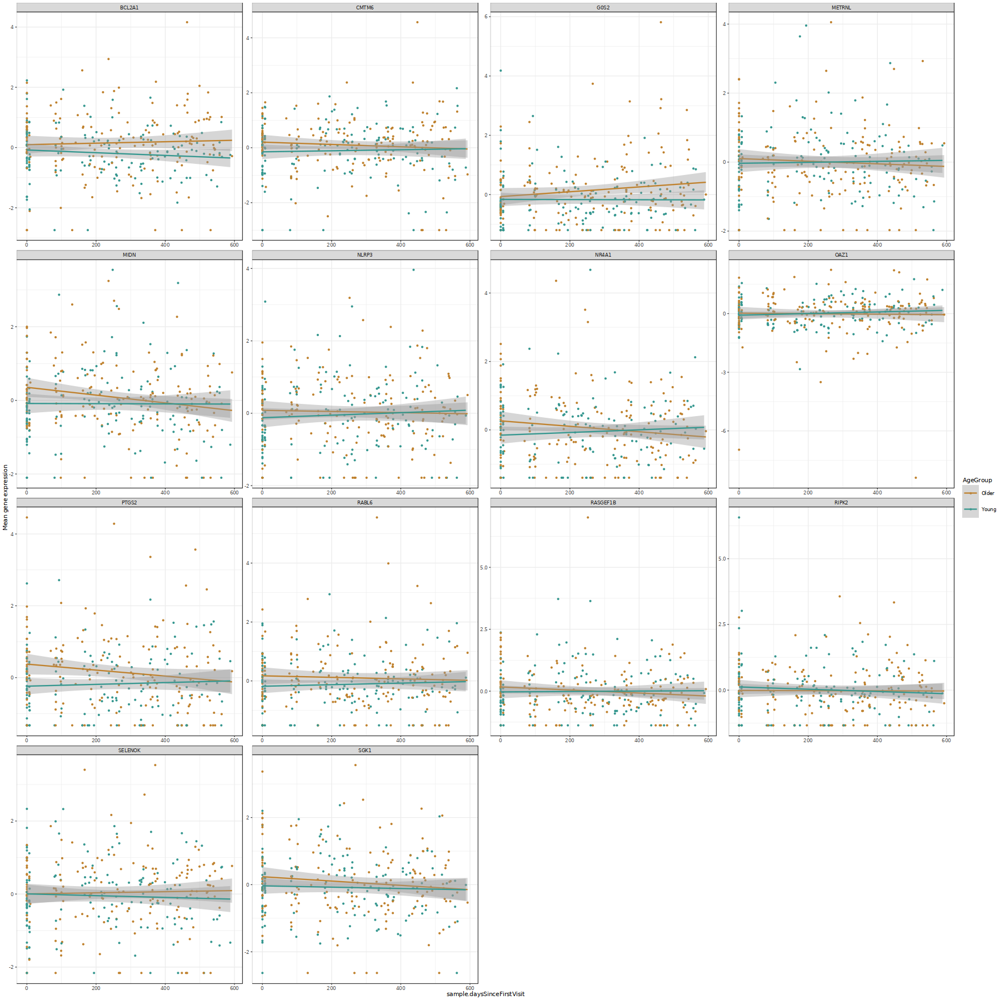

In [147]:
options(repr.plot.width = 15, repr.plot.height = 15)

ggplot(long_format , 
       aes(sample.daysSinceFirstVisit, Z_score_Mean_Expression,color=AgeGroup)) +
  geom_point(size=0.1)+ylab('Mean gene expression')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm",linewidth=0.5)+theme_bw(base_size=6)+facet_wrap(~Gene,,ncol=4,scale='free')
     

# Gene expression- split by Male

In [148]:
meta_data_subset<-meta_data %>% filter(Covid_exclusion=='no',
                                       !sample.visitName%in% c('Flu Year 1 Day 7',
                                                               'Flu Year 2 Day 7'),
                                      sample.daysSinceFirstVisit<600, subject.biologicalSex == "Male" )

In [149]:
file_list<-paste0("/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/scRNA/BRI/Average_LogNormalized_Expression/Average_LogNormalized_Expression_of_Celltypes_by_Sample_AIFI_L3/", meta_data_subset$pbmc_sample_id, ".csv")

In [150]:
df_list<-read_pesudobulk_expression(file_list, mc_cores = 60) #. reating pseudobulk object

[1] "Total reading time: 31.2239999999997 seconds"


In [151]:
genes_of_interest <- c('G0S2', 'NR4A1', 'PTGS2', 'BCL2A1', 'METRNL' ,'RASGEF1B', 'NLRP3', 'RIPK2', 'RABL6', 'CMTM6', 'SGK1', 'SELENOK', 'MIDN', 'OAZ1')
length(genes_of_interest)

[1] 14

In [152]:
# Define the genes of interest
genes_of_interest <- c('G0S2', 'NR4A1', 'PTGS2', 'BCL2A1', 'METRNL' ,'RASGEF1B', 'NLRP3', 'RIPK2', 'RABL6', 'CMTM6', 'SGK1', 'SELENOK', 'MIDN', 'OAZ1')
length(genes_of_interest)

# Filter the data for the genes of interest and the cell type
long_format <- filter_genes_and_celltype(df_list, 
                                         genes_of_interest, 
                                         "IL1B+ CD14 monocyte", 
                                         longformat = TRUE)

# Merge with the metadata subset
long_format <- left_join(long_format, meta_data_subset, by = "pbmc_sample_id")

# Mutate the data to add AgeGroup based on cohort.cohortGuid
long_format <- long_format %>% 
  mutate(AgeGroup = case_when(cohort.cohortGuid == "BR1" ~ "Young", TRUE ~ 'Older'))

long_format <- long_format %>%
  group_by(Gene) %>%
  mutate(Z_score_Mean_Expression = scale(Mean_Expression)) %>%
  ungroup()

[1] 14

In [153]:
head(long_format)
unique(long_format$subject.biologicalSex)

Gene,Samples,Mean_Expression,pbmc_sample_id,celltype,X,Unnamed..0,lastUpdated,sample.id,sample.bridgingControl,⋯,cohort.cohortGuid,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages,AgeGroup,Z_score_Mean_Expression
<chr>,<fct>,<dbl>,<chr>,<chr>,<int>,<int>,<chr>,<chr>,<chr>,⋯,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<chr>,"<dbl[,1]>"
G0S2,PB00002-01:IL1B+ CD14 monocyte,0.96725026,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,1.1335655
NR4A1,PB00002-01:IL1B+ CD14 monocyte,0.07381296,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-1.1438643
PTGS2,PB00002-01:IL1B+ CD14 monocyte,0.22664239,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-0.6415119
BCL2A1,PB00002-01:IL1B+ CD14 monocyte,0.76844798,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-0.5352853
METRNL,PB00002-01:IL1B+ CD14 monocyte,0.33505264,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-0.8662241
RASGEF1B,PB00002-01:IL1B+ CD14 monocyte,0.17257819,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-0.7366492


[1] "Male"

In [154]:
long_format<-long_format %>% mutate(AgeGroup=case_when(cohort.cohortGuid=="BR1"~"Young", TRUE~'Older'))

`geom_smooth()` using formula = 'y ~ x'


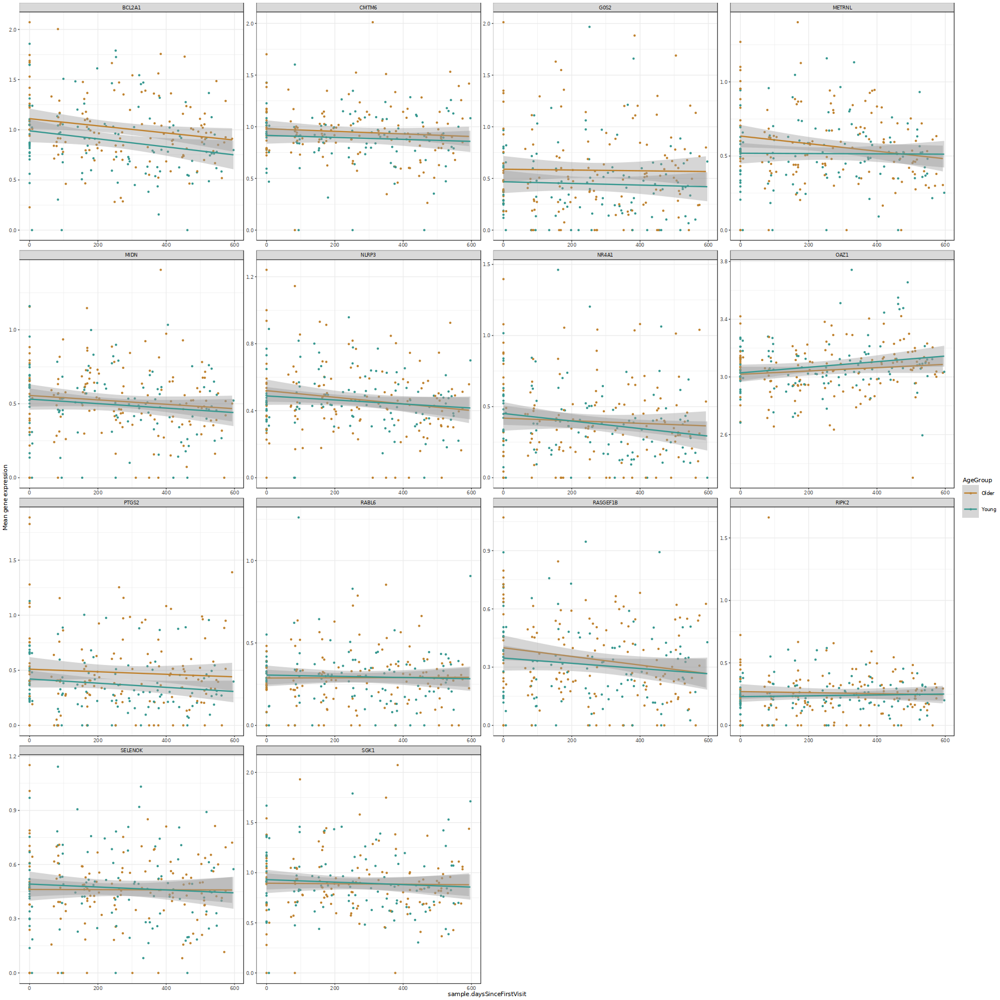

In [155]:
options(repr.plot.width = 15, repr.plot.height = 15)

ggplot(long_format , 
       aes(sample.daysSinceFirstVisit, Mean_Expression,color=AgeGroup)) +
  geom_point(size=0.1)+ylab('Mean gene expression')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm",linewidth=0.5)+theme_bw(base_size=6)+facet_wrap(~Gene,,ncol=4,scale='free')
     

`geom_smooth()` using formula = 'y ~ x'


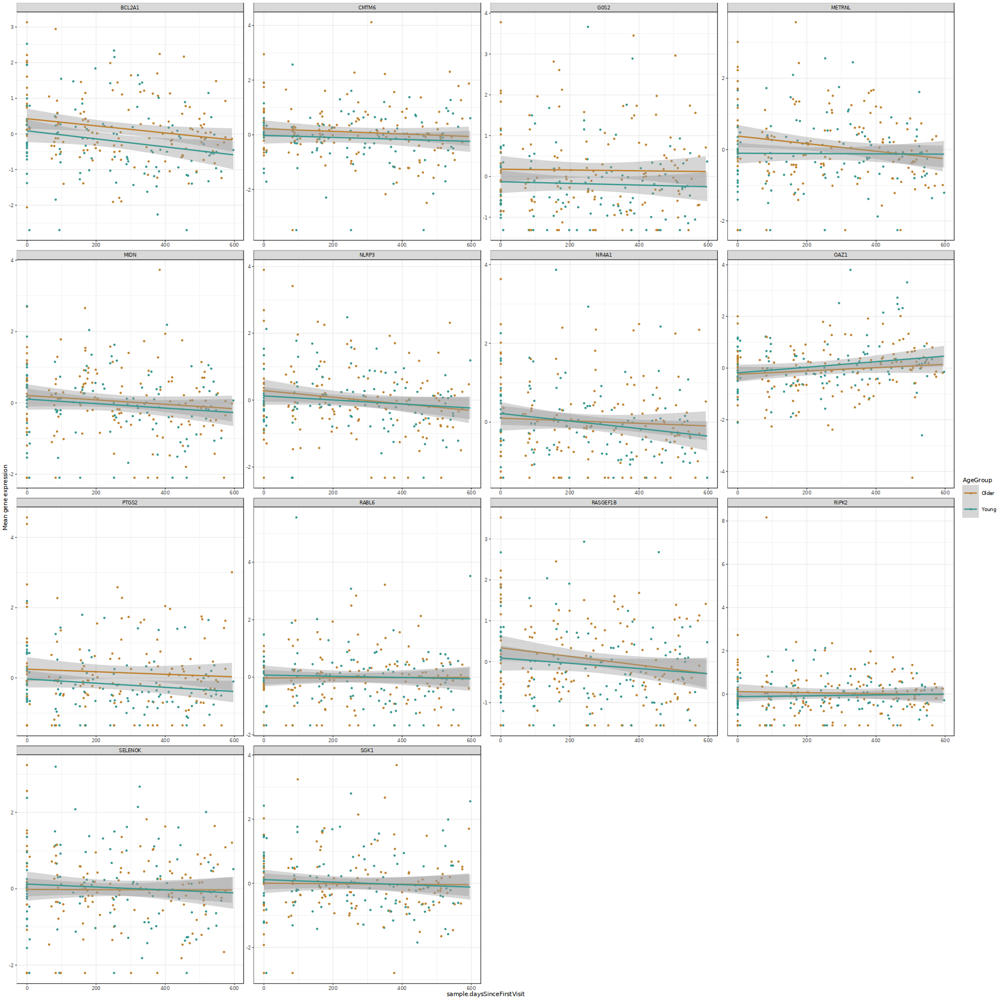

In [156]:
options(repr.plot.width = 15, repr.plot.height = 15)

ggplot(long_format , 
       aes(sample.daysSinceFirstVisit, Z_score_Mean_Expression,color=AgeGroup)) +
  geom_point(size=0.1)+ylab('Mean gene expression')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm",linewidth=0.5)+theme_bw(base_size=6)+facet_wrap(~Gene,,ncol=4,scale='free')
     

# CLR days since visit

In [159]:
head(l3)
colnames(l3)

,cohort.cohortGuid,subject.subjectGuid,subject.biologicalSex,subject.cmv,subject.bmi,subject.race,subject.ethnicity,subject.birthYear,subject.ageAtFirstDraw,sample.sampleKitGuid,⋯,AIFI_L2,AIFI_L3,AIFI_L3_count,total_cells,scrna.lymphocyte_count,bc.lymphocyte_count,alc_ratio,AIFI_L3_frac_total,AIFI_L3_alc,AIFI_L3_clr
,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<int>,<int>,<chr>,⋯,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>
1,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Effector B cell,CD27+ effector B cell,71,18231,13903,1337,0.0961663,0.0038944655,6.8278069,0.3324226
2,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Effector B cell,CD27- effector B cell,26,18231,13903,1337,0.0961663,0.0014261423,2.5003237,-0.6721608
3,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Memory B cell,Activated memory B cell,3,18231,13903,1337,0.0961663,0.0001645549,0.2884989,-2.8316450
4,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Memory B cell,CD95 memory B cell,15,18231,13903,1337,0.0961663,0.0008227744,1.4424944,-1.2222071
5,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Memory B cell,Core memory B cell,329,18231,13903,1337,0.0961663,0.0180461851,31.6387111,1.8658004
6,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Memory B cell,Early memory B cell,10,18231,13903,1337,0.0961663,0.0005485163,0.9616630,-1.6276722


[1] "cohort.cohortGuid"       "subject.subjectGuid"    
 [3] "subject.biologicalSex"   "subject.cmv"            
 [5] "subject.bmi"             "subject.race"           
 [7] "subject.ethnicity"       "subject.birthYear"      
 [9] "subject.ageAtFirstDraw"  "sample.sampleKitGuid"   
[11] "sample.visitName"        "sample.drawDate"        
[13] "sample.subjectAgeAtDraw" "specimen.specimenGuid"  
[15] "AIFI_L1"                 "AIFI_L2"                
[17] "AIFI_L3"                 "AIFI_L3_count"          
[19] "total_cells"             "scrna.lymphocyte_count" 
[21] "bc.lymphocyte_count"     "alc_ratio"              
[23] "AIFI_L3_frac_total"      "AIFI_L3_alc"            
[25] "AIFI_L3_clr"

In [162]:
l3 <- l3 %>%
  rename(pbmc_sample_id = specimen.specimenGuid)


In [163]:
meta_data_filt<-meta_data %>% filter(Covid_exclusion=='no',
                                       !sample.visitName%in% c('Flu Year 1 Day 7',
                                                               'Flu Year 2 Day 7'),
                                      sample.daysSinceFirstVisit<600, subject.biologicalSex == "Female" )

In [164]:
# Merge with the metadata subset
long_format <- left_join(l3, meta_data_filt, by = "pbmc_sample_id")

In [167]:
dim(long_format)
head(long_format)
colnames(long_format)

[1] 58816    57

,cohort.cohortGuid.x,subject.subjectGuid.x,subject.biologicalSex.x,subject.cmv,subject.bmi,subject.race.x,subject.ethnicity.x,subject.birthYear.x,subject.ageAtFirstDraw,sample.sampleKitGuid.x,⋯,subject.race.y,subject.subjectGuid.y,cohort.cohortGuid.y,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages
,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<int>,<int>,<chr>,⋯,<chr>,<chr>,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>
1,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Caucasian,BR1001,BR1,NA,NA,NA,no,BR1001,Negative,32
2,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Caucasian,BR1001,BR1,NA,NA,NA,no,BR1001,Negative,32
3,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Caucasian,BR1001,BR1,NA,NA,NA,no,BR1001,Negative,32
4,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Caucasian,BR1001,BR1,NA,NA,NA,no,BR1001,Negative,32
5,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Caucasian,BR1001,BR1,NA,NA,NA,no,BR1001,Negative,32
6,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Caucasian,BR1001,BR1,NA,NA,NA,no,BR1001,Negative,32


[1] "cohort.cohortGuid.x"                      
 [2] "subject.subjectGuid.x"                    
 [3] "subject.biologicalSex.x"                  
 [4] "subject.cmv"                              
 [5] "subject.bmi"                              
 [6] "subject.race.x"                           
 [7] "subject.ethnicity.x"                      
 [8] "subject.birthYear.x"                      
 [9] "subject.ageAtFirstDraw"                   
[10] "sample.sampleKitGuid.x"                   
[11] "sample.visitName.x"                       
[12] "sample.drawDate.x"                        
[13] "sample.subjectAgeAtDraw"                  
[14] "pbmc_sample_id"                           
[15] "AIFI_L1"                                  
[16] "AIFI_L2"                                  
[17] "AIFI_L3"                                  
[18] "AIFI_L3_count"                            
[19] "total_cells"                              
[20] "scrna.lymphocyte_count"                   
[21] "bc.lymphocyte_count"                      
[22] "alc_ratio"                                
[23] "AIFI_L3_frac_total"                       
[24] "AIFI_L3_alc"                              
[25] "AIFI_L3_clr"                              
[26] "X"                                        
[27] "Unnamed..0"                               
[28] "lastUpdated"                              
[29] "sample.id"                                
[30] "sample.bridgingControl"                   
[31] "sample.sampleKitGuid.y"                   
[32] "sample.visitName.y"                       
[33] "sample.visitDetails"                      
[34] "sample.drawDate.y"                        
[35] "sample.daysSinceFirstVisit"               
[36] "file.id"                                  
[37] "file.name"                                
[38] "file.batchID"                             
[39] "file.panel"                               
[40] "file.pool"                                
[41] "file.fileType"                            
[42] "file.majorVersion"                        
[43] "subject.id"                               
[44] "subject.biologicalSex.y"                  
[45] "subject.birthYear.y"                      
[46] "subject.ethnicity.y"                      
[47] "subject.partnerCode"                      
[48] "subject.race.y"                           
[49] "subject.subjectGuid.y"                    
[50] "cohort.cohortGuid.y"                      
[51] "sample.diseaseStatesRecordedAtVisit"      
[52] "subject.covidVaxDose1.daysSinceFirstVisit"
[53] "subject.covidVaxDose2.daysSinceFirstVisit"
[54] "Covid_exclusion"                          
[55] "subjectGuid"                              
[56] "CMV"                                      
[57] "Ages"

In [185]:
long_format <- long_format %>% filter(AIFI_L3 == "IL1B+ CD14 monocyte")

long_format<-long_format %>% mutate(AgeGroup=case_when(cohort.cohortGuid.y=="BR1"~"Young", TRUE~'Older'))

`geom_smooth()` using formula = 'y ~ x'
Warning message:
“Removed 554 rows containing non-finite values (`stat_smooth()`).”
Warning message:
“Removed 554 rows containing missing values (`geom_point()`).”


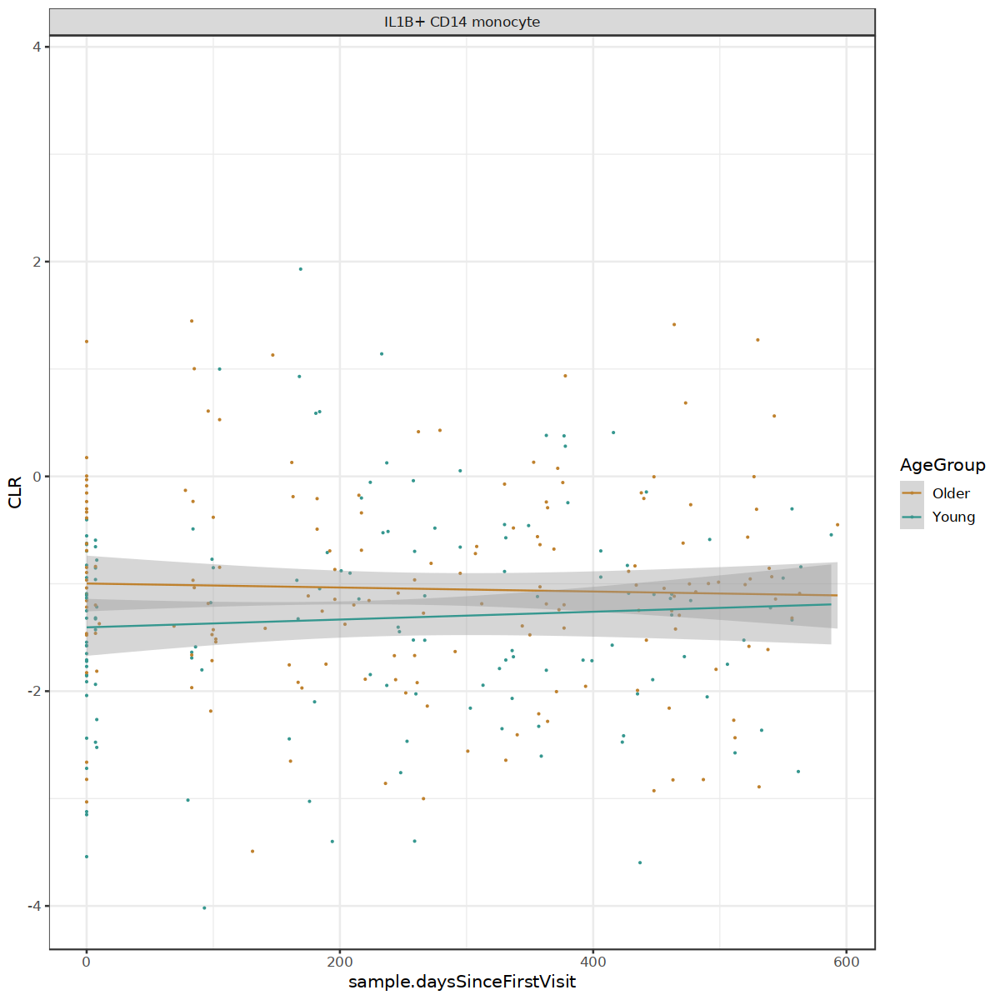

In [186]:
options(repr.plot.width = 10, repr.plot.height = 10)

ggplot(long_format , 
       aes(sample.daysSinceFirstVisit, AIFI_L3_clr,color=AgeGroup)) +
  geom_point(size=0.1)+ylab('CLR')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm",linewidth=0.5)+theme_bw(base_size=12)+facet_wrap(~AIFI_L3,,ncol=4,scale='free')
     

## CLR paired Flu Y1D0 vs Y2D0

In [398]:
head(l3)
colnames(l3)

,cohort.cohortGuid,subject.subjectGuid,subject.biologicalSex,subject.cmv,subject.bmi,subject.race,subject.ethnicity,subject.birthYear,subject.ageAtFirstDraw,sample.sampleKitGuid,⋯,AIFI_L2,AIFI_L3,AIFI_L3_count,total_cells,scrna.lymphocyte_count,bc.lymphocyte_count,alc_ratio,AIFI_L3_frac_total,AIFI_L3_alc,AIFI_L3_clr
,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<int>,<int>,<chr>,⋯,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>
1,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Effector B cell,CD27+ effector B cell,71,18231,13903,1337,0.0961663,0.0038944655,6.8278069,0.3324226
2,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Effector B cell,CD27- effector B cell,26,18231,13903,1337,0.0961663,0.0014261423,2.5003237,-0.6721608
3,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Memory B cell,Activated memory B cell,3,18231,13903,1337,0.0961663,0.0001645549,0.2884989,-2.8316450
4,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Memory B cell,CD95 memory B cell,15,18231,13903,1337,0.0961663,0.0008227744,1.4424944,-1.2222071
5,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Memory B cell,Core memory B cell,329,18231,13903,1337,0.0961663,0.0180461851,31.6387111,1.8658004
6,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,Memory B cell,Early memory B cell,10,18231,13903,1337,0.0961663,0.0005485163,0.9616630,-1.6276722


[1] "cohort.cohortGuid"       "subject.subjectGuid"    
 [3] "subject.biologicalSex"   "subject.cmv"            
 [5] "subject.bmi"             "subject.race"           
 [7] "subject.ethnicity"       "subject.birthYear"      
 [9] "subject.ageAtFirstDraw"  "sample.sampleKitGuid"   
[11] "sample.visitName"        "sample.drawDate"        
[13] "sample.subjectAgeAtDraw" "specimen.specimenGuid"  
[15] "AIFI_L1"                 "AIFI_L2"                
[17] "AIFI_L3"                 "AIFI_L3_count"          
[19] "total_cells"             "scrna.lymphocyte_count" 
[21] "bc.lymphocyte_count"     "alc_ratio"              
[23] "AIFI_L3_frac_total"      "AIFI_L3_alc"            
[25] "AIFI_L3_clr"

In [400]:
l3_renamed <- l3 %>%
  rename(pbmc_sample_id = specimen.specimenGuid)


In [401]:
meta_data_filt<-meta_data %>% filter(Covid_exclusion=='no',
                                       sample.visitName%in% c('Flu Year 1 Day 0',
                                                               'Flu Year 2 Day 0'),
                                      sample.daysSinceFirstVisit<600 )

In [402]:
colnames(meta_data_filt)
colnames(l3_renamed)

[1] "X"                                        
 [2] "Unnamed..0"                               
 [3] "lastUpdated"                              
 [4] "sample.id"                                
 [5] "sample.bridgingControl"                   
 [6] "sample.sampleKitGuid"                     
 [7] "sample.visitName"                         
 [8] "sample.visitDetails"                      
 [9] "sample.drawDate"                          
[10] "sample.daysSinceFirstVisit"               
[11] "file.id"                                  
[12] "file.name"                                
[13] "file.batchID"                             
[14] "file.panel"                               
[15] "file.pool"                                
[16] "file.fileType"                            
[17] "file.majorVersion"                        
[18] "subject.id"                               
[19] "subject.biologicalSex"                    
[20] "subject.birthYear"                        
[21] "subject.ethnicity"                        
[22] "subject.partnerCode"                      
[23] "subject.race"                             
[24] "subject.subjectGuid"                      
[25] "cohort.cohortGuid"                        
[26] "sample.diseaseStatesRecordedAtVisit"      
[27] "pbmc_sample_id"                           
[28] "subject.covidVaxDose1.daysSinceFirstVisit"
[29] "subject.covidVaxDose2.daysSinceFirstVisit"
[30] "Covid_exclusion"                          
[31] "subjectGuid"                              
[32] "CMV"                                      
[33] "Ages"

[1] "cohort.cohortGuid"       "subject.subjectGuid"    
 [3] "subject.biologicalSex"   "subject.cmv"            
 [5] "subject.bmi"             "subject.race"           
 [7] "subject.ethnicity"       "subject.birthYear"      
 [9] "subject.ageAtFirstDraw"  "sample.sampleKitGuid"   
[11] "sample.visitName"        "sample.drawDate"        
[13] "sample.subjectAgeAtDraw" "pbmc_sample_id"         
[15] "AIFI_L1"                 "AIFI_L2"                
[17] "AIFI_L3"                 "AIFI_L3_count"          
[19] "total_cells"             "scrna.lymphocyte_count" 
[21] "bc.lymphocyte_count"     "alc_ratio"              
[23] "AIFI_L3_frac_total"      "AIFI_L3_alc"            
[25] "AIFI_L3_clr"

In [404]:
# Merge with the metadata subset
long_format <- inner_join(l3_renamed, meta_data_filt, by = "pbmc_sample_id")

In [405]:
long_format <- long_format %>% filter(AIFI_L3 %in% c("IL1B+ CD14 monocyte", "Core CD14 monocyte", "ISG+ CD14 monocyte"))

long_format<-long_format %>% mutate(AgeGroup=case_when(cohort.cohortGuid.y=="BR1"~"Young", TRUE~'Older'))

In [406]:
head(long_format)
colnames(long_format)

,cohort.cohortGuid.x,subject.subjectGuid.x,subject.biologicalSex.x,subject.cmv,subject.bmi,subject.race.x,subject.ethnicity.x,subject.birthYear.x,subject.ageAtFirstDraw,sample.sampleKitGuid.x,⋯,subject.subjectGuid.y,cohort.cohortGuid.y,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages,AgeGroup
,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<int>,<int>,<chr>,⋯,<chr>,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<chr>
1,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,BR1001,BR1,NA,NA,NA,no,BR1001,Negative,32,Young
2,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,BR1001,BR1,NA,NA,NA,no,BR1001,Negative,32,Young
3,BR1,BR1001,Female,Negative,23,Caucasian,Non-Hispanic origin,1987,32,KT00001,⋯,BR1001,BR1,NA,NA,NA,no,BR1001,Negative,32,Young
4,BR1,BR1002,Male,Negative,22,Caucasian,Non-Hispanic origin,1991,28,KT00002,⋯,BR1002,BR1,NA,440,461,no,BR1002,Negative,28,Young
5,BR1,BR1002,Male,Negative,22,Caucasian,Non-Hispanic origin,1991,28,KT00002,⋯,BR1002,BR1,NA,440,461,no,BR1002,Negative,28,Young
6,BR1,BR1002,Male,Negative,22,Caucasian,Non-Hispanic origin,1991,28,KT00002,⋯,BR1002,BR1,NA,440,461,no,BR1002,Negative,28,Young


[1] "cohort.cohortGuid.x"                      
 [2] "subject.subjectGuid.x"                    
 [3] "subject.biologicalSex.x"                  
 [4] "subject.cmv"                              
 [5] "subject.bmi"                              
 [6] "subject.race.x"                           
 [7] "subject.ethnicity.x"                      
 [8] "subject.birthYear.x"                      
 [9] "subject.ageAtFirstDraw"                   
[10] "sample.sampleKitGuid.x"                   
[11] "sample.visitName.x"                       
[12] "sample.drawDate.x"                        
[13] "sample.subjectAgeAtDraw"                  
[14] "pbmc_sample_id"                           
[15] "AIFI_L1"                                  
[16] "AIFI_L2"                                  
[17] "AIFI_L3"                                  
[18] "AIFI_L3_count"                            
[19] "total_cells"                              
[20] "scrna.lymphocyte_count"                   
[21] "bc.lymphocyte_count"                      
[22] "alc_ratio"                                
[23] "AIFI_L3_frac_total"                       
[24] "AIFI_L3_alc"                              
[25] "AIFI_L3_clr"                              
[26] "X"                                        
[27] "Unnamed..0"                               
[28] "lastUpdated"                              
[29] "sample.id"                                
[30] "sample.bridgingControl"                   
[31] "sample.sampleKitGuid.y"                   
[32] "sample.visitName.y"                       
[33] "sample.visitDetails"                      
[34] "sample.drawDate.y"                        
[35] "sample.daysSinceFirstVisit"               
[36] "file.id"                                  
[37] "file.name"                                
[38] "file.batchID"                             
[39] "file.panel"                               
[40] "file.pool"                                
[41] "file.fileType"                            
[42] "file.majorVersion"                        
[43] "subject.id"                               
[44] "subject.biologicalSex.y"                  
[45] "subject.birthYear.y"                      
[46] "subject.ethnicity.y"                      
[47] "subject.partnerCode"                      
[48] "subject.race.y"                           
[49] "subject.subjectGuid.y"                    
[50] "cohort.cohortGuid.y"                      
[51] "sample.diseaseStatesRecordedAtVisit"      
[52] "subject.covidVaxDose1.daysSinceFirstVisit"
[53] "subject.covidVaxDose2.daysSinceFirstVisit"
[54] "Covid_exclusion"                          
[55] "subjectGuid"                              
[56] "CMV"                                      
[57] "Ages"                                     
[58] "AgeGroup"

In [409]:
# Check unique combinations of AIFI_L3 and sample.visitName
long_format %>%
  group_by(AIFI_L3, sample.visitName.x) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'AIFI_L3'. You can override using the
`.groups` argument.


AIFI_L3,sample.visitName.x,n
<chr>,<chr>,<int>
Core CD14 monocyte,Flu Year 1 Day 0,92
Core CD14 monocyte,Flu Year 2 Day 0,70
IL1B+ CD14 monocyte,Flu Year 1 Day 0,92
IL1B+ CD14 monocyte,Flu Year 2 Day 0,70
ISG+ CD14 monocyte,Flu Year 1 Day 0,92
ISG+ CD14 monocyte,Flu Year 2 Day 0,70


In [410]:
# Remove duplicated columns if any
long_format <- long_format %>%
  select(-contains(".y")) %>%
  rename_with(~ gsub(".x$", "", .), contains(".x"))



In [412]:
filtered_data <- long_format %>%
  group_by(AIFI_L3,subject.subjectGuid) %>%
  filter(all(c("Flu Year 1 Day 0", "Flu Year 2 Day 0") %in% sample.visitName))
head(filtered_data)

cohort.cohortGuid,subject.subjectGuid,subject.biologicalSex,subject.cmv,subject.bmi,subject.race,subject.ethnicity,subject.birthYear,subject.ageAtFirstDraw,sample.sampleKitGuid,⋯,subject.id,subject.partnerCode,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages,AgeGroup
<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<int>,<int>,<chr>,⋯,<chr>,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<chr>
BR1,BR1002,Male,Negative,22,Caucasian,Non-Hispanic origin,1991,28,KT00002,⋯,f9482e2e-d29f-4adc-9cd9-6803c778ffd6,BR,NA,440,461,no,BR1002,Negative,28,Young
BR1,BR1002,Male,Negative,22,Caucasian,Non-Hispanic origin,1991,28,KT00002,⋯,f9482e2e-d29f-4adc-9cd9-6803c778ffd6,BR,NA,440,461,no,BR1002,Negative,28,Young
BR1,BR1002,Male,Negative,22,Caucasian,Non-Hispanic origin,1991,28,KT00002,⋯,f9482e2e-d29f-4adc-9cd9-6803c778ffd6,BR,NA,440,461,no,BR1002,Negative,28,Young
BR1,BR1003,Female,Negative,21,Caucasian,Non-Hispanic origin,1989,30,KT00003,⋯,79ae1d71-8347-4115-a846-2d077cb5077c,BR,NA,440,461,no,BR1003,Negative,30,Young
BR1,BR1003,Female,Negative,21,Caucasian,Non-Hispanic origin,1989,30,KT00003,⋯,79ae1d71-8347-4115-a846-2d077cb5077c,BR,NA,440,461,no,BR1003,Negative,30,Young
BR1,BR1003,Female,Negative,21,Caucasian,Non-Hispanic origin,1989,30,KT00003,⋯,79ae1d71-8347-4115-a846-2d077cb5077c,BR,NA,440,461,no,BR1003,Negative,30,Young


In [413]:
# Check unique combinations of AIFI_L3 and sample.visitName
filtered_data %>%
  group_by(AIFI_L3, sample.visitName) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'AIFI_L3'. You can override using the
`.groups` argument.


AIFI_L3,sample.visitName,n
<chr>,<chr>,<int>
Core CD14 monocyte,Flu Year 1 Day 0,70
Core CD14 monocyte,Flu Year 2 Day 0,70
IL1B+ CD14 monocyte,Flu Year 1 Day 0,70
IL1B+ CD14 monocyte,Flu Year 2 Day 0,70
ISG+ CD14 monocyte,Flu Year 1 Day 0,70
ISG+ CD14 monocyte,Flu Year 2 Day 0,70


In [395]:
colnames(filtered_data)
filtered_data%>% select(subject.subjectGuid,cohort.cohortGuid,pbmc_sample_id,sample.visitName, AIFI_L3, AIFI_L3_clr) %>% group_by(sample.visitName, AIFI_L3)

[1] "cohort.cohortGuid"                        
 [2] "subject.subjectGuid"                      
 [3] "subject.biologicalSex"                    
 [4] "subject.cmv"                              
 [5] "subject.bmi"                              
 [6] "subject.race"                             
 [7] "subject.ethnicity"                        
 [8] "subject.birthYear"                        
 [9] "subject.ageAtFirstDraw"                   
[10] "sample.sampleKitGuid"                     
[11] "sample.visitName"                         
[12] "sample.drawDate"                          
[13] "sample.subjectAgeAtDraw"                  
[14] "pbmc_sample_id"                           
[15] "AIFI_L1"                                  
[16] "AIFI_L2"                                  
[17] "AIFI_L3"                                  
[18] "AIFI_L3_count"                            
[19] "total_cells"                              
[20] "scrna.lymphocyte_count"                   
[21] "bc.lymphocyte_count"                      
[22] "alc_ratio"                                
[23] "AIFI_L3_frac_total"                       
[24] "AIFI_L3_alc"                              
[25] "AIFI_L3_clr"                              
[26] "X"                                        
[27] "Unnamed..0"                               
[28] "lastUpdated"                              
[29] "sample.id"                                
[30] "sample.bridgingControl"                   
[31] "sample.visitDetails"                      
[32] "sample.daysSinceFirstVisit"               
[33] "file.id"                                  
[34] "file.name"                                
[35] "file.batchID"                             
[36] "file.panel"                               
[37] "file.pool"                                
[38] "file.fileType"                            
[39] "file.majorVersion"                        
[40] "subject.id"                               
[41] "subject.partnerCode"                      
[42] "sample.diseaseStatesRecordedAtVisit"      
[43] "subject.covidVaxDose1.daysSinceFirstVisit"
[44] "subject.covidVaxDose2.daysSinceFirstVisit"
[45] "Covid_exclusion"                          
[46] "subjectGuid"                              
[47] "CMV"                                      
[48] "Ages"                                     
[49] "AgeGroup"

subject.subjectGuid,cohort.cohortGuid,pbmc_sample_id,sample.visitName,AIFI_L3,AIFI_L3_clr
<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>
BR1002,BR1,PB00002-01,Flu Year 1 Day 0,Core CD14 monocyte,4.1917628
BR1002,BR1,PB00002-01,Flu Year 1 Day 0,IL1B+ CD14 monocyte,-0.9095374
BR1002,BR1,PB00002-01,Flu Year 1 Day 0,ISG+ CD14 monocyte,1.5655170
BR1003,BR1,PB00003-01,Flu Year 1 Day 0,Core CD14 monocyte,3.1956601
BR1003,BR1,PB00003-01,Flu Year 1 Day 0,IL1B+ CD14 monocyte,-1.6499576
BR1003,BR1,PB00003-01,Flu Year 1 Day 0,ISG+ CD14 monocyte,2.8971982
BR1004,BR1,PB00004-01,Flu Year 1 Day 0,Core CD14 monocyte,3.5213287
BR1004,BR1,PB00004-01,Flu Year 1 Day 0,IL1B+ CD14 monocyte,-1.0892117
BR1004,BR1,PB00004-01,Flu Year 1 Day 0,ISG+ CD14 monocyte,1.6441563


In [422]:
STAT_res<-filtered_data %>%
  arrange(subject.subjectGuid) %>%
  select( AIFI_L3, sample.visitName, AIFI_L3_clr ) %>%
  group_by(AIFI_L3) %>% 
#wilcox_test(as.formula("AIFI_L3_clr ~ sample.visitName"), paired = TRUE) %>%
  wilcox_test(AIFI_L3_clr ~ sample.visitName, paired= TRUE) %>%
  adjust_pvalue(method='BH') %>%
  add_significance() #%>%
  #add_xy_position(x = "AIFI_L3", fun = "max")
head(STAT_res)

Adding missing grouping variables: `subject.subjectGuid`


AIFI_L3,.y.,group1,group2,n1,n2,statistic,p,p.adj,p.adj.signif
<chr>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>
Core CD14 monocyte,AIFI_L3_clr,Flu Year 1 Day 0,Flu Year 2 Day 0,70,70,1822,0.000703,0.002109,**
IL1B+ CD14 monocyte,AIFI_L3_clr,Flu Year 1 Day 0,Flu Year 2 Day 0,70,70,1289,0.788000,0.788000,ns
ISG+ CD14 monocyte,AIFI_L3_clr,Flu Year 1 Day 0,Flu Year 2 Day 0,70,70,1639,0.020500,0.030750,*


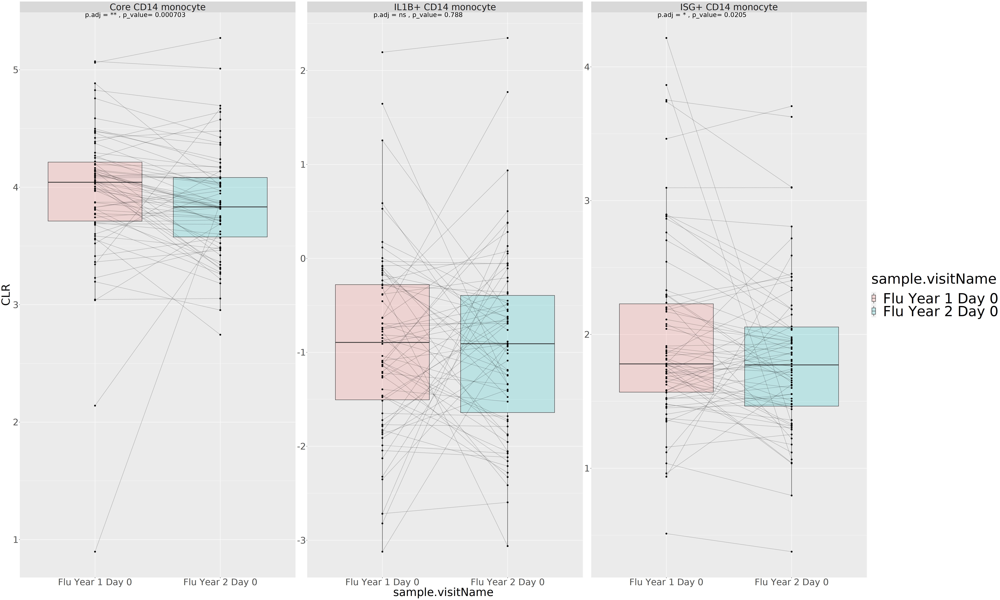

In [423]:
# Create the base plot with modified theme settings
p1 <- ggplot(filtered_data, aes(x = sample.visitName, y = AIFI_L3_clr)) + 
  geom_boxplot(aes(fill = sample.visitName), alpha = .2, ) +  # Faint gray and dotted line color
  geom_line(aes(group = subject.subjectGuid), color = "black", linetype = "dotted") + 
  geom_point(size = 2) + 
  facet_wrap(~ AIFI_L3, scales = "free", drop= FALSE) +
  theme(
    text = element_text(size = 40, color= "black"),  # Increase font size for all text elements
    axis.title = element_text(size = 40),  # Increase font size for axis titles
    legend.title = element_text(size = 50),  # Increase font size for legend title
    legend.text = element_text(size = 50)  # Increase font size for legend text
  ) + labs(y = "CLR")

# Add p-values to the plot
options(repr.plot.width = 50, repr.plot.height = 30)
p1 + geom_text(data = STAT_res, aes(label = paste("p.adj =", p.adj.signif, ", p_value=", p)),  
              x = 1, y = Inf, hjust = 0.1, vjust = 1, size = 8, color = "black") #+ ggtitle("BR1- Whole PBMC (Percentage)") + theme(plot.title = element_text(size = 35, hjust = 0.5, face = "bold"))  # Centered and larger p-value text



# Paired Flu Y1D0 vs Y2D0- no split

In [294]:
meta_data_subset<-meta_data %>% filter(Covid_exclusion=='no',
                                       sample.visitName%in% c('Flu Year 1 Day 0',
                                                               'Flu Year 2 Day 0'),
                                      sample.daysSinceFirstVisit<600)

In [295]:
file_list<-paste0("/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/scRNA/BRI/Average_LogNormalized_Expression/Average_LogNormalized_Expression_of_Celltypes_by_Sample_AIFI_L3/", meta_data_subset$pbmc_sample_id, ".csv")

In [296]:
df_list<-read_pesudobulk_expression(file_list, mc_cores = 60) #. reating pseudobulk object

[1] "Total reading time: 23.9100000000035 seconds"


In [297]:
# Define the genes of interest
genes_of_interest <- c('G0S2', 'NR4A1', 'PTGS2', 'BCL2A1', 'METRNL' ,'RASGEF1B', 'NLRP3', 'RIPK2', 'RABL6', 'CMTM6', 'SGK1', 'SELENOK', 'MIDN', 'OAZ1')
length(genes_of_interest)

# Filter the data for the genes of interest and the cell type
long_format <- filter_genes_and_celltype(df_list, 
                                         genes_of_interest, 
                                         "IL1B+ CD14 monocyte", 
                                         longformat = TRUE)

# Merge with the metadata subset
long_format <- left_join(long_format, meta_data_subset, by = "pbmc_sample_id")

# Mutate the data to add AgeGroup based on cohort.cohortGuid
long_format <- long_format %>% 
  mutate(AgeGroup = case_when(cohort.cohortGuid == "BR1" ~ "Young", TRUE ~ 'Older'))

long_format <- long_format %>%
  group_by(Gene) %>%
  mutate(Z_score_Mean_Expression = scale(Mean_Expression)) %>%
  ungroup()

[1] 14

In [298]:
colnames(long_format)
#head(long_format)

[1] "Gene"                                     
 [2] "Samples"                                  
 [3] "Mean_Expression"                          
 [4] "pbmc_sample_id"                           
 [5] "celltype"                                 
 [6] "X"                                        
 [7] "Unnamed..0"                               
 [8] "lastUpdated"                              
 [9] "sample.id"                                
[10] "sample.bridgingControl"                   
[11] "sample.sampleKitGuid"                     
[12] "sample.visitName"                         
[13] "sample.visitDetails"                      
[14] "sample.drawDate"                          
[15] "sample.daysSinceFirstVisit"               
[16] "file.id"                                  
[17] "file.name"                                
[18] "file.batchID"                             
[19] "file.panel"                               
[20] "file.pool"                                
[21] "file.fileType"                            
[22] "file.majorVersion"                        
[23] "subject.id"                               
[24] "subject.biologicalSex"                    
[25] "subject.birthYear"                        
[26] "subject.ethnicity"                        
[27] "subject.partnerCode"                      
[28] "subject.race"                             
[29] "subject.subjectGuid"                      
[30] "cohort.cohortGuid"                        
[31] "sample.diseaseStatesRecordedAtVisit"      
[32] "subject.covidVaxDose1.daysSinceFirstVisit"
[33] "subject.covidVaxDose2.daysSinceFirstVisit"
[34] "Covid_exclusion"                          
[35] "subjectGuid"                              
[36] "CMV"                                      
[37] "Ages"                                     
[38] "AgeGroup"                                 
[39] "Z_score_Mean_Expression"

In [299]:
# Check unique combinations of AIFI_L3 and sample.visitName
long_format %>%
  group_by(Gene, sample.visitName) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'Gene'. You can override using the
`.groups` argument.


Gene,sample.visitName,n
<chr>,<chr>,<int>
BCL2A1,Flu Year 1 Day 0,92
BCL2A1,Flu Year 2 Day 0,70
CMTM6,Flu Year 1 Day 0,92
CMTM6,Flu Year 2 Day 0,70
G0S2,Flu Year 1 Day 0,92
G0S2,Flu Year 2 Day 0,70
METRNL,Flu Year 1 Day 0,92
METRNL,Flu Year 2 Day 0,70
MIDN,Flu Year 1 Day 0,92


In [300]:
filtered_data <- long_format %>%
  group_by(Gene,subject.subjectGuid) %>%
  filter(all(c("Flu Year 1 Day 0", "Flu Year 2 Day 0") %in% sample.visitName))
head(filtered_data)

Gene,Samples,Mean_Expression,pbmc_sample_id,celltype,X,Unnamed..0,lastUpdated,sample.id,sample.bridgingControl,⋯,cohort.cohortGuid,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages,AgeGroup,Z_score_Mean_Expression
<chr>,<fct>,<dbl>,<chr>,<chr>,<int>,<int>,<chr>,<chr>,<chr>,⋯,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<chr>,"<dbl[,1]>"
G0S2,PB00002-01:IL1B+ CD14 monocyte,0.96725026,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,1.1321021
NR4A1,PB00002-01:IL1B+ CD14 monocyte,0.07381296,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-1.2362180
PTGS2,PB00002-01:IL1B+ CD14 monocyte,0.22664239,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-0.8797125
BCL2A1,PB00002-01:IL1B+ CD14 monocyte,0.76844798,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-0.8387921
METRNL,PB00002-01:IL1B+ CD14 monocyte,0.33505264,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-1.1383226
RASGEF1B,PB00002-01:IL1B+ CD14 monocyte,0.17257819,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-0.9795888


In [301]:
# Check unique combinations of AIFI_L3 and sample.visitName
filtered_data %>%
  group_by(Gene, sample.visitName) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'Gene'. You can override using the
`.groups` argument.


Gene,sample.visitName,n
<chr>,<chr>,<int>
BCL2A1,Flu Year 1 Day 0,70
BCL2A1,Flu Year 2 Day 0,70
CMTM6,Flu Year 1 Day 0,70
CMTM6,Flu Year 2 Day 0,70
G0S2,Flu Year 1 Day 0,70
G0S2,Flu Year 2 Day 0,70
METRNL,Flu Year 1 Day 0,70
METRNL,Flu Year 2 Day 0,70
MIDN,Flu Year 1 Day 0,70


In [302]:
STAT_res<-filtered_data %>%
  select(Mean_Expression ,AgeGroup, celltype, Z_score_Mean_Expression, sample.visitName, Gene ) %>%
  group_by(Gene) %>% 
  wilcox_test(Mean_Expression ~ sample.visitName, paired= TRUE) %>%
  adjust_pvalue(method='BH') %>%
  add_significance() %>%
  add_xy_position(x = "Gene", fun = "max")
head(STAT_res)

Adding missing grouping variables: `subject.subjectGuid`


Gene   .y.             group1           group2           n1 n2 statistic
1 BCL2A1 Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 70 70 1395     
2 CMTM6  Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 70 70 1479     
3 G0S2   Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 70 70  867     
4 METRNL Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 70 70 1237     
5 MIDN   Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 70 70 1373     
6 NLRP3  Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 70 70 1400     
  p      p.adj     p.adj.signif y.position groups           <NA>            
1 0.3740 0.5798333 ns           2.3966     Flu Year 1 Day 0 Flu Year 1 Day 0
2 0.1670 0.5798333 ns           2.3366     Flu Year 2 Day 0 Flu Year 2 Day 0
3 0.0282 0.1974000 ns           2.2076     Flu Year 1 Day 0 Flu Year 1 Day 0
4 0.9770 0.9770000 ns           1.6026     Flu Year 2 Day 0 Flu Year 2 Day 0
5 0.4470 0.5798333 ns           1.7296     Flu Year 1 Day 0 Flu Year 1 Day 0
6 0.3580 0.5798333 ns           1.2616     Flu Year 2 Day 0 Flu Year 2 Day 0
  <NA>             <NA>             <NA>             <NA>             x xmin
1 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 1 0.8 
2 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 2 1.8 
3 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 3 2.8 
4 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 4 3.8 
5 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 5 4.8 
6 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 6 5.8 
  xmax
1 1.2 
2 2.2 
3 3.2 
4 4.2 
5 5.2 
6 6.2

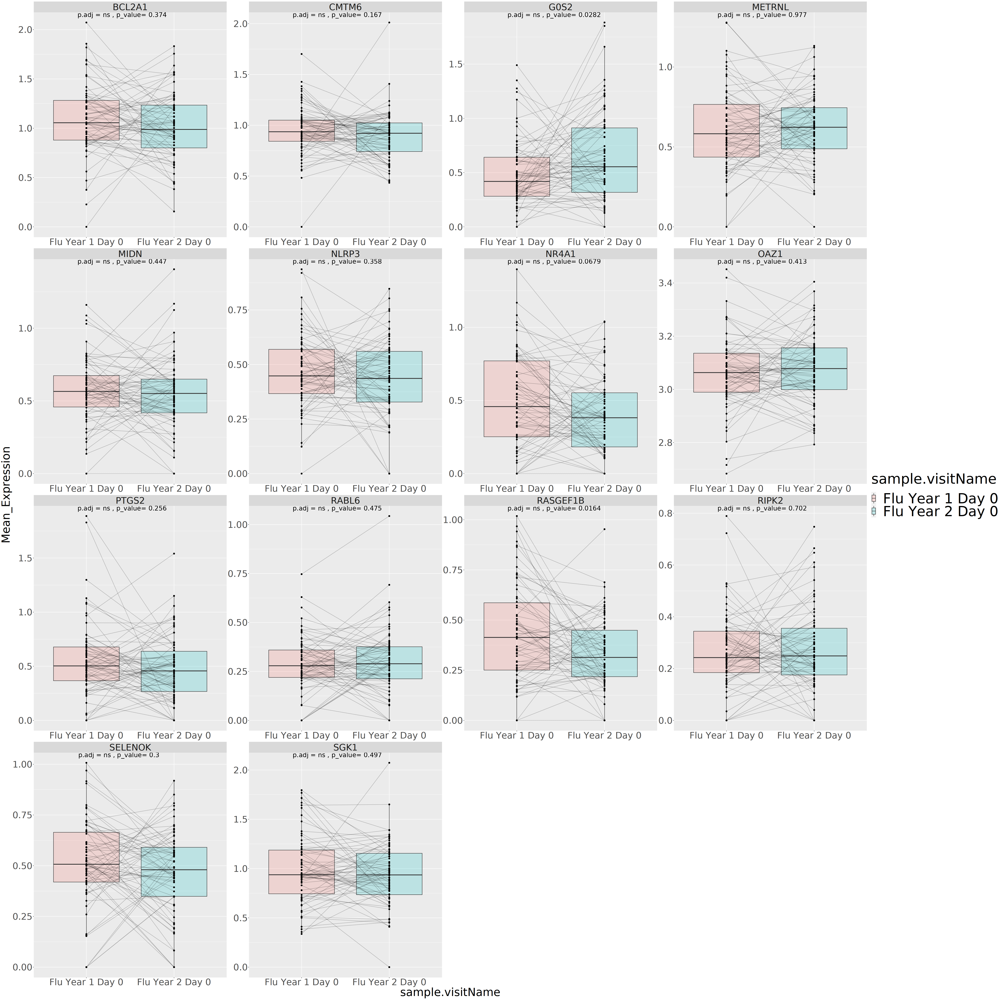

In [305]:
# Create the base plot with modified theme settings
p1 <- ggplot(filtered_data, aes(x = sample.visitName, y = Mean_Expression)) + 
  geom_boxplot(aes(fill = sample.visitName), alpha = .2, ) +  # Faint gray and dotted line color
  geom_line(aes(group = subject.subjectGuid), color = "black", linetype = "dotted") + 
  geom_point(size = 2) + 
  facet_wrap(~ Gene, scales = "free", drop= FALSE) +
  theme(
    text = element_text(size = 40, color= "black"),  # Increase font size for all text elements
    axis.title = element_text(size = 40),  # Increase font size for axis titles
    legend.title = element_text(size = 50),  # Increase font size for legend title
    legend.text = element_text(size = 50)  # Increase font size for legend text
  ) + labs(y = "Mean_Expression")

# Add p-values to the plot
options(repr.plot.width = 50, repr.plot.height = 50)
p1 + geom_text(data = STAT_res, aes(label = paste("p.adj =", p.adj.signif, ", p_value=", p)),  
              x = 1, y = Inf, hjust = 0.1, vjust = 1, size = 8, color = "black") #+ ggtitle("BR1- Whole PBMC (Percentage)") + theme(plot.title = element_text(size = 35, hjust = 0.5, face = "bold"))  # Centered and larger p-value text



# Paired Flu Y1D0 vs Y2D0- Female

In [306]:
meta_data_subset<-meta_data %>% filter(Covid_exclusion=='no',
                                       sample.visitName%in% c('Flu Year 1 Day 0',
                                                               'Flu Year 2 Day 0'),
                                      sample.daysSinceFirstVisit<600,
                                      subject.biologicalSex == "Female")

In [307]:
file_list<-paste0("/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/scRNA/BRI/Average_LogNormalized_Expression/Average_LogNormalized_Expression_of_Celltypes_by_Sample_AIFI_L3/", meta_data_subset$pbmc_sample_id, ".csv")

In [308]:
df_list<-read_pesudobulk_expression(file_list, mc_cores = 60) #. reating pseudobulk object

[1] "Total reading time: 19.6180000000022 seconds"


In [309]:
# Define the genes of interest
genes_of_interest <- c('G0S2', 'NR4A1', 'PTGS2', 'BCL2A1', 'METRNL' ,'RASGEF1B', 'NLRP3', 'RIPK2', 'RABL6', 'CMTM6', 'SGK1', 'SELENOK', 'MIDN', 'OAZ1')
length(genes_of_interest)

# Filter the data for the genes of interest and the cell type
long_format <- filter_genes_and_celltype(df_list, 
                                         genes_of_interest, 
                                         "IL1B+ CD14 monocyte", 
                                         longformat = TRUE)

# Merge with the metadata subset
long_format <- left_join(long_format, meta_data_subset, by = "pbmc_sample_id")

# Mutate the data to add AgeGroup based on cohort.cohortGuid
long_format <- long_format %>% 
  mutate(AgeGroup = case_when(cohort.cohortGuid == "BR1" ~ "Young", TRUE ~ 'Older'))

long_format <- long_format %>%
  group_by(Gene) %>%
  mutate(Z_score_Mean_Expression = scale(Mean_Expression)) %>%
  ungroup()

[1] 14

In [310]:
colnames(long_format)
#head(long_format)

[1] "Gene"                                     
 [2] "Samples"                                  
 [3] "Mean_Expression"                          
 [4] "pbmc_sample_id"                           
 [5] "celltype"                                 
 [6] "X"                                        
 [7] "Unnamed..0"                               
 [8] "lastUpdated"                              
 [9] "sample.id"                                
[10] "sample.bridgingControl"                   
[11] "sample.sampleKitGuid"                     
[12] "sample.visitName"                         
[13] "sample.visitDetails"                      
[14] "sample.drawDate"                          
[15] "sample.daysSinceFirstVisit"               
[16] "file.id"                                  
[17] "file.name"                                
[18] "file.batchID"                             
[19] "file.panel"                               
[20] "file.pool"                                
[21] "file.fileType"                            
[22] "file.majorVersion"                        
[23] "subject.id"                               
[24] "subject.biologicalSex"                    
[25] "subject.birthYear"                        
[26] "subject.ethnicity"                        
[27] "subject.partnerCode"                      
[28] "subject.race"                             
[29] "subject.subjectGuid"                      
[30] "cohort.cohortGuid"                        
[31] "sample.diseaseStatesRecordedAtVisit"      
[32] "subject.covidVaxDose1.daysSinceFirstVisit"
[33] "subject.covidVaxDose2.daysSinceFirstVisit"
[34] "Covid_exclusion"                          
[35] "subjectGuid"                              
[36] "CMV"                                      
[37] "Ages"                                     
[38] "AgeGroup"                                 
[39] "Z_score_Mean_Expression"

In [311]:
filtered_data <- long_format %>%
  group_by(Gene,subject.subjectGuid) %>%
  filter(all(c("Flu Year 1 Day 0", "Flu Year 2 Day 0") %in% sample.visitName))
head(filtered_data)

Gene,Samples,Mean_Expression,pbmc_sample_id,celltype,X,Unnamed..0,lastUpdated,sample.id,sample.bridgingControl,⋯,cohort.cohortGuid,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages,AgeGroup,Z_score_Mean_Expression
<chr>,<fct>,<dbl>,<chr>,<chr>,<int>,<int>,<chr>,<chr>,<chr>,⋯,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<chr>,"<dbl[,1]>"
G0S2,PB00003-01:IL1B+ CD14 monocyte,0.30764092,PB00003-01,IL1B+ CD14 monocyte,2,3,2024-05-10T17:12:44.959Z,2db6fb3f-e3f4-454b-891b-9b068541b51d,False,⋯,BR1,NA,440,461,no,BR1003,Negative,30,Young,-0.5775568
NR4A1,PB00003-01:IL1B+ CD14 monocyte,0.41565199,PB00003-01,IL1B+ CD14 monocyte,2,3,2024-05-10T17:12:44.959Z,2db6fb3f-e3f4-454b-891b-9b068541b51d,False,⋯,BR1,NA,440,461,no,BR1003,Negative,30,Young,-0.2380208
PTGS2,PB00003-01:IL1B+ CD14 monocyte,0.06349906,PB00003-01,IL1B+ CD14 monocyte,2,3,2024-05-10T17:12:44.959Z,2db6fb3f-e3f4-454b-891b-9b068541b51d,False,⋯,BR1,NA,440,461,no,BR1003,Negative,30,Young,-1.5868734
BCL2A1,PB00003-01:IL1B+ CD14 monocyte,0.96322671,PB00003-01,IL1B+ CD14 monocyte,2,3,2024-05-10T17:12:44.959Z,2db6fb3f-e3f4-454b-891b-9b068541b51d,False,⋯,BR1,NA,440,461,no,BR1003,Negative,30,Young,-0.3931738
METRNL,PB00003-01:IL1B+ CD14 monocyte,0.19486058,PB00003-01,IL1B+ CD14 monocyte,2,3,2024-05-10T17:12:44.959Z,2db6fb3f-e3f4-454b-891b-9b068541b51d,False,⋯,BR1,NA,440,461,no,BR1003,Negative,30,Young,-1.7002815
RASGEF1B,PB00003-01:IL1B+ CD14 monocyte,0.52562680,PB00003-01,IL1B+ CD14 monocyte,2,3,2024-05-10T17:12:44.959Z,2db6fb3f-e3f4-454b-891b-9b068541b51d,False,⋯,BR1,NA,440,461,no,BR1003,Negative,30,Young,0.4462463


In [312]:
# Check unique combinations of AIFI_L3 and sample.visitName
filtered_data %>%
  group_by(Gene, sample.visitName) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'Gene'. You can override using the
`.groups` argument.


Gene,sample.visitName,n
<chr>,<chr>,<int>
BCL2A1,Flu Year 1 Day 0,37
BCL2A1,Flu Year 2 Day 0,37
CMTM6,Flu Year 1 Day 0,37
CMTM6,Flu Year 2 Day 0,37
G0S2,Flu Year 1 Day 0,37
G0S2,Flu Year 2 Day 0,37
METRNL,Flu Year 1 Day 0,37
METRNL,Flu Year 2 Day 0,37
MIDN,Flu Year 1 Day 0,37


In [313]:
STAT_res<-filtered_data %>%
  select(Mean_Expression ,AgeGroup, celltype, Z_score_Mean_Expression, sample.visitName, Gene ) %>%
  group_by(Gene) %>% 
  wilcox_test(Mean_Expression ~ sample.visitName, paired= TRUE) %>%
  adjust_pvalue(method='BH') %>%
  add_significance() %>%
  add_xy_position(x = "Gene", fun = "max")
head(STAT_res)

Adding missing grouping variables: `subject.subjectGuid`


Gene   .y.             group1           group2           n1 n2 statistic
1 BCL2A1 Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 37 37 446      
2 CMTM6  Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 37 37 390      
3 G0S2   Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 37 37 234      
4 METRNL Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 37 37 360      
5 MIDN   Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 37 37 343      
6 NLRP3  Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 37 37 408      
  p     p.adj     p.adj.signif y.position groups           <NA>            
1 0.158 0.6416667 ns           2.1566     Flu Year 1 Day 0 Flu Year 1 Day 0
2 0.571 0.7267273 ns           1.7326     Flu Year 2 Day 0 Flu Year 2 Day 0
3 0.122 0.6416667 ns           2.1766     Flu Year 1 Day 0 Flu Year 1 Day 0
4 0.905 0.9050000 ns           1.6026     Flu Year 2 Day 0 Flu Year 2 Day 0
5 0.905 0.9050000 ns           1.4926     Flu Year 1 Day 0 Flu Year 1 Day 0
6 0.403 0.6657778 ns           1.2446     Flu Year 2 Day 0 Flu Year 2 Day 0
  <NA>             <NA>             <NA>             <NA>             x xmin
1 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 1 0.8 
2 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 2 1.8 
3 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 3 2.8 
4 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 4 3.8 
5 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 5 4.8 
6 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 6 5.8 
  xmax
1 1.2 
2 2.2 
3 3.2 
4 4.2 
5 5.2 
6 6.2

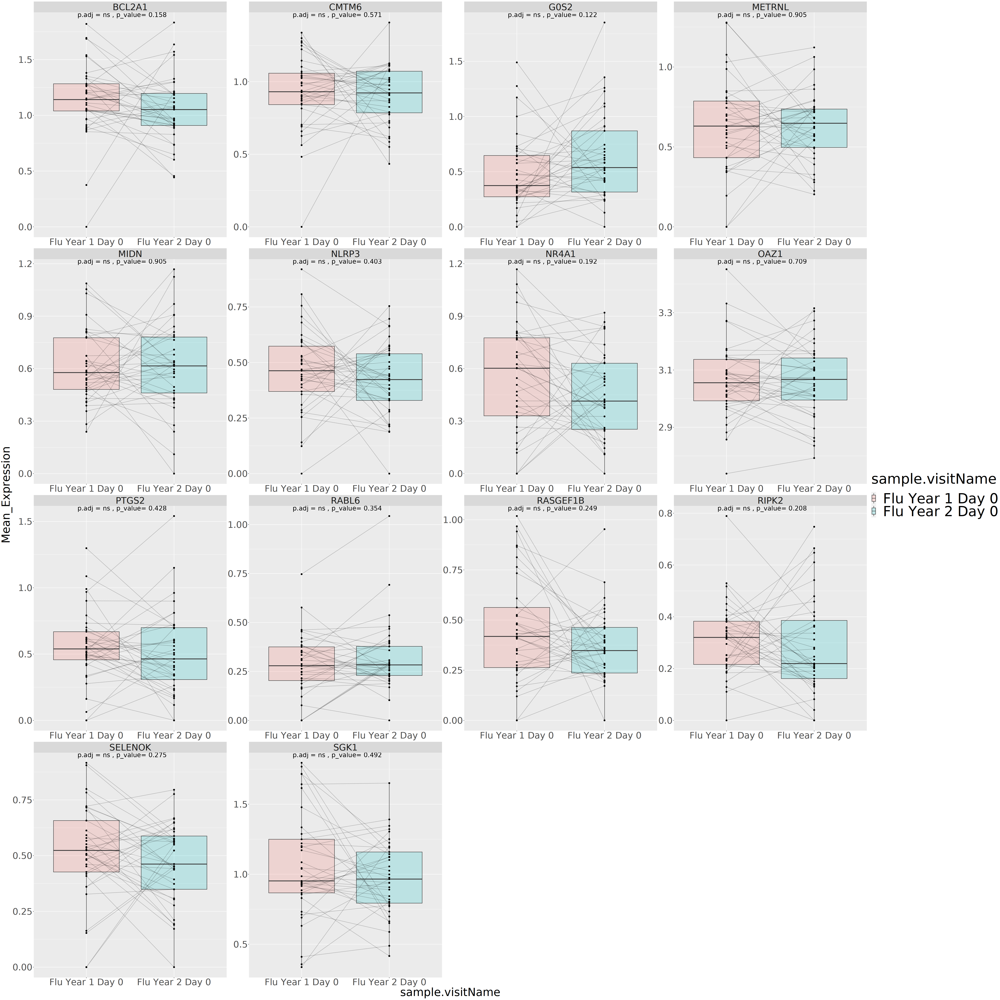

In [314]:
# Create the base plot with modified theme settings
p1 <- ggplot(filtered_data, aes(x = sample.visitName, y = Mean_Expression)) + 
  geom_boxplot(aes(fill = sample.visitName), alpha = .2, ) +  # Faint gray and dotted line color
  geom_line(aes(group = subject.subjectGuid), color = "black", linetype = "dotted") + 
  geom_point(size = 2) + 
  facet_wrap(~ Gene, scales = "free", drop= FALSE) +
  theme(
    text = element_text(size = 40, color= "black"),  # Increase font size for all text elements
    axis.title = element_text(size = 40),  # Increase font size for axis titles
    legend.title = element_text(size = 50),  # Increase font size for legend title
    legend.text = element_text(size = 50)  # Increase font size for legend text
  ) + labs(y = "Mean_Expression")

# Add p-values to the plot
options(repr.plot.width = 50, repr.plot.height = 50)
p1 + geom_text(data = STAT_res, aes(label = paste("p.adj =", p.adj.signif, ", p_value=", p)),  
              x = 1, y = Inf, hjust = 0.1, vjust = 1, size = 8, color = "black") #+ ggtitle("BR1- Whole PBMC (Percentage)") + theme(plot.title = element_text(size = 35, hjust = 0.5, face = "bold"))  # Centered and larger p-value text



# Paired Flu Y1D0 vs Y2D0- Male

In [315]:
meta_data_subset<-meta_data %>% filter(Covid_exclusion=='no',
                                       sample.visitName%in% c('Flu Year 1 Day 0',
                                                               'Flu Year 2 Day 0'),
                                      sample.daysSinceFirstVisit<600,
                                      subject.biologicalSex == "Male")

In [316]:
file_list<-paste0("/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/scRNA/BRI/Average_LogNormalized_Expression/Average_LogNormalized_Expression_of_Celltypes_by_Sample_AIFI_L3/", meta_data_subset$pbmc_sample_id, ".csv")

In [317]:
df_list<-read_pesudobulk_expression(file_list, mc_cores = 60) #. reating pseudobulk object

[1] "Total reading time: 19.198000000004 seconds"


In [318]:
# Define the genes of interest
genes_of_interest <- c('G0S2', 'NR4A1', 'PTGS2', 'BCL2A1', 'METRNL' ,'RASGEF1B', 'NLRP3', 'RIPK2', 'RABL6', 'CMTM6', 'SGK1', 'SELENOK', 'MIDN', 'OAZ1')
length(genes_of_interest)

# Filter the data for the genes of interest and the cell type
long_format <- filter_genes_and_celltype(df_list, 
                                         genes_of_interest, 
                                         "IL1B+ CD14 monocyte", 
                                         longformat = TRUE)

# Merge with the metadata subset
long_format <- left_join(long_format, meta_data_subset, by = "pbmc_sample_id")

# Mutate the data to add AgeGroup based on cohort.cohortGuid
long_format <- long_format %>% 
  mutate(AgeGroup = case_when(cohort.cohortGuid == "BR1" ~ "Young", TRUE ~ 'Older'))

long_format <- long_format %>%
  group_by(Gene) %>%
  mutate(Z_score_Mean_Expression = scale(Mean_Expression)) %>%
  ungroup()

[1] 14

In [319]:
colnames(long_format)
#head(long_format)
unique(long_format$subject.biologicalSex)

[1] "Gene"                                     
 [2] "Samples"                                  
 [3] "Mean_Expression"                          
 [4] "pbmc_sample_id"                           
 [5] "celltype"                                 
 [6] "X"                                        
 [7] "Unnamed..0"                               
 [8] "lastUpdated"                              
 [9] "sample.id"                                
[10] "sample.bridgingControl"                   
[11] "sample.sampleKitGuid"                     
[12] "sample.visitName"                         
[13] "sample.visitDetails"                      
[14] "sample.drawDate"                          
[15] "sample.daysSinceFirstVisit"               
[16] "file.id"                                  
[17] "file.name"                                
[18] "file.batchID"                             
[19] "file.panel"                               
[20] "file.pool"                                
[21] "file.fileType"                            
[22] "file.majorVersion"                        
[23] "subject.id"                               
[24] "subject.biologicalSex"                    
[25] "subject.birthYear"                        
[26] "subject.ethnicity"                        
[27] "subject.partnerCode"                      
[28] "subject.race"                             
[29] "subject.subjectGuid"                      
[30] "cohort.cohortGuid"                        
[31] "sample.diseaseStatesRecordedAtVisit"      
[32] "subject.covidVaxDose1.daysSinceFirstVisit"
[33] "subject.covidVaxDose2.daysSinceFirstVisit"
[34] "Covid_exclusion"                          
[35] "subjectGuid"                              
[36] "CMV"                                      
[37] "Ages"                                     
[38] "AgeGroup"                                 
[39] "Z_score_Mean_Expression"

[1] "Male"

In [320]:
# Check unique combinations of AIFI_L3 and sample.visitName
long_format %>%
  group_by(Gene, sample.visitName) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'Gene'. You can override using the
`.groups` argument.


Gene,sample.visitName,n
<chr>,<chr>,<int>
BCL2A1,Flu Year 1 Day 0,41
BCL2A1,Flu Year 2 Day 0,33
CMTM6,Flu Year 1 Day 0,41
CMTM6,Flu Year 2 Day 0,33
G0S2,Flu Year 1 Day 0,41
G0S2,Flu Year 2 Day 0,33
METRNL,Flu Year 1 Day 0,41
METRNL,Flu Year 2 Day 0,33
MIDN,Flu Year 1 Day 0,41


In [321]:
filtered_data <- long_format %>%
  group_by(Gene,subject.subjectGuid) %>%
  filter(all(c("Flu Year 1 Day 0", "Flu Year 2 Day 0") %in% sample.visitName))
head(filtered_data)

Gene,Samples,Mean_Expression,pbmc_sample_id,celltype,X,Unnamed..0,lastUpdated,sample.id,sample.bridgingControl,⋯,cohort.cohortGuid,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages,AgeGroup,Z_score_Mean_Expression
<chr>,<fct>,<dbl>,<chr>,<chr>,<int>,<int>,<chr>,<chr>,<chr>,⋯,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<chr>,"<dbl[,1]>"
G0S2,PB00002-01:IL1B+ CD14 monocyte,0.96725026,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,1.0293509
NR4A1,PB00002-01:IL1B+ CD14 monocyte,0.07381296,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-1.0845657
PTGS2,PB00002-01:IL1B+ CD14 monocyte,0.22664239,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-0.7447097
BCL2A1,PB00002-01:IL1B+ CD14 monocyte,0.76844798,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-0.6739795
METRNL,PB00002-01:IL1B+ CD14 monocyte,0.33505264,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-1.1367358
RASGEF1B,PB00002-01:IL1B+ CD14 monocyte,0.17257819,PB00002-01,IL1B+ CD14 monocyte,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Young,-0.8780420


In [322]:
# Check unique combinations of AIFI_L3 and sample.visitName
filtered_data %>%
  group_by(Gene, sample.visitName) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'Gene'. You can override using the
`.groups` argument.


Gene,sample.visitName,n
<chr>,<chr>,<int>
BCL2A1,Flu Year 1 Day 0,33
BCL2A1,Flu Year 2 Day 0,33
CMTM6,Flu Year 1 Day 0,33
CMTM6,Flu Year 2 Day 0,33
G0S2,Flu Year 1 Day 0,33
G0S2,Flu Year 2 Day 0,33
METRNL,Flu Year 1 Day 0,33
METRNL,Flu Year 2 Day 0,33
MIDN,Flu Year 1 Day 0,33


In [323]:
STAT_res<-filtered_data %>%
  select(Mean_Expression ,AgeGroup, celltype, Z_score_Mean_Expression, sample.visitName, Gene ) %>%
  group_by(Gene) %>% 
  wilcox_test(Mean_Expression ~ sample.visitName, paired= TRUE) %>%
  adjust_pvalue(method='BH') %>%
  add_significance() %>%
  add_xy_position(x = "Gene", fun = "max")
head(STAT_res)

Adding missing grouping variables: `subject.subjectGuid`


Gene   .y.             group1           group2           n1 n2 statistic
1 BCL2A1 Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 33 33 319      
2 CMTM6  Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 33 33 367      
3 G0S2   Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 33 33 201      
4 METRNL Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 33 33 246      
5 MIDN   Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 33 33 321      
6 NLRP3  Mean_Expression Flu Year 1 Day 0 Flu Year 2 Day 0 33 33 297      
  p     p.adj     p.adj.signif y.position groups           <NA>            
1 0.502 0.6974545 ns           2.41136    Flu Year 1 Day 0 Flu Year 1 Day 0
2 0.126 0.5600000 ns           2.35136    Flu Year 2 Day 0 Flu Year 2 Day 0
3 0.160 0.5600000 ns           2.22236    Flu Year 1 Day 0 Flu Year 1 Day 0
4 0.548 0.6974545 ns           1.47136    Flu Year 2 Day 0 Flu Year 2 Day 0
5 0.480 0.6974545 ns           1.74436    Flu Year 1 Day 0 Flu Year 1 Day 0
6 0.778 0.8378462 ns           1.27636    Flu Year 2 Day 0 Flu Year 2 Day 0
  <NA>             <NA>             <NA>             <NA>             x xmin
1 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 1 0.8 
2 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 2 1.8 
3 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 3 2.8 
4 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 4 3.8 
5 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 Flu Year 1 Day 0 5 4.8 
6 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 Flu Year 2 Day 0 6 5.8 
  xmax
1 1.2 
2 2.2 
3 3.2 
4 4.2 
5 5.2 
6 6.2

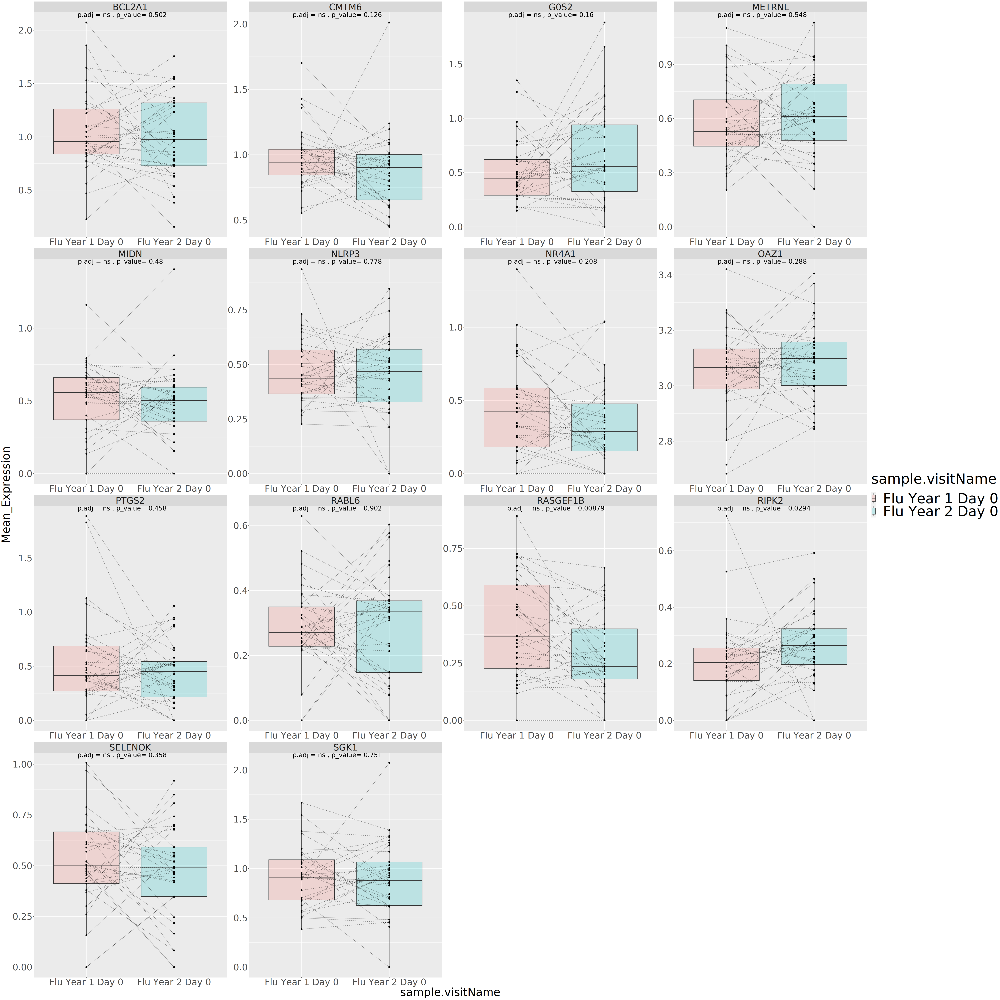

In [325]:
# Create the base plot with modified theme settings
p1 <- ggplot(filtered_data, aes(x = sample.visitName, y = Mean_Expression)) + 
  geom_boxplot(aes(fill = sample.visitName), alpha = .2, ) +  # Faint gray and dotted line color
  geom_line(aes(group = subject.subjectGuid), color = "black", linetype = "dotted") + 
  geom_point(size = 2) + 
  facet_wrap(~ Gene, scales = "free", drop= FALSE) +
  theme(
    text = element_text(size = 40, color= "black"),  # Increase font size for all text elements
    axis.title = element_text(size = 40),  # Increase font size for axis titles
    legend.title = element_text(size = 50),  # Increase font size for legend title
    legend.text = element_text(size = 50)  # Increase font size for legend text
  ) + labs(y = "Mean_Expression")

# Add p-values to the plot
options(repr.plot.width = 50, repr.plot.height = 50)
p1 + geom_text(data = STAT_res, aes(label = paste("p.adj =", p.adj.signif, ", p_value=", p)),  
              x = 1, y = Inf, hjust = 0.1, vjust = 1, size = 8, color = "black") #+ ggtitle("BR1- Whole PBMC (Percentage)") + theme(plot.title = element_text(size = 35, hjust = 0.5, face = "bold"))  # Centered and larger p-value text



# Composite score- Flu Y1D0 vs Y2D0

## Read Deseq2 Result - Female

In [807]:
meta_data_subset <- meta_data %>% 
  filter(Covid_exclusion == 'no', sample.visitName	%in% c('Flu Year 1 Day 0','Flu Year 2 Day 0'), subject.biologicalSex == "Female")


In [808]:
file_list<-paste0("/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/scRNA/BRI/Average_LogNormalized_Expression/Average_LogNormalized_Expression_of_Celltypes_by_Sample_AIFI_L3/", meta_data_subset$pbmc_sample_id, ".csv")

In [809]:
df_list<-read_pesudobulk_expression(file_list, mc_cores = 60) #. reating pseudobulk object

[1] "Total reading time: 20.7979999999952 seconds"


In [810]:
unique(meta_data_subset$sample.visitName)
unique(meta_data_subset$subject.biologicalSex)

[1] "Flu Year 1 Day 0" "Flu Year 2 Day 0"

[1] "Female"

In [811]:
deseq2_result_Y1D0<-read.csv('/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/DESEQ2/Female_Deseq2_Result_Y1D0.csv')

In [812]:
head(deseq2_result_Y1D0)

,X,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj,contrast,Direction,gene,celltype,sex
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
1,1,1.4553376,-1.58887408,0.3911621,-4.0619325,4.866815e-05,0.3688559,cohort.cohortGuid,BR1,CCDC174,ASDC,Female
2,2,0.3984625,0.41653866,0.5699233,0.7308679,4.648598e-01,0.9968973,cohort.cohortGuid,BR2,AL669831.5,ASDC,Female
3,3,1.6559504,0.25216783,0.3641720,0.6924415,4.886601e-01,0.9968973,cohort.cohortGuid,BR2,NOC2L,ASDC,Female
4,4,1.2866563,-0.97078515,0.5119361,-1.8963013,5.792021e-02,0.9968973,cohort.cohortGuid,BR1,ISG15,ASDC,Female
5,5,2.7154615,-0.05010603,0.2936791,-0.1706149,8.645266e-01,0.9968973,cohort.cohortGuid,BR1,SDF4,ASDC,Female
6,6,1.1378577,-0.29946048,0.4050389,-0.7393377,4.597020e-01,0.9968973,cohort.cohortGuid,BR1,B3GALT6,ASDC,Female


In [813]:
genes_of_interest <- c('G0S2', 'NR4A1', 'PTGS2', 'BCL2A1', 'METRNL' ,'RASGEF1B', 'NLRP3', 'RIPK2', 'RABL6', 'CMTM6', 'SGK1', 'SELENOK', 'MIDN', 'OAZ1')
length(genes_of_interest)

[1] 14

In [814]:
# filter significant genes 
# deseq2_result_Y1D0_AgeGroup_sig<-deseq2_result_Y1D0 %>% 
#   filter(contrast == "cohort.cohortGuid") %>%
#   filter(padj < 0.1, 
#          abs(log2FoldChange) > 0.1)

deseq2_result_Y1D0_AgeGroup_sig<-deseq2_result_Y1D0 %>% 
  filter(contrast == "cohort.cohortGuid") %>%
  filter(gene %in% genes_of_interest )

In [815]:
head(deseq2_result_Y1D0_AgeGroup_sig)

,X,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj,contrast,Direction,gene,celltype,sex
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
1,731,0.4279732,-0.93997276,0.5798415,-1.6210856,0.1049993,0.9968973,cohort.cohortGuid,BR1,NLRP3,ASDC,Female
2,1277,7.2630180,-0.08889577,0.1755723,-0.5063199,0.6126321,0.9968973,cohort.cohortGuid,BR1,CMTM6,ASDC,Female
3,1388,4.6694354,0.24623565,0.2057725,1.1966403,0.2314468,0.9968973,cohort.cohortGuid,BR2,SELENOK,ASDC,Female
4,1762,0.5558365,0.45810530,0.5648261,0.8110555,0.4173338,0.9968973,cohort.cohortGuid,BR2,RASGEF1B,ASDC,Female
5,3321,0.7786333,0.10087677,0.4759584,0.2119445,0.8321503,0.9968973,cohort.cohortGuid,BR2,RIPK2,ASDC,Female
6,3684,2.6920903,-0.19441886,0.2650419,-0.7335401,0.4632291,0.9968973,cohort.cohortGuid,BR1,RABL6,ASDC,Female


### Filter Genes and CellTypes

In [816]:
df_degs_counts<-as.data.frame(table(deseq2_result_Y1D0_AgeGroup_sig$celltype,deseq2_result_Y1D0_AgeGroup_sig$Direction))
head(df_degs_counts)

,Var1,Var2,Freq
,<fct>,<fct>,<int>
1,Activated memory B cell,BR1,2
2,Adaptive NK cell,BR1,2
3,ASDC,BR1,4
4,BaEoMaP cell,BR1,5
5,C1Q+ CD16 monocyte,BR1,4
6,CD14+ cDC2,BR1,6


In [817]:
celltypes <- c("IL1B+ CD14 monocyte", "Core CD14 monocyte", "ISG+ CD14 monocyte")

In [818]:
df_degs_counts_filtered<-df_degs_counts %>% arrange(Var1)  %>% filter(Var1 %in% celltypes)

In [819]:
df_degs_counts_filtered

Var1,Var2,Freq
<fct>,<fct>,<int>
Core CD14 monocyte,BR1,3
Core CD14 monocyte,BR2,7
IL1B+ CD14 monocyte,BR1,0
IL1B+ CD14 monocyte,BR2,14
ISG+ CD14 monocyte,BR1,1
ISG+ CD14 monocyte,BR2,9


### Construct Composite Score

In [820]:
score_df_list<-mclapply(unique(df_degs_counts_filtered$Var1),function(celltype_single){

top_n=100
Direction_of_DEG="BR2"
selected_genes <- deseq2_result_Y1D0_AgeGroup_sig %>%
    filter(celltype == celltype_single,Direction==Direction_of_DEG) %>% 
    arrange(padj,desc(abs(log2FoldChange))) %>% 
    slice_head(n=top_n)%>%
    select(gene) %>%
    pull()
 
long_format <- filter_genes_and_celltype(df_list, 
                                       selected_genes, 
                                       celltype_single, 
                                       longformat = TRUE)
long_format <- left_join(long_format, meta_data)
# z scored (optional)
long_format<-long_format %>% group_by(Gene) %>% 
mutate(Z_score_Mean_Expression=scale(Mean_Expression))  %>% 
                                        ungroup()
composite_score_df<-long_format%>% 
group_by(pbmc_sample_id) %>%
  dplyr::summarise(composite_score_sum_mean = sum(Mean_Expression),
                   composite_score_sum_scaled_mean = sum(Z_score_Mean_Expression)) %>% as.data.frame() 
composite_score_df<-left_join(composite_score_df,meta_data) 
composite_score_df$celltype<-celltype_single
return(composite_score_df)
},mc.cores=10)

In [821]:
composite_score_df_all<-do.call(rbind,score_df_list)

In [822]:
composite_score_df_all<-composite_score_df_all %>% mutate(AgeGroup=case_when(cohort.cohortGuid=="BR1"~"Young", TRUE~'Older'))

In [823]:
head(composite_score_df_all)
dim(composite_score_df_all)
colnames(composite_score_df_all)

,pbmc_sample_id,composite_score_sum_mean,composite_score_sum_scaled_mean,X,Unnamed..0,lastUpdated,sample.id,sample.bridgingControl,sample.sampleKitGuid,sample.visitName,⋯,cohort.cohortGuid,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages,celltype,AgeGroup
,<chr>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<fct>,<chr>
1,PB00001-01,5.199117,-6.562105,0,1,2024-05-10T17:12:44.959Z,f499ff83-e513-4d24-a10f-151348269fff,False,KT00001,Flu Year 1 Day 0,⋯,BR1,NA,NA,NA,no,BR1001,Negative,32,Core CD14 monocyte,Young
2,PB00003-01,5.353938,-5.461612,2,3,2024-05-10T17:12:44.959Z,2db6fb3f-e3f4-454b-891b-9b068541b51d,False,KT00003,Flu Year 1 Day 0,⋯,BR1,NA,440,461,no,BR1003,Negative,30,Core CD14 monocyte,Young
3,PB00006-01,5.139054,-6.258017,4,5,2024-05-10T17:12:44.959Z,eb5b3a3d-002e-40a6-aa19-aa0e6a7fff8f,False,KT00006,Flu Year 1 Day 0,⋯,BR1,NA,451,492,no,BR1005,Negative,27,Core CD14 monocyte,Young
4,PB00012-01,5.416879,-2.209978,10,11,2024-05-10T17:12:44.959Z,fb3c3406-2797-4c31-b085-37d8138099a3,False,KT00012,Flu Year 1 Day 0,⋯,BR1,NA,469,494,no,BR1008,Positive,34,Core CD14 monocyte,Young
5,PB00016-01,5.566864,1.885198,14,15,2024-05-10T17:12:44.959Z,19e5fa0e-52a8-4bef-a19a-075ad37fd5e3,False,KT00016,Flu Year 1 Day 0,⋯,BR2,NA,520,536,no,BR2002,Positive,57,Core CD14 monocyte,Older
6,PB00022-01,5.454997,-2.197886,20,21,2024-05-10T17:12:44.959Z,dedcaa14-0aa3-403b-9e13-475e715f0d69,False,KT00022,Flu Year 1 Day 0,⋯,BR1,NA,491,519,no,BR1010,Positive,29,Core CD14 monocyte,Young


[1] 300  37

[1] "pbmc_sample_id"                           
 [2] "composite_score_sum_mean"                 
 [3] "composite_score_sum_scaled_mean"          
 [4] "X"                                        
 [5] "Unnamed..0"                               
 [6] "lastUpdated"                              
 [7] "sample.id"                                
 [8] "sample.bridgingControl"                   
 [9] "sample.sampleKitGuid"                     
[10] "sample.visitName"                         
[11] "sample.visitDetails"                      
[12] "sample.drawDate"                          
[13] "sample.daysSinceFirstVisit"               
[14] "file.id"                                  
[15] "file.name"                                
[16] "file.batchID"                             
[17] "file.panel"                               
[18] "file.pool"                                
[19] "file.fileType"                            
[20] "file.majorVersion"                        
[21] "subject.id"                               
[22] "subject.biologicalSex"                    
[23] "subject.birthYear"                        
[24] "subject.ethnicity"                        
[25] "subject.partnerCode"                      
[26] "subject.race"                             
[27] "subject.subjectGuid"                      
[28] "cohort.cohortGuid"                        
[29] "sample.diseaseStatesRecordedAtVisit"      
[30] "subject.covidVaxDose1.daysSinceFirstVisit"
[31] "subject.covidVaxDose2.daysSinceFirstVisit"
[32] "Covid_exclusion"                          
[33] "subjectGuid"                              
[34] "CMV"                                      
[35] "Ages"                                     
[36] "celltype"                                 
[37] "AgeGroup"

### Stat_test and legend max scaling- Sum_Mean

In [824]:
# Check unique combinations of AIFI_L3 and sample.visitName
composite_score_df_all %>%
  group_by(celltype, sample.visitName) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.


celltype,sample.visitName,n
<fct>,<chr>,<int>
Core CD14 monocyte,Flu Year 1 Day 0,51
Core CD14 monocyte,Flu Year 2 Day 0,49
IL1B+ CD14 monocyte,Flu Year 1 Day 0,51
IL1B+ CD14 monocyte,Flu Year 2 Day 0,49
ISG+ CD14 monocyte,Flu Year 1 Day 0,51
ISG+ CD14 monocyte,Flu Year 2 Day 0,49


In [825]:
filtered_data <- composite_score_df_all %>%
  group_by(celltype,subject.subjectGuid) %>%
  filter(all(c("Flu Year 1 Day 0", "Flu Year 2 Day 0") %in% sample.visitName))
head(filtered_data)

pbmc_sample_id,composite_score_sum_mean,composite_score_sum_scaled_mean,X,Unnamed..0,lastUpdated,sample.id,sample.bridgingControl,sample.sampleKitGuid,sample.visitName,⋯,cohort.cohortGuid,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages,celltype,AgeGroup
<chr>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<fct>,<chr>
PB00003-01,5.353938,-5.461612,2,3,2024-05-10T17:12:44.959Z,2db6fb3f-e3f4-454b-891b-9b068541b51d,False,KT00003,Flu Year 1 Day 0,⋯,BR1,NA,440,461,no,BR1003,Negative,30,Core CD14 monocyte,Young
PB00006-01,5.139054,-6.258017,4,5,2024-05-10T17:12:44.959Z,eb5b3a3d-002e-40a6-aa19-aa0e6a7fff8f,False,KT00006,Flu Year 1 Day 0,⋯,BR1,NA,451,492,no,BR1005,Negative,27,Core CD14 monocyte,Young
PB00012-01,5.416879,-2.209978,10,11,2024-05-10T17:12:44.959Z,fb3c3406-2797-4c31-b085-37d8138099a3,False,KT00012,Flu Year 1 Day 0,⋯,BR1,NA,469,494,no,BR1008,Positive,34,Core CD14 monocyte,Young
PB00016-01,5.566864,1.885198,14,15,2024-05-10T17:12:44.959Z,19e5fa0e-52a8-4bef-a19a-075ad37fd5e3,False,KT00016,Flu Year 1 Day 0,⋯,BR2,NA,520,536,no,BR2002,Positive,57,Core CD14 monocyte,Older
PB00022-01,5.454997,-2.197886,20,21,2024-05-10T17:12:44.959Z,dedcaa14-0aa3-403b-9e13-475e715f0d69,False,KT00022,Flu Year 1 Day 0,⋯,BR1,NA,491,519,no,BR1010,Positive,29,Core CD14 monocyte,Young
PB00023-05,5.275676,-4.419439,21,22,2024-05-10T17:12:44.959Z,70146ae1-7568-4d58-9744-ae42cdf3af5a,False,KT00023,Flu Year 1 Day 0,⋯,BR1,NA,502,524,no,BR1009,Negative,26,Core CD14 monocyte,Young


In [826]:
# Check unique combinations of AIFI_L3 and sample.visitName
filtered_data %>%
  group_by(celltype, sample.visitName) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.


celltype,sample.visitName,n
<fct>,<chr>,<int>
Core CD14 monocyte,Flu Year 1 Day 0,49
Core CD14 monocyte,Flu Year 2 Day 0,49
IL1B+ CD14 monocyte,Flu Year 1 Day 0,49
IL1B+ CD14 monocyte,Flu Year 2 Day 0,49
ISG+ CD14 monocyte,Flu Year 1 Day 0,49
ISG+ CD14 monocyte,Flu Year 2 Day 0,49


In [827]:
# colnames(filtered_data)
# filtered_data%>% select(subject.subjectGuid,cohort.cohortGuid,pbmc_sample_id,sample.visitName, AIFI_L3, AIFI_L3_clr) %>% group_by(sample.visitName, AIFI_L3)

In [828]:
STAT_res<-filtered_data %>%
  arrange(subject.subjectGuid) %>%
  select( celltype, sample.visitName, composite_score_sum_mean, AgeGroup ) %>%
  group_by(celltype) %>% 
#wilcox_test(as.formula("AIFI_L3_clr ~ sample.visitName"), paired = TRUE) %>%
  wilcox_test(composite_score_sum_mean ~ AgeGroup) %>%
  adjust_pvalue(method='BH') %>%
  add_significance() #%>%
  #add_xy_position(x = "celltype", fun = "max")
STAT_res

Adding missing grouping variables: `subject.subjectGuid`


celltype,.y.,group1,group2,n1,n2,statistic,p,p.adj,p.adj.signif
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>
Core CD14 monocyte,composite_score_sum_mean,Older,Young,50,48,1428,1.06e-01,1.590e-01,ns
IL1B+ CD14 monocyte,composite_score_sum_mean,Older,Young,50,48,1834,6.73e-06,2.019e-05,****
ISG+ CD14 monocyte,composite_score_sum_mean,Older,Young,50,48,1365,2.42e-01,2.420e-01,ns


In [829]:
STAT_res$p.adj <- formatC(STAT_res$p.adj, format = "e", digits = 2)

In [830]:
max_y<-filtered_data %>%
  select(composite_score_sum_mean,sample.visitName, celltype) %>%
  group_by(celltype) %>%
  dplyr::summarize(max_composite_score_sum_mean = max(composite_score_sum_mean)) %>%
  ungroup()%>%select(max_composite_score_sum_mean) %>% pull()

Adding missing grouping variables: `subject.subjectGuid`


In [831]:
STAT_res$max_y<-max_y*1.05

Warning message in max(lengths(data)):
“no non-missing arguments to max; returning -Inf”
`geom_smooth()` using formula = 'y ~ x'


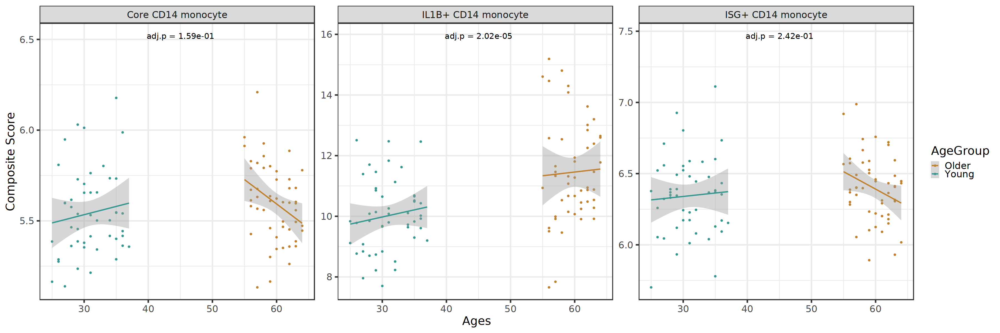

In [832]:
options(repr.plot.width = 30, repr.plot.height = 10)

p <- ggplot(filtered_data,
       aes(Ages, composite_score_sum_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype,ncol=4,scale = 'free')+
  expand_limits() 

#Manually add p-value annotations
p <- p + geom_text(data = STAT_res,
                   aes(x = 45, y = max_y, label = paste("adj.p =", p.adj)),
                   size = 6,
                   inherit.aes = FALSE)

p



`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.
`geom_smooth()` using formula = 'y ~ x'


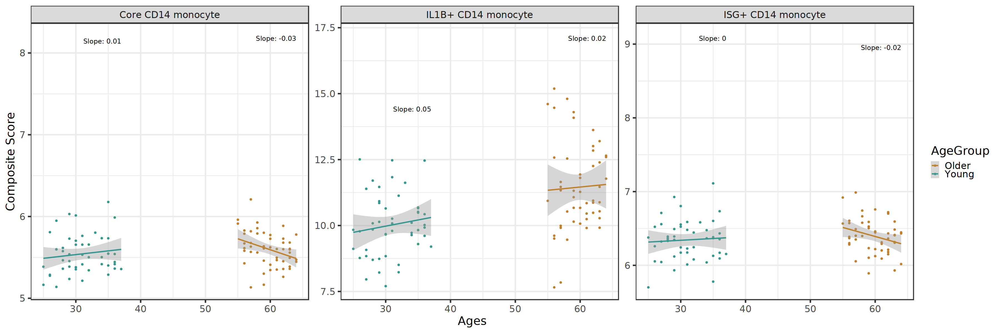

In [833]:

options(repr.plot.width = 30, repr.plot.height = 10)


p <- ggplot(filtered_data,
       aes(Ages, composite_score_sum_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype, scale = 'free')

slopes <- filtered_data %>%
  group_by(celltype, AgeGroup) %>%
  do(model = lm(composite_score_sum_mean ~ Ages, data = .)) %>%
  summarize(celltype = first(celltype),
            AgeGroup = first(AgeGroup),
            slope = coef(model)[["Ages"]],
            intercept = coef(model)[["(Intercept)"]])

max_values <- filtered_data %>%
  group_by(celltype, AgeGroup) %>%
  summarize(max_x = max(Ages), max_y = max(composite_score_sum_mean)+2)

annotations <- slopes %>%
  inner_join(max_values, by = c("celltype", "AgeGroup")) %>%
  mutate(label = paste("Slope:", round(slope, 2)))

p + geom_text(data = annotations, aes(x = max_x, y = max_y, label = label), 
              hjust = 1, vjust = 1, size = 5, color = "black", inherit.aes = FALSE)

In [499]:
unique(filtered_data$celltype)

[1] Core CD14 monocyte  IL1B+ CD14 monocyte ISG+ CD14 monocyte 
71 Levels: Activated memory B cell Adaptive NK cell ASDC ... Type 2 polarized memory B cell

`geom_smooth()` using formula = 'y ~ x'


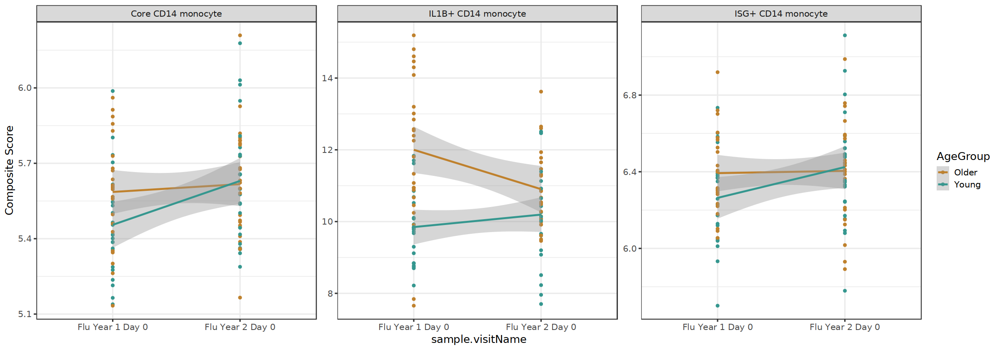

In [849]:
options(repr.plot.width = 20, repr.plot.height = 7)

# ggplot(filtered_data , 
#        aes(sample.daysSinceFirstVisit, composite_score_sum_mean,color=AgeGroup)) +
#   geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
#   geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')

# ggplot(filtered_data , 
#        aes(sample.visitName, composite_score_sum_mean,color=AgeGroup)) +
#   geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
#   geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')

# STAT_res_flu<-filtered_data %>%
#   arrange(subject.subjectGuid) %>%
#   select( celltype, sample.visitName, composite_score_sum_mean, AgeGroup ) %>%
#   group_by(celltype) %>% 
# wilcox_test(as.formula("composite_score_sum_mean ~ sample.visitName"), paired = TRUE) %>%
#   #wilcox_test(composite_score_sum_mean ~ AgeGroup) %>%
#   adjust_pvalue(method='BH') %>%
#   add_significance() %>%
#   add_xy_position(x = "celltype", fun = "max")
# STAT_res

# max_y<-filtered_data %>%
#   select(composite_score_sum_mean,sample.visitName, celltype) %>%
#   group_by(celltype) %>%
#   dplyr::summarize(max_composite_score_sum_mean = max(composite_score_sum_mean)) %>%
#   ungroup()%>%select(max_composite_score_sum_mean) %>% pull()

# STAT_res_flu$max_y<-max_y*1.05

# max_y <- max(filtered_data$composite_score_sum_mean, na.rm = TRUE)
# buffer <- 0.2 

ggplot(filtered_data, 
       aes(x = sample.visitName, y = composite_score_sum_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm", aes(group = AgeGroup)) +
  theme_bw(base_size = 15) +
  facet_wrap(~celltype, ncol = 4, scales = 'free')#+ 
  #stat_pvalue_manual(STAT_res_flu, label = "p.adj", tip.length=0, y.position = (max_y + buffer), label.size = 5)


`geom_smooth()` using formula = 'y ~ x'


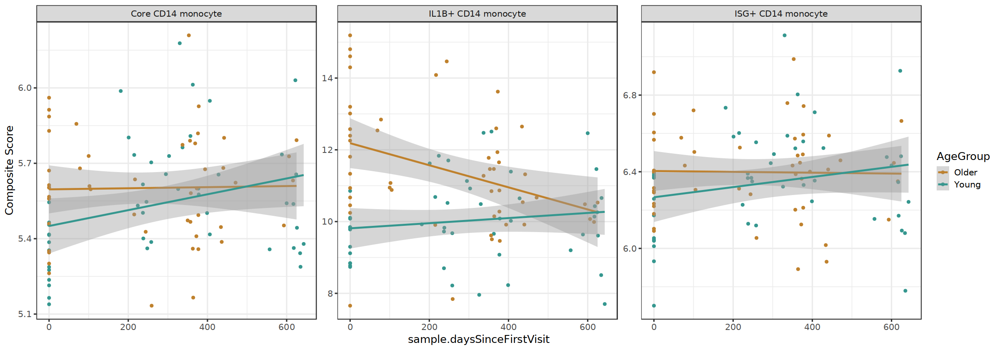

In [850]:
options(repr.plot.width = 20, repr.plot.height = 7)

ggplot(filtered_data, 
       aes(sample.daysSinceFirstVisit, composite_score_sum_mean,color=AgeGroup)) +
  geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')


In [513]:
# # Create the base plot with modified theme settings
# filtered_data <- filtered_data %>% filter(celltype %in% c("IL1B+ CD14 monocyte", "Core CD14 monocyte", "ISG+ CD14 monocyte"))

# p1 <- ggplot(filtered_data, aes(x = sample.visitName, y = composite_score_sum_mean)) + 
#   geom_boxplot(aes(fill = sample.visitName), alpha = .2, ) +  # Faint gray and dotted line color
#   geom_line(aes(group = subject.subjectGuid), color = "black", linetype = "dotted") + 
#   geom_point(size = 2) + 
#   facet_wrap(~ celltype, scales = "free", drop= FALSE) +
#   theme(
#     text = element_text(size = 40, color= "black"),  # Increase font size for all text elements
#     axis.title = element_text(size = 40),  # Increase font size for axis titles
#     legend.title = element_text(size = 50),  # Increase font size for legend title
#     legend.text = element_text(size = 50)  # Increase font size for legend text
#   ) + labs(y = "Composite score")

# # Add p-values to the plot
# options(repr.plot.width = 50, repr.plot.height = 50)
# p1 + geom_text(data = STAT_res, aes(label = paste("p.adj =", p.adj.signif, ", p_value=", p)),  
#               x = 1, y = Inf, hjust = 0.1, vjust = 1, size = 8, color = "black") #+ ggtitle("BR1- Whole PBMC (Percentage)") + theme(plot.title = element_text(size = 35, hjust = 0.5, face = "bold"))  # Centered and larger p-value text



### Stat_test and legend max scaling- Sum_Scaled_Mean

In [851]:
# Check unique combinations of AIFI_L3 and sample.visitName
composite_score_df_all %>%
  group_by(celltype, sample.visitName) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.


celltype,sample.visitName,n
<fct>,<chr>,<int>
Core CD14 monocyte,Flu Year 1 Day 0,51
Core CD14 monocyte,Flu Year 2 Day 0,49
IL1B+ CD14 monocyte,Flu Year 1 Day 0,51
IL1B+ CD14 monocyte,Flu Year 2 Day 0,49
ISG+ CD14 monocyte,Flu Year 1 Day 0,51
ISG+ CD14 monocyte,Flu Year 2 Day 0,49


In [852]:
filtered_data <- composite_score_df_all %>%
  group_by(celltype,subject.subjectGuid) %>%
  filter(all(c("Flu Year 1 Day 0", "Flu Year 2 Day 0") %in% sample.visitName))
head(filtered_data)

pbmc_sample_id,composite_score_sum_mean,composite_score_sum_scaled_mean,X,Unnamed..0,lastUpdated,sample.id,sample.bridgingControl,sample.sampleKitGuid,sample.visitName,⋯,cohort.cohortGuid,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages,celltype,AgeGroup
<chr>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<fct>,<chr>
PB00003-01,5.353938,-5.461612,2,3,2024-05-10T17:12:44.959Z,2db6fb3f-e3f4-454b-891b-9b068541b51d,False,KT00003,Flu Year 1 Day 0,⋯,BR1,NA,440,461,no,BR1003,Negative,30,Core CD14 monocyte,Young
PB00006-01,5.139054,-6.258017,4,5,2024-05-10T17:12:44.959Z,eb5b3a3d-002e-40a6-aa19-aa0e6a7fff8f,False,KT00006,Flu Year 1 Day 0,⋯,BR1,NA,451,492,no,BR1005,Negative,27,Core CD14 monocyte,Young
PB00012-01,5.416879,-2.209978,10,11,2024-05-10T17:12:44.959Z,fb3c3406-2797-4c31-b085-37d8138099a3,False,KT00012,Flu Year 1 Day 0,⋯,BR1,NA,469,494,no,BR1008,Positive,34,Core CD14 monocyte,Young
PB00016-01,5.566864,1.885198,14,15,2024-05-10T17:12:44.959Z,19e5fa0e-52a8-4bef-a19a-075ad37fd5e3,False,KT00016,Flu Year 1 Day 0,⋯,BR2,NA,520,536,no,BR2002,Positive,57,Core CD14 monocyte,Older
PB00022-01,5.454997,-2.197886,20,21,2024-05-10T17:12:44.959Z,dedcaa14-0aa3-403b-9e13-475e715f0d69,False,KT00022,Flu Year 1 Day 0,⋯,BR1,NA,491,519,no,BR1010,Positive,29,Core CD14 monocyte,Young
PB00023-05,5.275676,-4.419439,21,22,2024-05-10T17:12:44.959Z,70146ae1-7568-4d58-9744-ae42cdf3af5a,False,KT00023,Flu Year 1 Day 0,⋯,BR1,NA,502,524,no,BR1009,Negative,26,Core CD14 monocyte,Young


In [853]:
# Check unique combinations of AIFI_L3 and sample.visitName
filtered_data %>%
  group_by(celltype, sample.visitName) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.


celltype,sample.visitName,n
<fct>,<chr>,<int>
Core CD14 monocyte,Flu Year 1 Day 0,49
Core CD14 monocyte,Flu Year 2 Day 0,49
IL1B+ CD14 monocyte,Flu Year 1 Day 0,49
IL1B+ CD14 monocyte,Flu Year 2 Day 0,49
ISG+ CD14 monocyte,Flu Year 1 Day 0,49
ISG+ CD14 monocyte,Flu Year 2 Day 0,49


In [854]:
# colnames(filtered_data)
# filtered_data%>% select(subject.subjectGuid,cohort.cohortGuid,pbmc_sample_id,sample.visitName, AIFI_L3, AIFI_L3_clr) %>% group_by(sample.visitName, AIFI_L3)

In [857]:
STAT_res<-filtered_data %>%
  arrange(subject.subjectGuid) %>%
  select( celltype, sample.visitName, composite_score_sum_scaled_mean, AgeGroup ) %>%
  group_by(celltype) %>% 
#wilcox_test(as.formula("AIFI_L3_clr ~ sample.visitName"), paired = TRUE) %>%
  wilcox_test(composite_score_sum_scaled_mean ~ AgeGroup) %>%
  adjust_pvalue(method='BH') %>%
  add_significance() #%>%
  #add_xy_position(x = "celltype", fun = "max")
STAT_res

Adding missing grouping variables: `subject.subjectGuid`


celltype,.y.,group1,group2,n1,n2,statistic,p,p.adj,p.adj.signif
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>
Core CD14 monocyte,composite_score_sum_scaled_mean,Older,Young,50,48,1394,1.69e-01,2.400e-01,ns
IL1B+ CD14 monocyte,composite_score_sum_scaled_mean,Older,Young,50,48,1823,9.69e-06,2.907e-05,****
ISG+ CD14 monocyte,composite_score_sum_scaled_mean,Older,Young,50,48,1366,2.40e-01,2.400e-01,ns


In [858]:
STAT_res$p.adj <- formatC(STAT_res$p.adj, format = "e", digits = 2)

In [859]:
max_y<-filtered_data %>%
  select(composite_score_sum_scaled_mean,sample.visitName, celltype) %>%
  group_by(celltype) %>%
  dplyr::summarize(max_composite_score_sum_scaled_mean = max(composite_score_sum_scaled_mean)) %>%
  ungroup()%>%select(max_composite_score_sum_scaled_mean) %>% pull()

Adding missing grouping variables: `subject.subjectGuid`


In [860]:
STAT_res$max_y<-max_y*1.05

Warning message in max(lengths(data)):
“no non-missing arguments to max; returning -Inf”
`geom_smooth()` using formula = 'y ~ x'


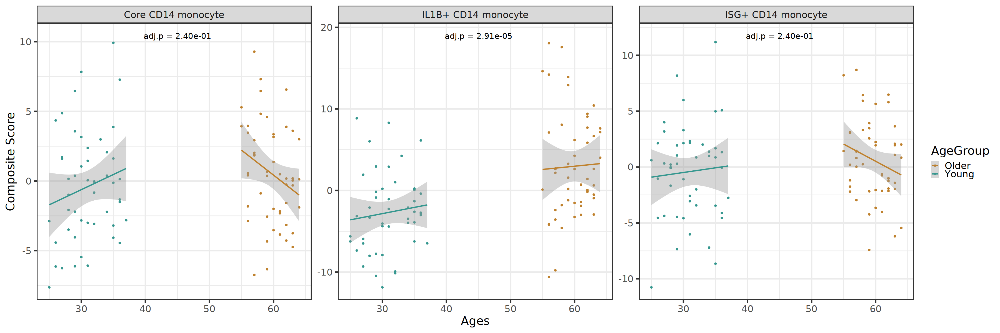

In [861]:
options(repr.plot.width = 30, repr.plot.height = 10)

p <- ggplot(filtered_data,
       aes(Ages, composite_score_sum_scaled_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype,ncol=4,scale = 'free')+
  expand_limits() 

#Manually add p-value annotations
p <- p + geom_text(data = STAT_res,
                   aes(x = 45, y = max_y, label = paste("adj.p =", p.adj)),
                   size = 6,
                   inherit.aes = FALSE)

p



`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.
`geom_smooth()` using formula = 'y ~ x'


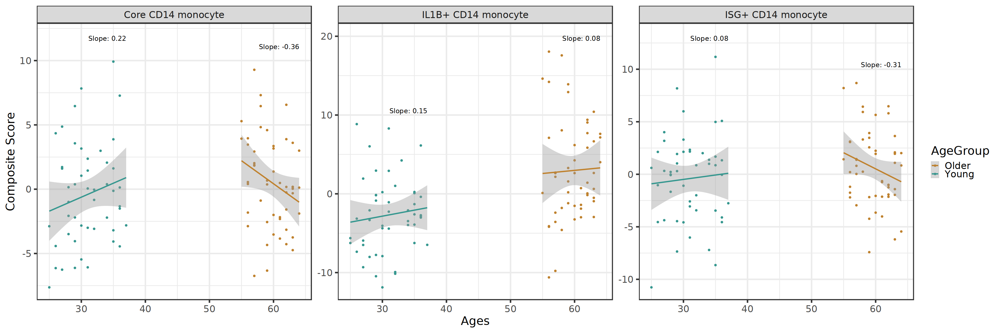

In [862]:

options(repr.plot.width = 30, repr.plot.height = 10)


p <- ggplot(filtered_data,
       aes(Ages, composite_score_sum_scaled_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype, scale = 'free')

slopes <- filtered_data %>%
  group_by(celltype, AgeGroup) %>%
  do(model = lm(composite_score_sum_scaled_mean ~ Ages, data = .)) %>%
  summarize(celltype = first(celltype),
            AgeGroup = first(AgeGroup),
            slope = coef(model)[["Ages"]],
            intercept = coef(model)[["(Intercept)"]])

max_values <- filtered_data %>%
  group_by(celltype, AgeGroup) %>%
  summarize(max_x = max(Ages), max_y = max(composite_score_sum_scaled_mean)+2)

annotations <- slopes %>%
  inner_join(max_values, by = c("celltype", "AgeGroup")) %>%
  mutate(label = paste("Slope:", round(slope, 2)))

p + geom_text(data = annotations, aes(x = max_x, y = max_y, label = label), 
              hjust = 1, vjust = 1, size = 5, color = "black", inherit.aes = FALSE)

`geom_smooth()` using formula = 'y ~ x'


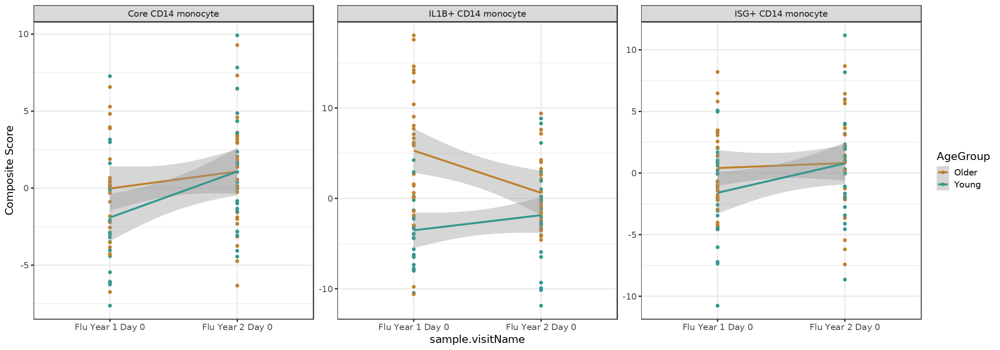

In [864]:
options(repr.plot.width = 20, repr.plot.height = 7)

# ggplot(filtered_data , 
#        aes(sample.daysSinceFirstVisit, composite_score_sum_mean,color=AgeGroup)) +
#   geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
#   geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')

# ggplot(filtered_data , 
#        aes(sample.visitName, composite_score_sum_mean,color=AgeGroup)) +
#   geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
#   geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')

library(ggplot2)

ggplot(filtered_data, 
       aes(x = sample.visitName, y = composite_score_sum_scaled_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm", aes(group = AgeGroup)) +
  theme_bw(base_size = 15) +
  facet_wrap(~celltype, ncol = 4, scales = 'free') 


`geom_smooth()` using formula = 'y ~ x'


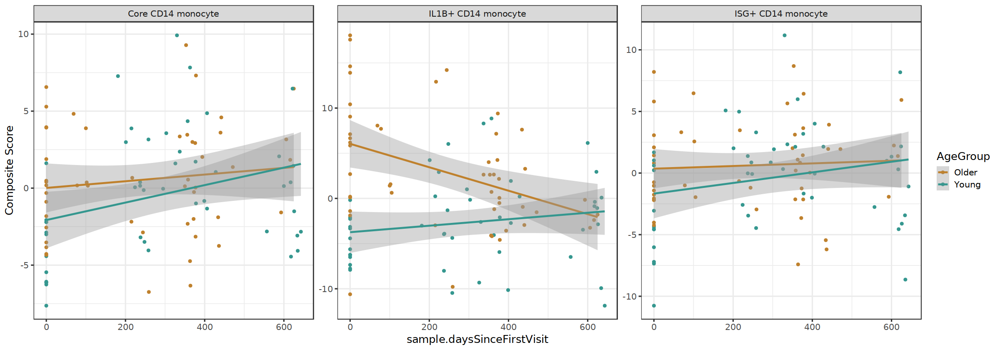

In [865]:
options(repr.plot.width = 20, repr.plot.height = 7)

ggplot(filtered_data, 
       aes(sample.daysSinceFirstVisit, composite_score_sum_scaled_mean,color=AgeGroup)) +
  geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')


## Read Deseq2 Result - Male

In [866]:
meta_data_subset <- meta_data %>% 
  filter(Covid_exclusion == 'no', sample.visitName	%in% c('Flu Year 1 Day 0','Flu Year 2 Day 0'), subject.biologicalSex == "Male")


In [867]:
file_list<-paste0("/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/scRNA/BRI/Average_LogNormalized_Expression/Average_LogNormalized_Expression_of_Celltypes_by_Sample_AIFI_L3/", meta_data_subset$pbmc_sample_id, ".csv")

In [868]:
df_list<-read_pesudobulk_expression(file_list, mc_cores = 60) #. reating pseudobulk object

[1] "Total reading time: 19.5180000000109 seconds"


In [869]:
unique(meta_data_subset$sample.visitName)
unique(meta_data_subset$subject.biologicalSex)

[1] "Flu Year 1 Day 0" "Flu Year 2 Day 0"

[1] "Male"

In [870]:
deseq2_result_Y1D0<-read.csv('/home/jupyter/IH-A-Aging-Analysis-Notebooks_old/Mansi_Notebooks/scRNA/CertPro_analysis/scripts/DESEQ2/Male_Deseq2_Result_Y1D0.csv')

In [871]:
head(deseq2_result_Y1D0)

,X,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj,contrast,Direction,gene,celltype,sex
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
1,1,0.4321027,-0.33851016,0.6221762,-0.5440744,0.5863902,0.9967281,cohort.cohortGuid,BR1,AL669831.5,ASDC,Male
2,2,2.1306270,-0.21090779,0.3400806,-0.6201701,0.5351458,0.9967281,cohort.cohortGuid,BR1,NOC2L,ASDC,Male
3,3,1.1454997,-0.39546356,0.5239595,-0.7547598,0.4503931,0.9967281,cohort.cohortGuid,BR1,ISG15,ASDC,Male
4,4,2.8187800,0.08086743,0.2866310,0.2821308,0.7778433,0.9967281,cohort.cohortGuid,BR2,SDF4,ASDC,Male
5,5,0.6591821,-0.77420752,0.5535811,-1.3985439,0.1619498,0.9967281,cohort.cohortGuid,BR1,B3GALT6,ASDC,Male
6,6,1.9946145,-0.09223559,0.3068931,-0.3005463,0.7637605,0.9967281,cohort.cohortGuid,BR1,UBE2J2,ASDC,Male


In [872]:
genes_of_interest <- c('G0S2', 'NR4A1', 'PTGS2', 'BCL2A1', 'METRNL' ,'RASGEF1B', 'NLRP3', 'RIPK2', 'RABL6', 'CMTM6', 'SGK1', 'SELENOK', 'MIDN', 'OAZ1')
length(genes_of_interest)

[1] 14

In [873]:
# filter significant genes 
# deseq2_result_Y1D0_AgeGroup_sig<-deseq2_result_Y1D0 %>% 
#   filter(contrast == "cohort.cohortGuid") %>%
#   filter(padj < 0.1, 
#          abs(log2FoldChange) > 0.1)

deseq2_result_Y1D0_AgeGroup_sig<-deseq2_result_Y1D0 %>% 
  filter(contrast == "cohort.cohortGuid") %>%
  filter(gene %in% genes_of_interest )

In [874]:
head(deseq2_result_Y1D0_AgeGroup_sig)

,X,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj,contrast,Direction,gene,celltype,sex
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
1,768,0.3401664,0.28683588,0.6303897,0.4550136,0.6490994,0.9967281,cohort.cohortGuid,BR2,NLRP3,ASDC,Male
2,1342,7.6007241,0.02633244,0.1852038,0.1421808,0.8869372,0.9967281,cohort.cohortGuid,BR2,CMTM6,ASDC,Male
3,1458,4.5524118,-0.05245916,0.2291303,-0.2289490,0.8189085,0.9967281,cohort.cohortGuid,BR1,SELENOK,ASDC,Male
4,1850,0.7012708,0.15017646,0.6198832,0.2422658,0.8085742,0.9967281,cohort.cohortGuid,BR2,RASGEF1B,ASDC,Male
5,3484,0.5193009,-0.23737959,0.5851101,-0.4057007,0.6849625,0.9967281,cohort.cohortGuid,BR1,RIPK2,ASDC,Male
6,3858,2.5937850,-0.23997714,0.3042653,-0.7887102,0.4302814,0.9967281,cohort.cohortGuid,BR1,RABL6,ASDC,Male


### Filter Genes and CellTypes

In [875]:
df_degs_counts<-as.data.frame(table(deseq2_result_Y1D0_AgeGroup_sig$celltype,deseq2_result_Y1D0_AgeGroup_sig$Direction))
head(df_degs_counts)

,Var1,Var2,Freq
,<fct>,<fct>,<int>
1,Activated memory B cell,BR1,4
2,Adaptive NK cell,BR1,2
3,ASDC,BR1,4
4,BaEoMaP cell,BR1,2
5,C1Q+ CD16 monocyte,BR1,6
6,CD14+ cDC2,BR1,6


In [876]:
celltypes <- c("IL1B+ CD14 monocyte", "Core CD14 monocyte", "ISG+ CD14 monocyte")

In [877]:
df_degs_counts_filtered<-df_degs_counts %>% arrange(Var1)  %>% filter(Var1 %in% celltypes)

In [878]:
df_degs_counts_filtered

Var1,Var2,Freq
<fct>,<fct>,<int>
Core CD14 monocyte,BR1,6
Core CD14 monocyte,BR2,4
IL1B+ CD14 monocyte,BR1,9
IL1B+ CD14 monocyte,BR2,5
ISG+ CD14 monocyte,BR1,6
ISG+ CD14 monocyte,BR2,4


### Construct Composite Score

In [879]:
score_df_list<-mclapply(unique(df_degs_counts_filtered$Var1),function(celltype_single){

top_n=100
Direction_of_DEG="BR2"
selected_genes <- deseq2_result_Y1D0_AgeGroup_sig %>%
    filter(celltype == celltype_single,Direction==Direction_of_DEG) %>% 
    arrange(padj,desc(abs(log2FoldChange))) %>% 
    slice_head(n=top_n)%>%
    select(gene) %>%
    pull()
 
long_format <- filter_genes_and_celltype(df_list, 
                                       selected_genes, 
                                       celltype_single, 
                                       longformat = TRUE)
long_format <- left_join(long_format, meta_data)
# z scored (optional)
long_format<-long_format %>% group_by(Gene) %>% 
mutate(Z_score_Mean_Expression=scale(Mean_Expression))  %>% 
                                        ungroup()
composite_score_df<-long_format%>% 
group_by(pbmc_sample_id) %>%
  dplyr::summarise(composite_score_sum_mean = sum(Mean_Expression),
                   composite_score_sum_scaled_mean = sum(Z_score_Mean_Expression)) %>% as.data.frame() 
composite_score_df<-left_join(composite_score_df,meta_data) 
composite_score_df$celltype<-celltype_single
return(composite_score_df)
},mc.cores=10)

In [880]:
composite_score_df_all<-do.call(rbind,score_df_list)

In [881]:
composite_score_df_all<-composite_score_df_all %>% mutate(AgeGroup=case_when(cohort.cohortGuid=="BR1"~"Young", TRUE~'Older'))

In [882]:
head(composite_score_df_all)
dim(composite_score_df_all)
colnames(composite_score_df_all)

,pbmc_sample_id,composite_score_sum_mean,composite_score_sum_scaled_mean,X,Unnamed..0,lastUpdated,sample.id,sample.bridgingControl,sample.sampleKitGuid,sample.visitName,⋯,cohort.cohortGuid,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages,celltype,AgeGroup
,<chr>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<fct>,<chr>
1,PB00002-01,4.286174,-3.3659872,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,KT00002,Flu Year 1 Day 0,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Core CD14 monocyte,Young
2,PB00004-01,4.361065,-2.3353055,3,4,2024-05-10T17:12:44.959Z,f04693c5-563c-4b5b-ae58-877d0d9ae2fe,False,KT00004,Flu Year 1 Day 0,⋯,BR1,NA,543,563,no,BR1004,Negative,30,Core CD14 monocyte,Young
3,PB00010-02,4.468580,-0.6390446,8,9,2024-05-10T17:12:44.959Z,f32ac061-0ede-4040-8d8c-35229ea5229c,False,KT00010,Flu Year 1 Day 0,⋯,BR1,NA,510,538,no,BR1006,Negative,31,Core CD14 monocyte,Young
4,PB00014-01,4.479466,0.2773810,12,13,2024-05-10T17:12:44.959Z,77c1dad3-605d-4f94-b163-8be9c62d3bc5,False,KT00014,Flu Year 1 Day 0,⋯,BR1,NA,468,493,no,BR1007,Positive,30,Core CD14 monocyte,Young
5,PB00015-01,4.285495,-2.9119411,13,14,2024-05-10T17:12:44.959Z,c9be600f-50b8-48cf-9d8a-b4d84b0eba6f,False,KT00015,Flu Year 1 Day 0,⋯,BR2,NA,517,537,no,BR2003,Negative,59,Core CD14 monocyte,Older
6,PB00025-04,4.220803,-4.4167847,23,24,2024-05-10T17:12:44.959Z,fc01c04c-7213-471f-8510-1785f9dee039,False,KT00025,Flu Year 1 Day 0,⋯,BR1,NA,431,452,no,BR1011,Negative,31,Core CD14 monocyte,Young


[1] 228  37

[1] "pbmc_sample_id"                           
 [2] "composite_score_sum_mean"                 
 [3] "composite_score_sum_scaled_mean"          
 [4] "X"                                        
 [5] "Unnamed..0"                               
 [6] "lastUpdated"                              
 [7] "sample.id"                                
 [8] "sample.bridgingControl"                   
 [9] "sample.sampleKitGuid"                     
[10] "sample.visitName"                         
[11] "sample.visitDetails"                      
[12] "sample.drawDate"                          
[13] "sample.daysSinceFirstVisit"               
[14] "file.id"                                  
[15] "file.name"                                
[16] "file.batchID"                             
[17] "file.panel"                               
[18] "file.pool"                                
[19] "file.fileType"                            
[20] "file.majorVersion"                        
[21] "subject.id"                               
[22] "subject.biologicalSex"                    
[23] "subject.birthYear"                        
[24] "subject.ethnicity"                        
[25] "subject.partnerCode"                      
[26] "subject.race"                             
[27] "subject.subjectGuid"                      
[28] "cohort.cohortGuid"                        
[29] "sample.diseaseStatesRecordedAtVisit"      
[30] "subject.covidVaxDose1.daysSinceFirstVisit"
[31] "subject.covidVaxDose2.daysSinceFirstVisit"
[32] "Covid_exclusion"                          
[33] "subjectGuid"                              
[34] "CMV"                                      
[35] "Ages"                                     
[36] "celltype"                                 
[37] "AgeGroup"

### Stat_test and legend max scaling- Sum_Mean

In [883]:
# Check unique combinations of AIFI_L3 and sample.visitName
composite_score_df_all %>%
  group_by(celltype, sample.visitName) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.


celltype,sample.visitName,n
<fct>,<chr>,<int>
Core CD14 monocyte,Flu Year 1 Day 0,41
Core CD14 monocyte,Flu Year 2 Day 0,35
IL1B+ CD14 monocyte,Flu Year 1 Day 0,41
IL1B+ CD14 monocyte,Flu Year 2 Day 0,35
ISG+ CD14 monocyte,Flu Year 1 Day 0,41
ISG+ CD14 monocyte,Flu Year 2 Day 0,35


In [884]:
filtered_data <- composite_score_df_all %>%
  group_by(celltype,subject.subjectGuid) %>%
  filter(all(c("Flu Year 1 Day 0", "Flu Year 2 Day 0") %in% sample.visitName))
head(filtered_data)

pbmc_sample_id,composite_score_sum_mean,composite_score_sum_scaled_mean,X,Unnamed..0,lastUpdated,sample.id,sample.bridgingControl,sample.sampleKitGuid,sample.visitName,⋯,cohort.cohortGuid,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages,celltype,AgeGroup
<chr>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<fct>,<chr>
PB00002-01,4.286174,-3.3659872,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,KT00002,Flu Year 1 Day 0,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Core CD14 monocyte,Young
PB00004-01,4.361065,-2.3353055,3,4,2024-05-10T17:12:44.959Z,f04693c5-563c-4b5b-ae58-877d0d9ae2fe,False,KT00004,Flu Year 1 Day 0,⋯,BR1,NA,543,563,no,BR1004,Negative,30,Core CD14 monocyte,Young
PB00010-02,4.468580,-0.6390446,8,9,2024-05-10T17:12:44.959Z,f32ac061-0ede-4040-8d8c-35229ea5229c,False,KT00010,Flu Year 1 Day 0,⋯,BR1,NA,510,538,no,BR1006,Negative,31,Core CD14 monocyte,Young
PB00014-01,4.479466,0.2773810,12,13,2024-05-10T17:12:44.959Z,77c1dad3-605d-4f94-b163-8be9c62d3bc5,False,KT00014,Flu Year 1 Day 0,⋯,BR1,NA,468,493,no,BR1007,Positive,30,Core CD14 monocyte,Young
PB00015-01,4.285495,-2.9119411,13,14,2024-05-10T17:12:44.959Z,c9be600f-50b8-48cf-9d8a-b4d84b0eba6f,False,KT00015,Flu Year 1 Day 0,⋯,BR2,NA,517,537,no,BR2003,Negative,59,Core CD14 monocyte,Older
PB00025-04,4.220803,-4.4167847,23,24,2024-05-10T17:12:44.959Z,fc01c04c-7213-471f-8510-1785f9dee039,False,KT00025,Flu Year 1 Day 0,⋯,BR1,NA,431,452,no,BR1011,Negative,31,Core CD14 monocyte,Young


In [885]:
# Check unique combinations of AIFI_L3 and sample.visitName
filtered_data %>%
  group_by(celltype, sample.visitName) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.


celltype,sample.visitName,n
<fct>,<chr>,<int>
Core CD14 monocyte,Flu Year 1 Day 0,35
Core CD14 monocyte,Flu Year 2 Day 0,35
IL1B+ CD14 monocyte,Flu Year 1 Day 0,35
IL1B+ CD14 monocyte,Flu Year 2 Day 0,35
ISG+ CD14 monocyte,Flu Year 1 Day 0,35
ISG+ CD14 monocyte,Flu Year 2 Day 0,35


In [886]:
# colnames(filtered_data)
# filtered_data%>% select(subject.subjectGuid,cohort.cohortGuid,pbmc_sample_id,sample.visitName, AIFI_L3, AIFI_L3_clr) %>% group_by(sample.visitName, AIFI_L3)

In [887]:
STAT_res<-filtered_data %>%
  arrange(subject.subjectGuid) %>%
  select( celltype, sample.visitName, composite_score_sum_mean, AgeGroup ) %>%
  group_by(celltype) %>% 
#wilcox_test(as.formula("AIFI_L3_clr ~ sample.visitName"), paired = TRUE) %>%
  wilcox_test(composite_score_sum_mean ~ AgeGroup) %>%
  adjust_pvalue(method='BH') %>%
  add_significance() #%>%
  #add_xy_position(x = "celltype", fun = "max")
STAT_res

Adding missing grouping variables: `subject.subjectGuid`


celltype,.y.,group1,group2,n1,n2,statistic,p,p.adj,p.adj.signif
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>
Core CD14 monocyte,composite_score_sum_mean,Older,Young,38,32,674,0.442,0.442,ns
IL1B+ CD14 monocyte,composite_score_sum_mean,Older,Young,38,32,726,0.167,0.342,ns
ISG+ CD14 monocyte,composite_score_sum_mean,Older,Young,38,32,711,0.228,0.342,ns


In [888]:
STAT_res$p.adj <- formatC(STAT_res$p.adj, format = "e", digits = 2)

In [889]:
max_y<-filtered_data %>%
  select(composite_score_sum_mean,sample.visitName, celltype) %>%
  group_by(celltype) %>%
  dplyr::summarize(max_composite_score_sum_mean = max(composite_score_sum_mean)) %>%
  ungroup()%>%select(max_composite_score_sum_mean) %>% pull()

Adding missing grouping variables: `subject.subjectGuid`


In [890]:
STAT_res$max_y<-max_y*1.05

Warning message in max(lengths(data)):
“no non-missing arguments to max; returning -Inf”
`geom_smooth()` using formula = 'y ~ x'


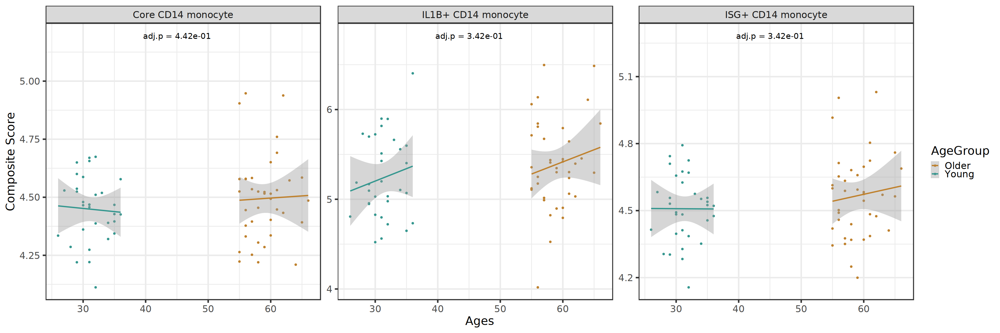

In [891]:
options(repr.plot.width = 30, repr.plot.height = 10)

p <- ggplot(filtered_data,
       aes(Ages, composite_score_sum_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype,ncol=4,scale = 'free')+
  expand_limits() 

#Manually add p-value annotations
p <- p + geom_text(data = STAT_res,
                   aes(x = 45, y = max_y, label = paste("adj.p =", p.adj)),
                   size = 6,
                   inherit.aes = FALSE)

p



`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.
`geom_smooth()` using formula = 'y ~ x'


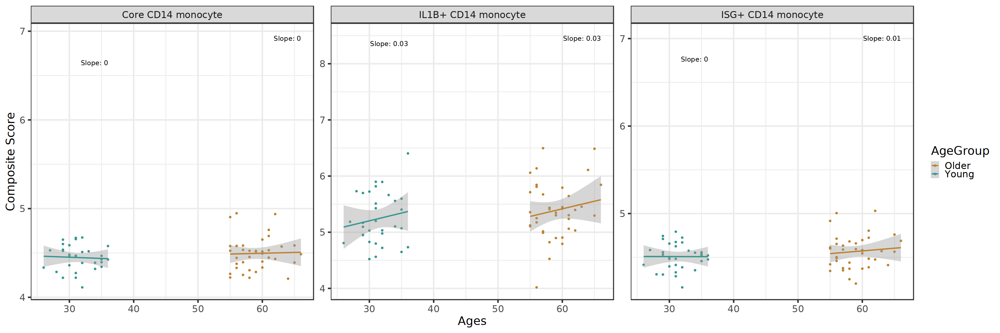

In [892]:

options(repr.plot.width = 30, repr.plot.height = 10)


p <- ggplot(filtered_data,
       aes(Ages, composite_score_sum_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype, scale = 'free')

slopes <- filtered_data %>%
  group_by(celltype, AgeGroup) %>%
  do(model = lm(composite_score_sum_mean ~ Ages, data = .)) %>%
  summarize(celltype = first(celltype),
            AgeGroup = first(AgeGroup),
            slope = coef(model)[["Ages"]],
            intercept = coef(model)[["(Intercept)"]])

max_values <- filtered_data %>%
  group_by(celltype, AgeGroup) %>%
  summarize(max_x = max(Ages), max_y = max(composite_score_sum_mean)+2)

annotations <- slopes %>%
  inner_join(max_values, by = c("celltype", "AgeGroup")) %>%
  mutate(label = paste("Slope:", round(slope, 2)))

p + geom_text(data = annotations, aes(x = max_x, y = max_y, label = label), 
              hjust = 1, vjust = 1, size = 5, color = "black", inherit.aes = FALSE)

`geom_smooth()` using formula = 'y ~ x'


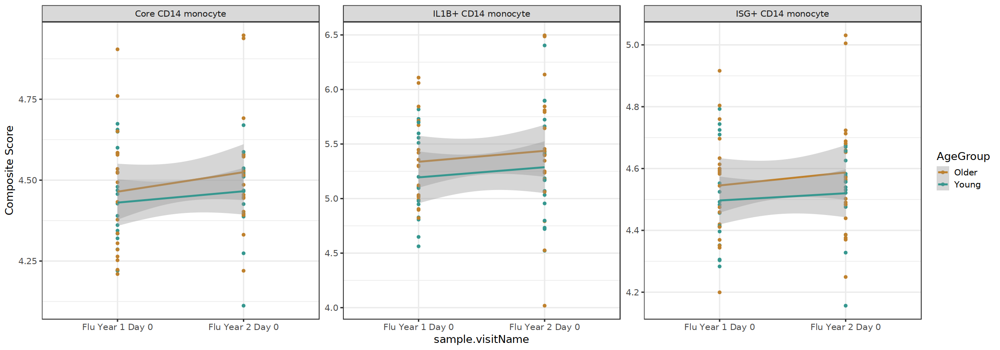

In [893]:
options(repr.plot.width = 20, repr.plot.height = 7)

# ggplot(filtered_data , 
#        aes(sample.daysSinceFirstVisit, composite_score_sum_mean,color=AgeGroup)) +
#   geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
#   geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')

# ggplot(filtered_data , 
#        aes(sample.visitName, composite_score_sum_mean,color=AgeGroup)) +
#   geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
#   geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')

library(ggplot2)

ggplot(filtered_data, 
       aes(x = sample.visitName, y = composite_score_sum_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm", aes(group = AgeGroup)) +
  theme_bw(base_size = 15) +
  facet_wrap(~celltype, ncol = 4, scales = 'free') 


`geom_smooth()` using formula = 'y ~ x'


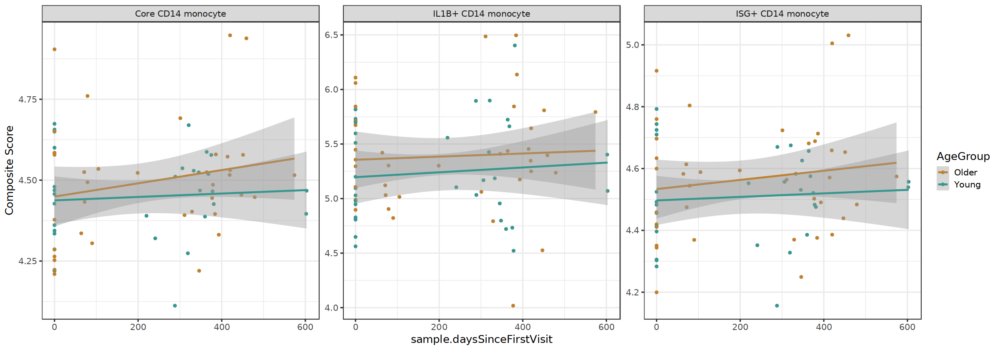

In [894]:
options(repr.plot.width = 20, repr.plot.height = 7)

ggplot(filtered_data, 
       aes(sample.daysSinceFirstVisit, composite_score_sum_mean,color=AgeGroup)) +
  geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')


In [768]:
unique(filtered_data$celltype)

[1] Core CD14 monocyte  IL1B+ CD14 monocyte ISG+ CD14 monocyte 
71 Levels: Activated memory B cell Adaptive NK cell ASDC ... Type 2 polarized memory B cell

In [769]:
# # Create the base plot with modified theme settings
# filtered_data <- filtered_data %>% filter(celltype %in% c("IL1B+ CD14 monocyte", "Core CD14 monocyte", "ISG+ CD14 monocyte"))

# p1 <- ggplot(filtered_data, aes(x = sample.visitName, y = composite_score_sum_mean)) + 
#   geom_boxplot(aes(fill = sample.visitName), alpha = .2, ) +  # Faint gray and dotted line color
#   geom_line(aes(group = subject.subjectGuid), color = "black", linetype = "dotted") + 
#   geom_point(size = 2) + 
#   facet_wrap(~ celltype, scales = "free", drop= FALSE) +
#   theme(
#     text = element_text(size = 40, color= "black"),  # Increase font size for all text elements
#     axis.title = element_text(size = 40),  # Increase font size for axis titles
#     legend.title = element_text(size = 50),  # Increase font size for legend title
#     legend.text = element_text(size = 50)  # Increase font size for legend text
#   ) + labs(y = "Composite score")

# # Add p-values to the plot
# options(repr.plot.width = 50, repr.plot.height = 50)
# p1 + geom_text(data = STAT_res, aes(label = paste("p.adj =", p.adj.signif, ", p_value=", p)),  
#               x = 1, y = Inf, hjust = 0.1, vjust = 1, size = 8, color = "black") #+ ggtitle("BR1- Whole PBMC (Percentage)") + theme(plot.title = element_text(size = 35, hjust = 0.5, face = "bold"))  # Centered and larger p-value text



### Stat_test and legend max scaling- Sum_Scaled_Mean

In [895]:
# Check unique combinations of AIFI_L3 and sample.visitName
composite_score_df_all %>%
  group_by(celltype, sample.visitName) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.


celltype,sample.visitName,n
<fct>,<chr>,<int>
Core CD14 monocyte,Flu Year 1 Day 0,41
Core CD14 monocyte,Flu Year 2 Day 0,35
IL1B+ CD14 monocyte,Flu Year 1 Day 0,41
IL1B+ CD14 monocyte,Flu Year 2 Day 0,35
ISG+ CD14 monocyte,Flu Year 1 Day 0,41
ISG+ CD14 monocyte,Flu Year 2 Day 0,35


In [896]:
filtered_data <- composite_score_df_all %>%
  group_by(celltype,subject.subjectGuid) %>%
  filter(all(c("Flu Year 1 Day 0", "Flu Year 2 Day 0") %in% sample.visitName))
head(filtered_data)

pbmc_sample_id,composite_score_sum_mean,composite_score_sum_scaled_mean,X,Unnamed..0,lastUpdated,sample.id,sample.bridgingControl,sample.sampleKitGuid,sample.visitName,⋯,cohort.cohortGuid,sample.diseaseStatesRecordedAtVisit,subject.covidVaxDose1.daysSinceFirstVisit,subject.covidVaxDose2.daysSinceFirstVisit,Covid_exclusion,subjectGuid,CMV,Ages,celltype,AgeGroup
<chr>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<lgl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<fct>,<chr>
PB00002-01,4.286174,-3.3659872,1,2,2024-05-10T17:12:44.959Z,750e90a9-a296-4f0f-969f-60225c2bca17,False,KT00002,Flu Year 1 Day 0,⋯,BR1,NA,440,461,no,BR1002,Negative,28,Core CD14 monocyte,Young
PB00004-01,4.361065,-2.3353055,3,4,2024-05-10T17:12:44.959Z,f04693c5-563c-4b5b-ae58-877d0d9ae2fe,False,KT00004,Flu Year 1 Day 0,⋯,BR1,NA,543,563,no,BR1004,Negative,30,Core CD14 monocyte,Young
PB00010-02,4.468580,-0.6390446,8,9,2024-05-10T17:12:44.959Z,f32ac061-0ede-4040-8d8c-35229ea5229c,False,KT00010,Flu Year 1 Day 0,⋯,BR1,NA,510,538,no,BR1006,Negative,31,Core CD14 monocyte,Young
PB00014-01,4.479466,0.2773810,12,13,2024-05-10T17:12:44.959Z,77c1dad3-605d-4f94-b163-8be9c62d3bc5,False,KT00014,Flu Year 1 Day 0,⋯,BR1,NA,468,493,no,BR1007,Positive,30,Core CD14 monocyte,Young
PB00015-01,4.285495,-2.9119411,13,14,2024-05-10T17:12:44.959Z,c9be600f-50b8-48cf-9d8a-b4d84b0eba6f,False,KT00015,Flu Year 1 Day 0,⋯,BR2,NA,517,537,no,BR2003,Negative,59,Core CD14 monocyte,Older
PB00025-04,4.220803,-4.4167847,23,24,2024-05-10T17:12:44.959Z,fc01c04c-7213-471f-8510-1785f9dee039,False,KT00025,Flu Year 1 Day 0,⋯,BR1,NA,431,452,no,BR1011,Negative,31,Core CD14 monocyte,Young


In [897]:
# Check unique combinations of AIFI_L3 and sample.visitName
filtered_data %>%
  group_by(celltype, sample.visitName) %>%
  dplyr::summarize(n = n())


`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.


celltype,sample.visitName,n
<fct>,<chr>,<int>
Core CD14 monocyte,Flu Year 1 Day 0,35
Core CD14 monocyte,Flu Year 2 Day 0,35
IL1B+ CD14 monocyte,Flu Year 1 Day 0,35
IL1B+ CD14 monocyte,Flu Year 2 Day 0,35
ISG+ CD14 monocyte,Flu Year 1 Day 0,35
ISG+ CD14 monocyte,Flu Year 2 Day 0,35


In [773]:
# colnames(filtered_data)
# filtered_data%>% select(subject.subjectGuid,cohort.cohortGuid,pbmc_sample_id,sample.visitName, AIFI_L3, AIFI_L3_clr) %>% group_by(sample.visitName, AIFI_L3)

In [898]:
STAT_res<-filtered_data %>%
  arrange(subject.subjectGuid) %>%
  select( celltype, sample.visitName, composite_score_sum_scaled_mean, AgeGroup ) %>%
  group_by(celltype) %>% 
#wilcox_test(as.formula("AIFI_L3_clr ~ sample.visitName"), paired = TRUE) %>%
  wilcox_test(composite_score_sum_scaled_mean ~ AgeGroup) %>%
  adjust_pvalue(method='BH') %>%
  add_significance() #%>%
  #add_xy_position(x = "celltype", fun = "max")
STAT_res

Adding missing grouping variables: `subject.subjectGuid`


celltype,.y.,group1,group2,n1,n2,statistic,p,p.adj,p.adj.signif
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>
Core CD14 monocyte,composite_score_sum_scaled_mean,Older,Young,38,32,671,0.464,0.4640,ns
IL1B+ CD14 monocyte,composite_score_sum_scaled_mean,Older,Young,38,32,698,0.293,0.4395,ns
ISG+ CD14 monocyte,composite_score_sum_scaled_mean,Older,Young,38,32,705,0.257,0.4395,ns


In [899]:
STAT_res$p.adj <- formatC(STAT_res$p.adj, format = "e", digits = 2)

In [900]:
max_y<-filtered_data %>%
  select(composite_score_sum_scaled_mean,sample.visitName, celltype) %>%
  group_by(celltype) %>%
  dplyr::summarize(max_composite_score_sum_scaled_mean = max(composite_score_sum_scaled_mean)) %>%
  ungroup()%>%select(max_composite_score_sum_scaled_mean) %>% pull()

Adding missing grouping variables: `subject.subjectGuid`


In [901]:
STAT_res$max_y<-max_y*1.05

Warning message in max(lengths(data)):
“no non-missing arguments to max; returning -Inf”
`geom_smooth()` using formula = 'y ~ x'


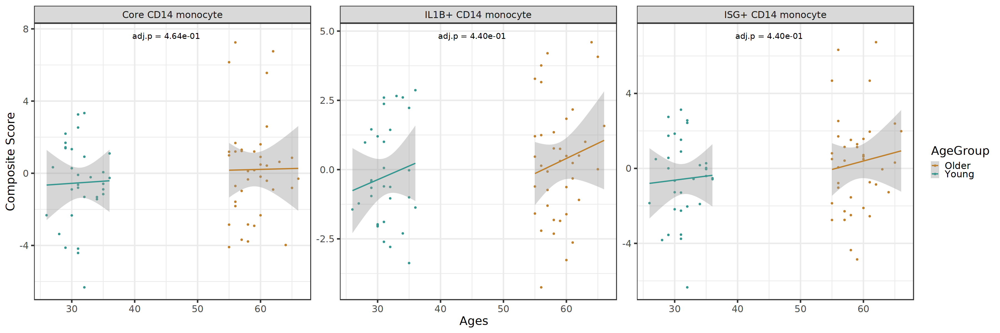

In [902]:
options(repr.plot.width = 30, repr.plot.height = 10)

p <- ggplot(filtered_data,
       aes(Ages, composite_score_sum_scaled_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype,ncol=4,scale = 'free')+
  expand_limits() 

#Manually add p-value annotations
p <- p + geom_text(data = STAT_res,
                   aes(x = 45, y = max_y, label = paste("adj.p =", p.adj)),
                   size = 6,
                   inherit.aes = FALSE)

p



`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.
`geom_smooth()` using formula = 'y ~ x'


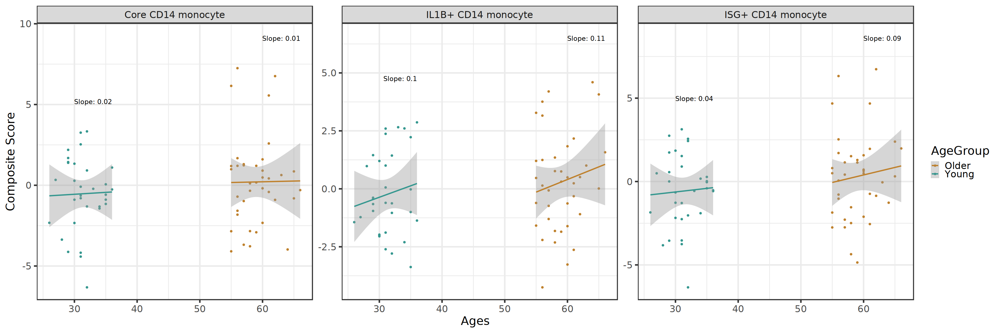

In [903]:

options(repr.plot.width = 30, repr.plot.height = 10)


p <- ggplot(filtered_data,
       aes(Ages, composite_score_sum_scaled_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm") +
  theme_bw(base_size = 25) +
  facet_wrap(~celltype, scale = 'free')

slopes <- filtered_data %>%
  group_by(celltype, AgeGroup) %>%
  do(model = lm(composite_score_sum_scaled_mean ~ Ages, data = .)) %>%
  summarize(celltype = first(celltype),
            AgeGroup = first(AgeGroup),
            slope = coef(model)[["Ages"]],
            intercept = coef(model)[["(Intercept)"]])

max_values <- filtered_data %>%
  group_by(celltype, AgeGroup) %>%
  summarize(max_x = max(Ages), max_y = max(composite_score_sum_scaled_mean)+2)

annotations <- slopes %>%
  inner_join(max_values, by = c("celltype", "AgeGroup")) %>%
  mutate(label = paste("Slope:", round(slope, 2)))

p + geom_text(data = annotations, aes(x = max_x, y = max_y, label = label), 
              hjust = 1, vjust = 1, size = 5, color = "black", inherit.aes = FALSE)

`geom_smooth()` using formula = 'y ~ x'


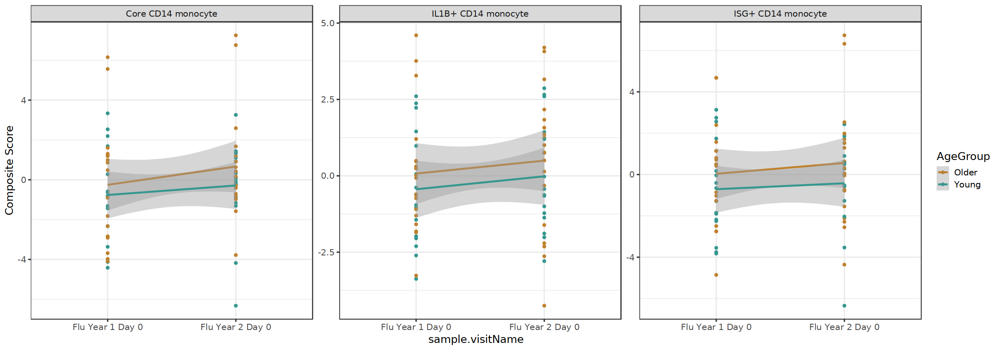

In [904]:
options(repr.plot.width = 20, repr.plot.height = 7)

# ggplot(filtered_data , 
#        aes(sample.daysSinceFirstVisit, composite_score_sum_mean,color=AgeGroup)) +
#   geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
#   geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')

# ggplot(filtered_data , 
#        aes(sample.visitName, composite_score_sum_mean,color=AgeGroup)) +
#   geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
#   geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')

library(ggplot2)

ggplot(filtered_data, 
       aes(x = sample.visitName, y = composite_score_sum_scaled_mean, color = AgeGroup)) +
  geom_point() +
  ylab('Composite Score') +
  scale_color_manual(values = c("Older" = '#bf812d', "Young" = '#35978f')) +
  geom_smooth(method = "lm", aes(group = AgeGroup)) +
  theme_bw(base_size = 15) +
  facet_wrap(~celltype, ncol = 4, scales = 'free') 


`geom_smooth()` using formula = 'y ~ x'


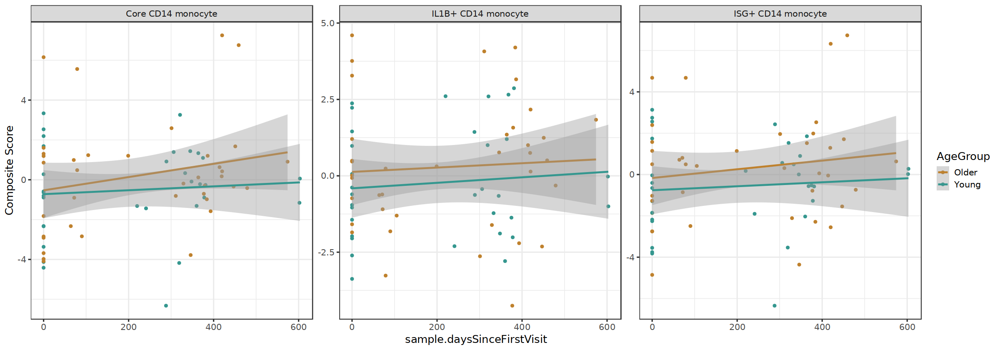

In [905]:
options(repr.plot.width = 20, repr.plot.height = 7)

ggplot(filtered_data, 
       aes(sample.daysSinceFirstVisit, composite_score_sum_scaled_mean,color=AgeGroup)) +
  geom_point()+ylab('Composite Score')+  scale_color_manual(values = c("Older"='#bf812d',  "Young"='#35978f')) +
  geom_smooth(method="lm")+theme_bw(base_size=15)+facet_wrap(~celltype,,ncol=4,scale='free')
